  #                                               ***Dataset Description***

The dataset was released by Aspiring Minds from the Aspiring Mind Employment Outcome 2015 (AMEO). The study is primarily limited  only to students with engineering disciplines. The dataset contains the employment outcomes of engineering graduates as dependent variables (Salary, Job Titles, and Job Locations) along with the standardized scores from three different areas – cognitive skills, technical skills and personality skills. The dataset also contains demographic features. The dataset  contains  around  40 independent variables and 4000 data points. The independent variables are both continuous and categorical in nature. The dataset contains a unique identifier for each candidate. Below mentioned table contains the details for the original dataset. 

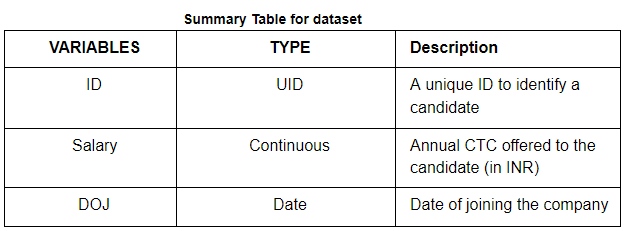

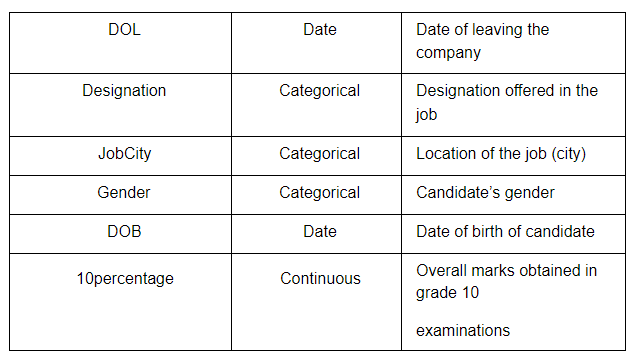

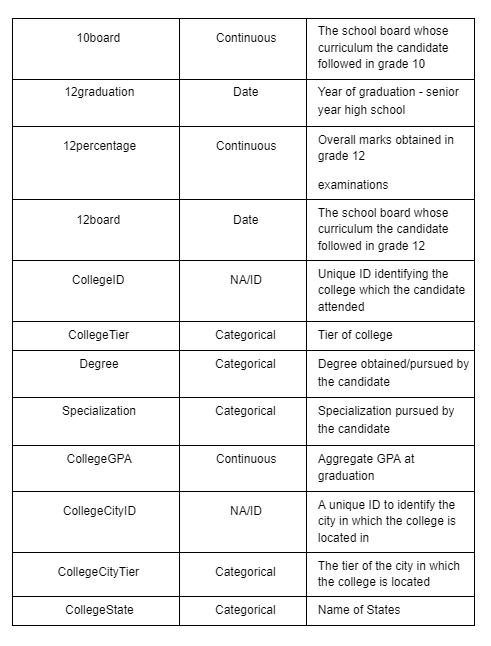

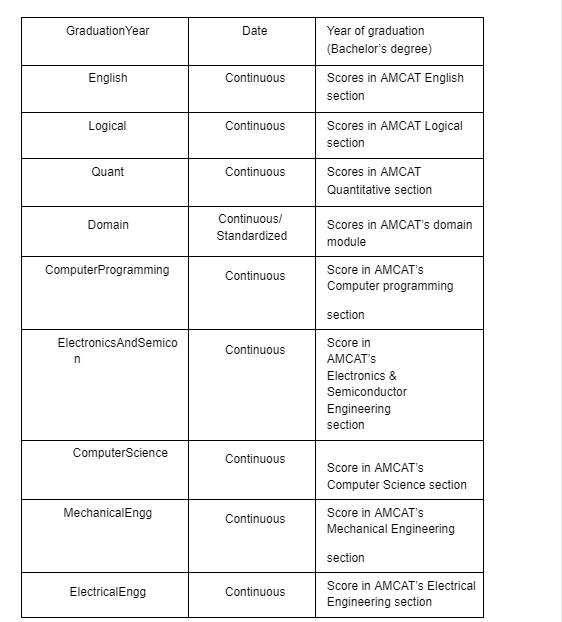

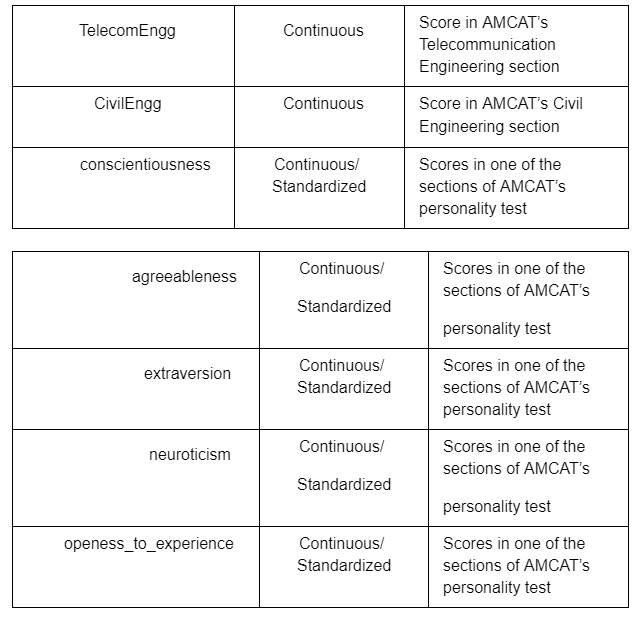

# Importing Necessary Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
pd.set_option('display.max_columns', None)
plt.style.use('fivethirtyeight')

In [184]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import seaborn as sns
import scipy as sp
from scipy import stats
from scipy.stats import kurtosis,skew
import matplotlib.pyplot as plt
import math
import random
import statistics as st
import statsmodels.api as sm
import pylab as py
from sklearn.preprocessing import StandardScaler
random.seed = 42

In [3]:
amcat_data = pd.read_excel('/content/aspiring_minds_employability_outcomes_2015.xlsx')
df = amcat_data.copy()
df.head()

,Unnamed: 0,ID,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10percentage,10board,12graduation,12percentage,12board,CollegeID,CollegeTier,Degree,Specialization,collegeGPA,CollegeCityID,CollegeCityTier,CollegeState,GraduationYear,English,Logical,Quant,Domain,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,train,203097,420000,2012-06-01,present,senior quality engineer,Bangalore,f,1990-02-19,84.3,"board ofsecondary education,ap",2007,95.8,"board of intermediate education,ap",1141,2,B.Tech/B.E.,computer engineering,78.00,1141,0,Andhra Pradesh,2011,515,585,525,0.635979,445,-1,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,train,579905,500000,2013-09-01,present,assistant manager,Indore,m,1989-10-04,85.4,cbse,2007,85.0,cbse,5807,2,B.Tech/B.E.,electronics and communication engineering,70.06,5807,0,Madhya Pradesh,2012,695,610,780,0.960603,-1,466,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,train,810601,325000,2014-06-01,present,systems engineer,Chennai,f,1992-08-03,85.0,cbse,2010,68.2,cbse,64,2,B.Tech/B.E.,information technology,70.00,64,0,Uttar Pradesh,2014,615,545,370,0.450877,395,-1,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,train,267447,1100000,2011-07-01,present,senior software engineer,Gurgaon,m,1989-12-05,85.6,cbse,2007,83.6,cbse,6920,1,B.Tech/B.E.,computer engineering,74.64,6920,1,Delhi,2011,635,585,625,0.974396,615,-1,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,train,343523,200000,2014-03-01,2015-03-01 00:00:00,get,Manesar,m,1991-02-27,78.0,cbse,2008,76.8,cbse,11368,2,B.Tech/B.E.,electronics and communication engineering,73.90,11368,0,Uttar Pradesh,2012,545,625,465,0.124502,-1,233,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


# Dropping Unnecesssary Columns

* Dropping the first two columns

In [4]:
df = df.drop(columns = ['Unnamed: 0', 'ID','CollegeID','CollegeCityID'])
df.head()

,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10percentage,10board,12graduation,12percentage,12board,CollegeTier,Degree,Specialization,collegeGPA,CollegeCityTier,CollegeState,GraduationYear,English,Logical,Quant,Domain,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,420000,2012-06-01,present,senior quality engineer,Bangalore,f,1990-02-19,84.3,"board ofsecondary education,ap",2007,95.8,"board of intermediate education,ap",2,B.Tech/B.E.,computer engineering,78.00,0,Andhra Pradesh,2011,515,585,525,0.635979,445,-1,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,500000,2013-09-01,present,assistant manager,Indore,m,1989-10-04,85.4,cbse,2007,85.0,cbse,2,B.Tech/B.E.,electronics and communication engineering,70.06,0,Madhya Pradesh,2012,695,610,780,0.960603,-1,466,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,325000,2014-06-01,present,systems engineer,Chennai,f,1992-08-03,85.0,cbse,2010,68.2,cbse,2,B.Tech/B.E.,information technology,70.00,0,Uttar Pradesh,2014,615,545,370,0.450877,395,-1,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,1100000,2011-07-01,present,senior software engineer,Gurgaon,m,1989-12-05,85.6,cbse,2007,83.6,cbse,1,B.Tech/B.E.,computer engineering,74.64,1,Delhi,2011,635,585,625,0.974396,615,-1,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,200000,2014-03-01,2015-03-01 00:00:00,get,Manesar,m,1991-02-27,78.0,cbse,2008,76.8,cbse,2,B.Tech/B.E.,electronics and communication engineering,73.90,0,Uttar Pradesh,2012,545,625,465,0.124502,-1,233,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


In [5]:
df.columns

Index(['Salary', 'DOJ', 'DOL', 'Designation', 'JobCity', 'Gender', 'DOB',
       '10percentage', '10board', '12graduation', '12percentage', '12board',
       'CollegeTier', 'Degree', 'Specialization', 'collegeGPA',
       'CollegeCityTier', 'CollegeState', 'GraduationYear', 'English',
       'Logical', 'Quant', 'Domain', 'ComputerProgramming',
       'ElectronicsAndSemicon', 'ComputerScience', 'MechanicalEngg',
       'ElectricalEngg', 'TelecomEngg', 'CivilEngg', 'conscientiousness',
       'agreeableness', 'extraversion', 'nueroticism',
       'openess_to_experience'],
      dtype='object')

* Converting all the column names to lower case

In [6]:
df.columns = df.columns.str.lower()

In [7]:
df.dtypes

salary                            int64
doj                      datetime64[ns]
dol                              object
designation                      object
jobcity                          object
gender                           object
dob                      datetime64[ns]
10percentage                    float64
10board                          object
12graduation                      int64
12percentage                    float64
12board                          object
collegetier                       int64
degree                           object
specialization                   object
collegegpa                      float64
collegecitytier                   int64
collegestate                     object
graduationyear                    int64
english                           int64
logical                           int64
quant                             int64
domain                          float64
computerprogramming               int64
electronicsandsemicon             int64


# Data type conversion

1. DOL - Date of Leaving. 
The survey was conducted back in 2015 and therefore making an assumption that the respondents who responded as **PRESENT** for DOL actually left the company within 2015 only. So, we will replace **PRESENT** value in DOL with 2015-12-31. Then we convert the datetype to datetime.

In [8]:
df['dol'].replace('present','2015-12-31', inplace = True)

In [9]:
df['dol'] = pd.to_datetime(df['dol'])

In [10]:
df.columns

Index(['salary', 'doj', 'dol', 'designation', 'jobcity', 'gender', 'dob',
       '10percentage', '10board', '12graduation', '12percentage', '12board',
       'collegetier', 'degree', 'specialization', 'collegegpa',
       'collegecitytier', 'collegestate', 'graduationyear', 'english',
       'logical', 'quant', 'domain', 'computerprogramming',
       'electronicsandsemicon', 'computerscience', 'mechanicalengg',
       'electricalengg', 'telecomengg', 'civilengg', 'conscientiousness',
       'agreeableness', 'extraversion', 'nueroticism',
       'openess_to_experience'],
      dtype='object')

designation, jobcity, gender, 10board,  12board, collegetier, degree, specialization, collegecitytier, collegestate

In [11]:
categorical = ['designation','jobcity', 'gender','10board','12board','collegetier','degree',
              'specialization','collegecitytier','collegestate']
for cat in categorical:
    df[cat] = df[cat].astype('category')

In [12]:
df.dtypes

salary                            int64
doj                      datetime64[ns]
dol                      datetime64[ns]
designation                    category
jobcity                        category
gender                         category
dob                      datetime64[ns]
10percentage                    float64
10board                        category
12graduation                      int64
12percentage                    float64
12board                        category
collegetier                    category
degree                         category
specialization                 category
collegegpa                      float64
collegecitytier                category
collegestate                   category
graduationyear                    int64
english                           int64
logical                           int64
quant                             int64
domain                          float64
computerprogramming               int64
electronicsandsemicon             int64


# Statistical Analysis

In [13]:
df.head()

,salary,doj,dol,designation,jobcity,gender,dob,10percentage,10board,12graduation,12percentage,12board,collegetier,degree,specialization,collegegpa,collegecitytier,collegestate,graduationyear,english,logical,quant,domain,computerprogramming,electronicsandsemicon,computerscience,mechanicalengg,electricalengg,telecomengg,civilengg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,420000,2012-06-01,2015-12-31,senior quality engineer,Bangalore,f,1990-02-19,84.3,"board ofsecondary education,ap",2007,95.8,"board of intermediate education,ap",2,B.Tech/B.E.,computer engineering,78.00,0,Andhra Pradesh,2011,515,585,525,0.635979,445,-1,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,500000,2013-09-01,2015-12-31,assistant manager,Indore,m,1989-10-04,85.4,cbse,2007,85.0,cbse,2,B.Tech/B.E.,electronics and communication engineering,70.06,0,Madhya Pradesh,2012,695,610,780,0.960603,-1,466,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,325000,2014-06-01,2015-12-31,systems engineer,Chennai,f,1992-08-03,85.0,cbse,2010,68.2,cbse,2,B.Tech/B.E.,information technology,70.00,0,Uttar Pradesh,2014,615,545,370,0.450877,395,-1,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,1100000,2011-07-01,2015-12-31,senior software engineer,Gurgaon,m,1989-12-05,85.6,cbse,2007,83.6,cbse,1,B.Tech/B.E.,computer engineering,74.64,1,Delhi,2011,635,585,625,0.974396,615,-1,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,200000,2014-03-01,2015-03-01,get,Manesar,m,1991-02-27,78.0,cbse,2008,76.8,cbse,2,B.Tech/B.E.,electronics and communication engineering,73.90,0,Uttar Pradesh,2012,545,625,465,0.124502,-1,233,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


In [14]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
salary,3998.0,307699.849925,212737.499957,35000.0000,180000.000000,300000.000000,370000.000000,4.000000e+06
10percentage,3998.0,77.925443,9.850162,43.0000,71.680000,79.150000,85.670000,9.776000e+01
12graduation,3998.0,2008.087544,1.653599,1995.0000,2007.000000,2008.000000,2009.000000,2.013000e+03
12percentage,3998.0,74.466366,10.999933,40.0000,66.000000,74.400000,82.600000,9.870000e+01
collegegpa,3998.0,71.486171,8.167338,6.4500,66.407500,71.720000,76.327500,9.993000e+01
graduationyear,3998.0,2012.105803,31.857271,0.0000,2012.000000,2013.000000,2014.000000,2.017000e+03
english,3998.0,501.649075,104.940021,180.0000,425.000000,500.000000,570.000000,8.750000e+02
logical,3998.0,501.598799,86.783297,195.0000,445.000000,505.000000,565.000000,7.950000e+02
quant,3998.0,513.378189,122.302332,120.0000,430.000000,515.000000,595.000000,9.000000e+02
domain,3998.0,0.510490,0.468671,-1.0000,0.342315,0.622643,0.842248,9.999104e-01


# Data Preprocessing

## Check DOL > DOJ

* DOL--Date Of Leaving

* DOJ--Date Of Joining

* Checking if the Date of leaving is actually greater than Date of joining.

In [15]:
dates = df[~(df['dol'] > df['doj'])].shape[0]
print(f'DOL is earlier than DOJ for {dates} observations.')

DOL is earlier than DOJ for 55 observations.


**OBSERVATION:** These observations might be typos and hence we will drop those 55 rows.

In [16]:
df = df.drop(df[~(df['dol'] > df['doj'])].index)

* Making the entries for gender column more descriptive.

In [17]:
df['gender'].replace({'f':'Female','m':'Male'}, inplace = True)

In [18]:
df.head()

,salary,doj,dol,designation,jobcity,gender,dob,10percentage,10board,12graduation,12percentage,12board,collegetier,degree,specialization,collegegpa,collegecitytier,collegestate,graduationyear,english,logical,quant,domain,computerprogramming,electronicsandsemicon,computerscience,mechanicalengg,electricalengg,telecomengg,civilengg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,420000,2012-06-01,2015-12-31,senior quality engineer,Bangalore,Female,1990-02-19,84.3,"board ofsecondary education,ap",2007,95.8,"board of intermediate education,ap",2,B.Tech/B.E.,computer engineering,78.00,0,Andhra Pradesh,2011,515,585,525,0.635979,445,-1,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,500000,2013-09-01,2015-12-31,assistant manager,Indore,Male,1989-10-04,85.4,cbse,2007,85.0,cbse,2,B.Tech/B.E.,electronics and communication engineering,70.06,0,Madhya Pradesh,2012,695,610,780,0.960603,-1,466,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,325000,2014-06-01,2015-12-31,systems engineer,Chennai,Female,1992-08-03,85.0,cbse,2010,68.2,cbse,2,B.Tech/B.E.,information technology,70.00,0,Uttar Pradesh,2014,615,545,370,0.450877,395,-1,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,1100000,2011-07-01,2015-12-31,senior software engineer,Gurgaon,Male,1989-12-05,85.6,cbse,2007,83.6,cbse,1,B.Tech/B.E.,computer engineering,74.64,1,Delhi,2011,635,585,625,0.974396,615,-1,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,200000,2014-03-01,2015-03-01,get,Manesar,Male,1991-02-27,78.0,cbse,2008,76.8,cbse,2,B.Tech/B.E.,electronics and communication engineering,73.90,0,Uttar Pradesh,2012,545,625,465,0.124502,-1,233,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


## Convert CGPA into Percentsalary

* Validating if the results are in percentsalarys and not in CGPA or otherwise.

In [19]:
print((df['10percentage'] <=10).sum())
print((df['12percentage'] <=10).sum())
print((df['collegegpa'] <=10).sum())

0
0
12


**OBSERVATION:** 10percentage and 12percentage are fine but collegegpa has 12 obvservations which need to be deal with.

In [20]:
df.loc[df['collegegpa']<=10,'collegegpa'].index
#(df.loc[df['collegegpa']<=10,'collegegpa']/10)*100

Int64Index([7, 138, 788, 1419, 1439, 1767, 2151, 2229, 2293, 2662, 2691, 3308], dtype='int64')

In [21]:
df.loc[df['collegegpa']<=10,'collegegpa'] = (df.loc[df['collegegpa']<=10,'collegegpa']/10)*100

## Check if there exist 0 or negative values in the Percentage Columns.

* Validating if there exist 0 or -1 in the data.

In [22]:
print((df==0).sum()[(df==0).sum() > 0])

10board             349
12board             358
collegecitytier    2761
graduationyear        1
dtype: int64


In [23]:
(df==-1).sum()[(df==-1).sum()>0]/len(df)*100

jobcity                  11.361907
domain                    6.137459
computerprogramming      21.836165
electronicsandsemicon    71.392341
computerscience          77.605884
mechanicalengg           94.040071
electricalengg           96.094344
telecomengg              90.565559
civilengg                98.934821
dtype: float64

**OBSERVATIONS:**

* According to the description of the columns:
1. 10board
2. 12board
3. graduationyear
4. jobcity
5. domain

**The above columns cannot have zeros or -1 as their inputs and hence they should be considered as null values and therefore imputed**

* The following columns describes subjects which are optional for the exam and that is why they have large number of -1(null values). Hence we will be dropping the columns out of analysis in which the percentage for -1 values is greater than or equal to 80% and for the rest of them, we will impute the values as zero.
1. electronicsandsemicon          
2. computerscience          
3. mechanicalengg           
4. electricalengg           
5. telecomengg   
6. civilengg                

In [24]:
df = df.drop(columns = ['mechanicalengg','electricalengg','telecomengg','civilengg'])

In [25]:
df['10board'] = df['10board'].replace({0:np.nan})
df['12board'] = df['12board'].replace({0:np.nan})
df['graduationyear'] = df['graduationyear'].replace({0:np.nan})
df['jobcity'] = df['jobcity'].replace({-1:np.nan})
df['domain'] = df['domain'].replace({-1:np.nan})
df['electronicsandsemicon'] = df['electronicsandsemicon'].replace({-1:0})
df['computerscience'] = df['computerscience'].replace({-1:0})
df['computerprogramming'] = df['computerprogramming'].replace({-1:np.nan})

* Imputing categorical columns with mode values for their respective columns.

In [26]:
df['10board'].fillna(df['10board'].mode()[0], inplace = True)
df['12board'].fillna(df['12board'].mode()[0], inplace = True)
df['graduationyear'].fillna(df['graduationyear'].mode()[0], inplace = True)
df['jobcity'].fillna(df['jobcity'].mode()[0], inplace = True)

# Missing Value Imputation 


Real-world data often has missing values. Data can have missing values for a number of reasons such as observations 
that were not recorded and data corruption. 

**Impact:** 

• Handling missing data is important as many machine learning algorithms do 
not support data with missing values. 

**Solution:** 

• Remove rows with missing data from your dataset. 

• Impute missing values with mean/median values in your dataset. 

**Note:**

• Use business knowledge to take separate approach for each variable 

• It is advisable to impute instead of remove in case of small sample size or 
large proportion of observations with missing values

## **Missing Value Imputation Methods**

1. **Impute with ZERO** 

     • Impute missing values with zero 

2. **Impute with Median/Mean/Mode**

     • For numerical variables, impute missing values with Mean or Median 

     • For categorical variables, impute missing values with Mode 

3. **Segment based imputation**

     • Identify relevant segments 

     • Calculate mean/median/mode of segments 

     • Impute the missing value according to the segments 

     • For example, we can say rainfall hardly varies for cities in a particular State 

     • In this case, we can impute missing rainfall value of a city with the average of that state 

* Imputing the numerical columns with median values for their respective columns.

In [27]:
df['domain'].fillna(df['domain'].median(), inplace = True)
df['computerprogramming'].fillna(df['computerprogramming'].median(), inplace = True)

In [28]:
df.head()

,salary,doj,dol,designation,jobcity,gender,dob,10percentage,10board,12graduation,12percentage,12board,collegetier,degree,specialization,collegegpa,collegecitytier,collegestate,graduationyear,english,logical,quant,domain,computerprogramming,electronicsandsemicon,computerscience,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,420000,2012-06-01,2015-12-31,senior quality engineer,Bangalore,Female,1990-02-19,84.3,"board ofsecondary education,ap",2007,95.8,"board of intermediate education,ap",2,B.Tech/B.E.,computer engineering,78.00,0,Andhra Pradesh,2011.0,515,585,525,0.635979,445.0,0,0,0.9737,0.8128,0.5269,1.35490,-0.4455
1,500000,2013-09-01,2015-12-31,assistant manager,Indore,Male,1989-10-04,85.4,cbse,2007,85.0,cbse,2,B.Tech/B.E.,electronics and communication engineering,70.06,0,Madhya Pradesh,2012.0,695,610,780,0.960603,455.0,466,0,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,325000,2014-06-01,2015-12-31,systems engineer,Chennai,Female,1992-08-03,85.0,cbse,2010,68.2,cbse,2,B.Tech/B.E.,information technology,70.00,0,Uttar Pradesh,2014.0,615,545,370,0.450877,395.0,0,0,0.2718,1.7109,0.1637,-0.86820,0.6721
3,1100000,2011-07-01,2015-12-31,senior software engineer,Gurgaon,Male,1989-12-05,85.6,cbse,2007,83.6,cbse,1,B.Tech/B.E.,computer engineering,74.64,1,Delhi,2011.0,635,585,625,0.974396,615.0,0,0,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,200000,2014-03-01,2015-03-01,get,Manesar,Male,1991-02-27,78.0,cbse,2008,76.8,cbse,2,B.Tech/B.E.,electronics and communication engineering,73.90,0,Uttar Pradesh,2012.0,545,625,465,0.124502,455.0,233,0,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


# Catageries Of Data

In [29]:
df.dtypes

salary                            int64
doj                      datetime64[ns]
dol                      datetime64[ns]
designation                    category
jobcity                          object
gender                           object
dob                      datetime64[ns]
10percentage                    float64
10board                          object
12graduation                      int64
12percentage                    float64
12board                          object
collegetier                    category
degree                         category
specialization                 category
collegegpa                      float64
collegecitytier                category
collegestate                   category
graduationyear                  float64
english                           int64
logical                           int64
quant                             int64
domain                          float64
computerprogramming             float64
electronicsandsemicon             int64


# Univariate Analysis

## designation 

### Count Plot

['senior quality engineer', 'assistant manager', 'systems engineer', 'senior software engineer', 'get', ..., 'test technician', 'it operations associate', 'software engineering associate', 'research scientist', 'jr. software developer']
Length: 416
Categories (416, object): ['senior quality engineer', 'assistant manager', 'systems engineer',
                           'senior software engineer', ..., 'it operations associate',
                           'software engineering associate', 'research scientist', 'jr. software developer']
	
****************************

software engineer            535
software developer           262
system engineer              202
programmer analyst           139
systems engineer             117
                            ... 
human resources intern         1
human resources associate      1
staffing recruiter             0
risk investigator              0
software devloper              0
Name: designation, Length: 419, dtype: int64



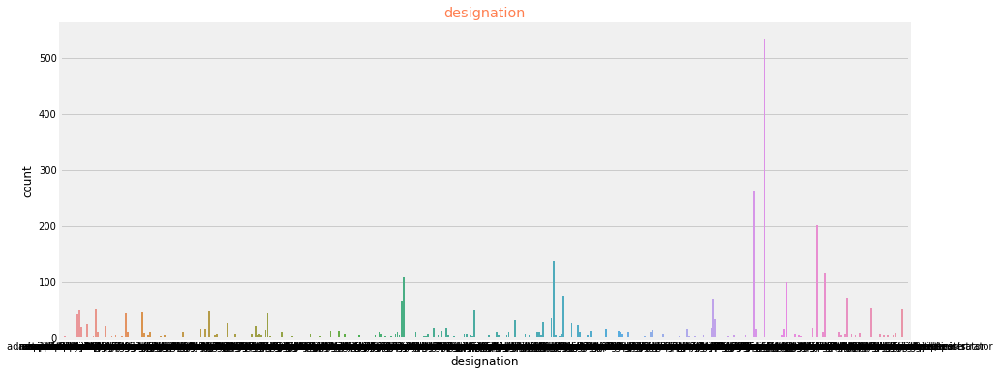

In [30]:
plt.figure(figsize = (14, 6))
sns.countplot(df['designation'])
plt.title('designation',color='coral')
print(df['designation'].unique())
print('\t')
print('****************************')
print()
print(df['designation'].value_counts())
print()

### Pie-Chart

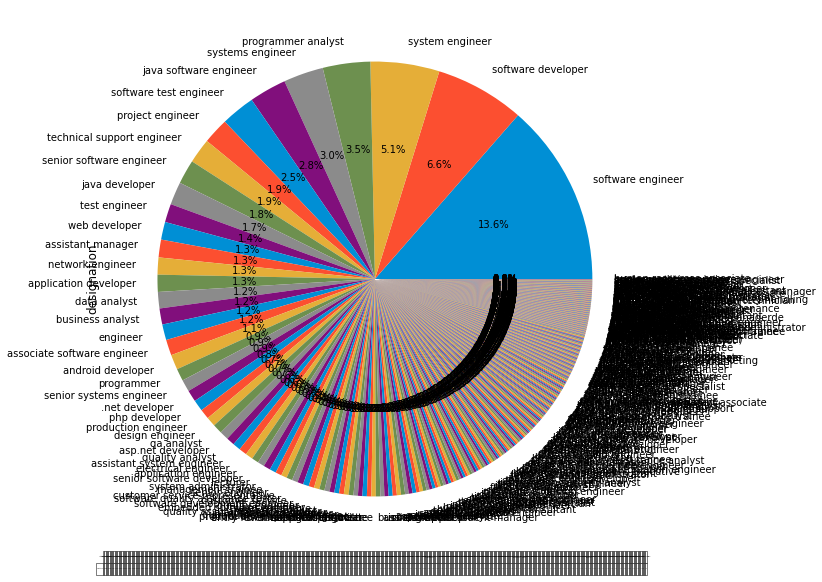

In [31]:
plt.figure(figsize=(10,10))
df.designation.value_counts().plot(kind='pie', autopct='%1.1f%%', table = True)
plt.show()

## collegetier

### Count Plot

[2, 1]
Categories (2, int64): [2, 1]
	
****************************

2    3648
1     295
Name: collegetier, dtype: int64



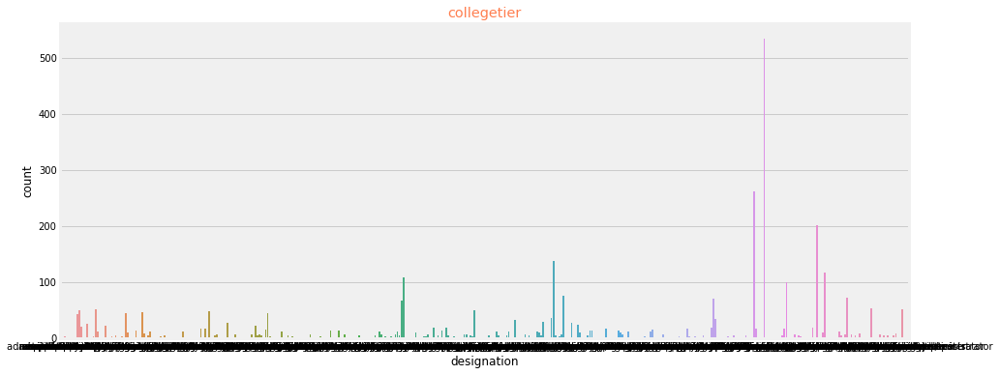

In [32]:
plt.figure(figsize = (14, 6))
sns.countplot(df['designation'])
plt.title('collegetier',color='coral')
print(df['collegetier'].unique())
print('\t')
print('****************************')
print()
print(df['collegetier'].value_counts())
print()

### Pie-Chart

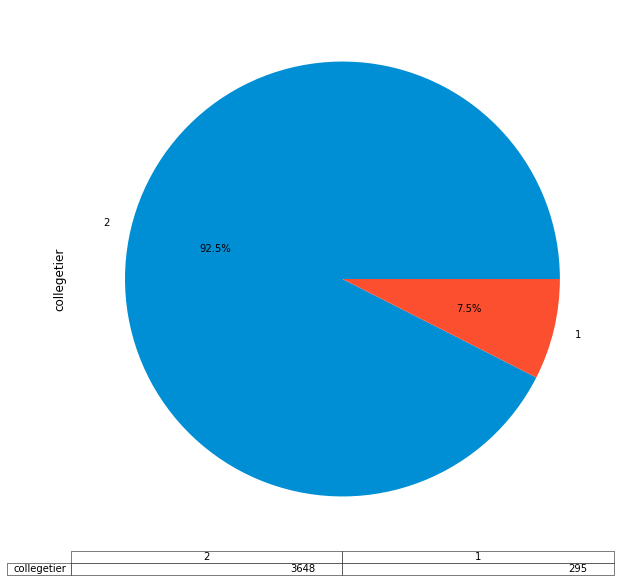

In [33]:
plt.figure(figsize=(10,10))
df.collegetier.value_counts().plot(kind='pie', autopct='%1.1f%%', table = True)
plt.show()

## Degree

### Count Plot

['B.Tech/B.E.', 'MCA', 'M.Tech./M.E.', 'M.Sc. (Tech.)']
Categories (4, object): ['B.Tech/B.E.', 'MCA', 'M.Tech./M.E.', 'M.Sc. (Tech.)']
	
****************************

B.Tech/B.E.      3648
MCA               240
M.Tech./M.E.       53
M.Sc. (Tech.)       2
Name: degree, dtype: int64



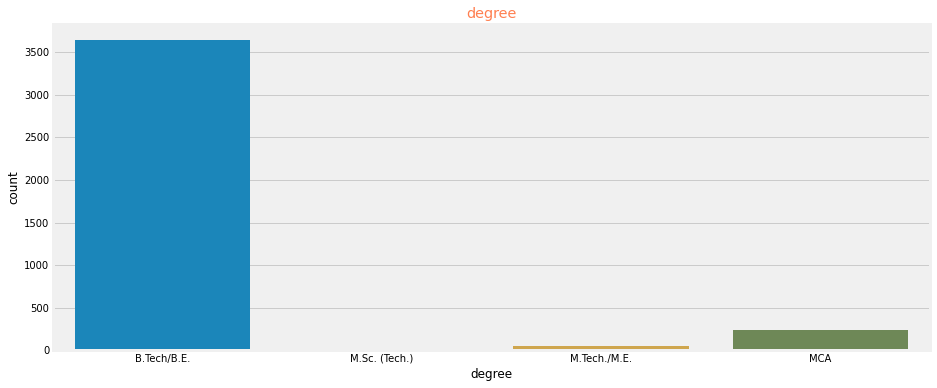

In [34]:
plt.figure(figsize = (14, 6))
sns.countplot(df['degree'])
plt.title('degree',color='coral')
print(df['degree'].unique())
print('\t')
print('****************************')
print()
print(df['degree'].value_counts())
print()

### Pie-Chart

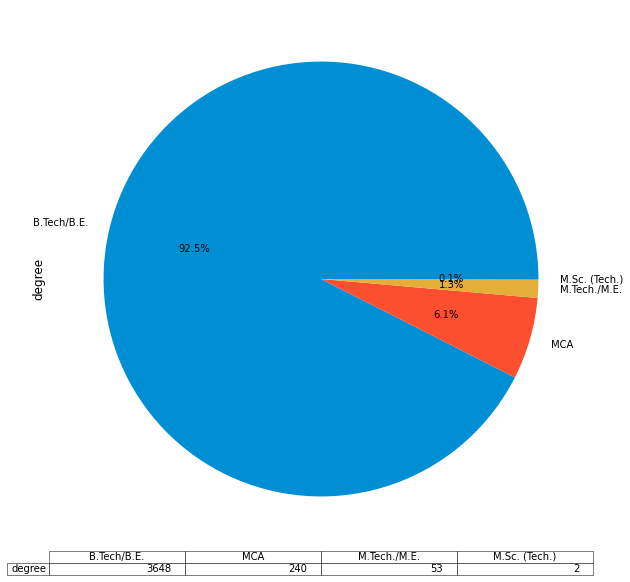

In [35]:
plt.figure(figsize=(10,10))
df.degree.value_counts().plot(kind='pie', autopct='%1.1f%%', table = True)
plt.show()

## Specialization

### Count Plot

['computer engineering', 'electronics and communication engineering', 'information technology', 'computer science & engineering', 'mechanical engineering', ..., 'internal combustion engine', 'computer networking', 'biomedical engineering', 'electronics', 'computer science']
Length: 46
Categories (46, object): ['computer engineering', 'electronics and communication engineering',
                          'information technology', 'computer science & engineering', ...,
                          'computer networking', 'biomedical engineering', 'electronics',
                          'computer science']

****************************

electronics and communication engineering      865
computer science & engineering                 731
information technology                         654
computer engineering                           593
computer application                           241
mechanical engineering                         201
electronics and electrical engineering         191
elec

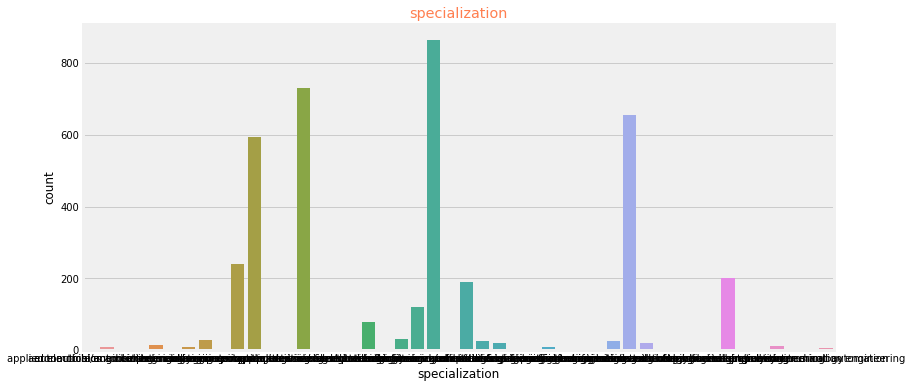

In [36]:
plt.figure(figsize = (12, 6))
sns.countplot(df['specialization'])
plt.title('specialization',color='coral')
print(df['specialization'].unique())
print()
print('****************************')
print()
print(df['specialization'].value_counts())
print()


### Pie-Chart

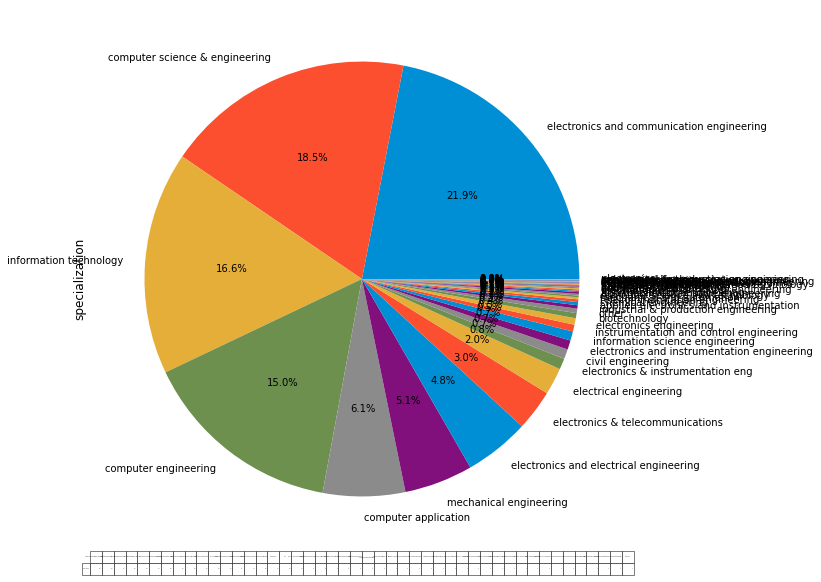

In [37]:
plt.figure(figsize=(10,10))
df.specialization.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

## Collegecitytier

### Count Plot

[0, 1]
Categories (2, int64): [0, 1]

****************************

0    2761
1    1182
Name: collegecitytier, dtype: int64



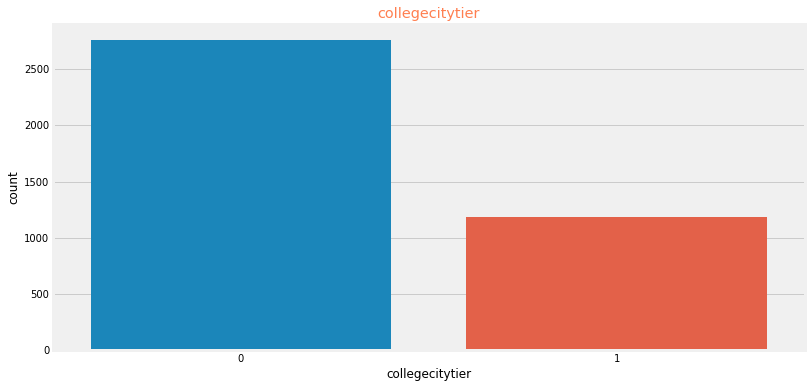

In [38]:
plt.figure(figsize = (12, 6))
sns.countplot(df['collegecitytier'])
plt.title('collegecitytier',color='coral')
print(df['collegecitytier'].unique())
print()
print('****************************')
print()
print(df['collegecitytier'].value_counts())
print()


### Pie-Chart

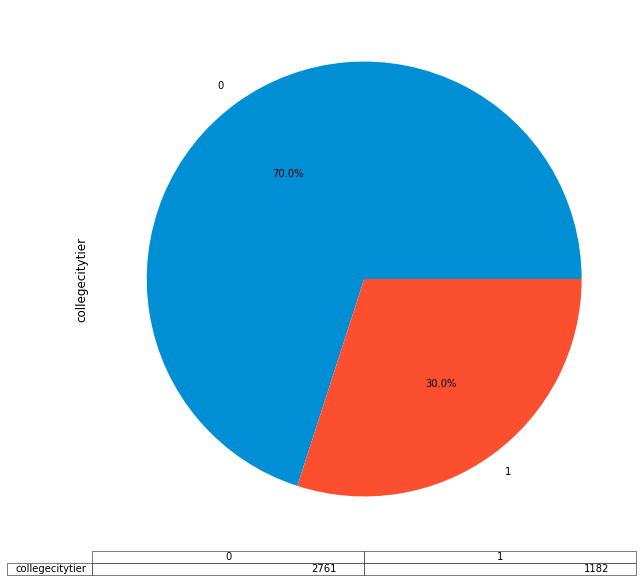

In [39]:
plt.figure(figsize=(10,10))
df.collegecitytier.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

## Collegestate

### Count Plot

['Andhra Pradesh', 'Madhya Pradesh', 'Uttar Pradesh', 'Delhi', 'Karnataka', ..., 'Assam', 'Goa', 'Sikkim', 'Union Territory', 'Meghalaya']
Length: 26
Categories (26, object): ['Andhra Pradesh', 'Madhya Pradesh', 'Uttar Pradesh', 'Delhi', ..., 'Goa',
                          'Sikkim', 'Union Territory', 'Meghalaya']

****************************

Uttar Pradesh        902
Karnataka            369
Tamil Nadu           363
Telangana            312
Maharashtra          257
Andhra Pradesh       222
West Bengal          192
Madhya Pradesh       189
Punjab               188
Haryana              177
Orissa               172
Rajasthan            168
Delhi                161
Uttarakhand          112
Kerala                33
Jharkhand             27
Chhattisgarh          27
Gujarat               24
Himachal Pradesh      16
Bihar                 10
Jammu and Kashmir      7
Union Territory        5
Assam                  5
Sikkim                 3
Goa                    1
Meghalaya              1
N

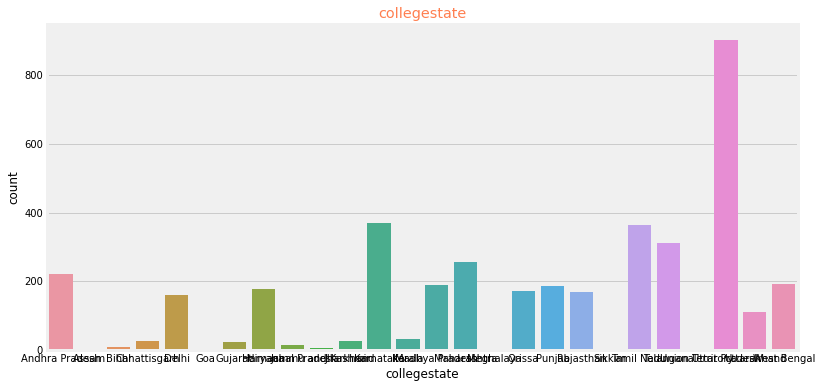

In [40]:
plt.figure(figsize = (12, 6))
sns.countplot(df['collegestate'])
plt.title('collegestate',color='coral')
print(df['collegestate'].unique())
print()
print('****************************')
print()
print(df['collegestate'].value_counts())
print()


### Pie-Chart

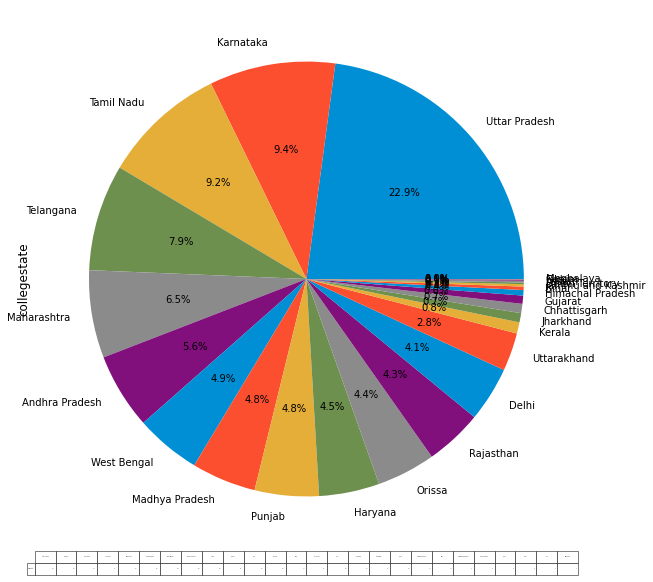

In [41]:
plt.figure(figsize=(10,10))
df.collegestate.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

## Salary

### Count Plot

[ 420000  500000  325000 1100000  200000  300000  400000  600000  230000
  450000  270000  350000  250000  120000  320000  190000  180000  335000
  435000  345000  145000  530000  340000  360000  215000   80000  330000
  380000  110000  205000   95000  390000   60000  240000  525000  305000
  150000  310000  455000  800000  100000  280000  445000  315000  220000
  370000  275000  425000  470000  460000  510000  480000  170000  640000
  225000  440000 1200000  675000  105000  195000  385000  235000  615000
  290000  140000  405000 1860000  375000  430000  660000   70000  410000
  550000   35000  115000  415000  265000  285000  245000  395000  560000
  700000  185000  160000  625000   85000  135000  785000  210000  155000
  355000  535000  690000  260000 1110000 1000000  505000  475000  715000
  820000   90000  720000 2600000  515000   55000  495000   65000  655000
  545000  520000  645000 1025000  775000  490000 1300000 3500000  910000
  570000  255000  130000  175000  730000  555000  4

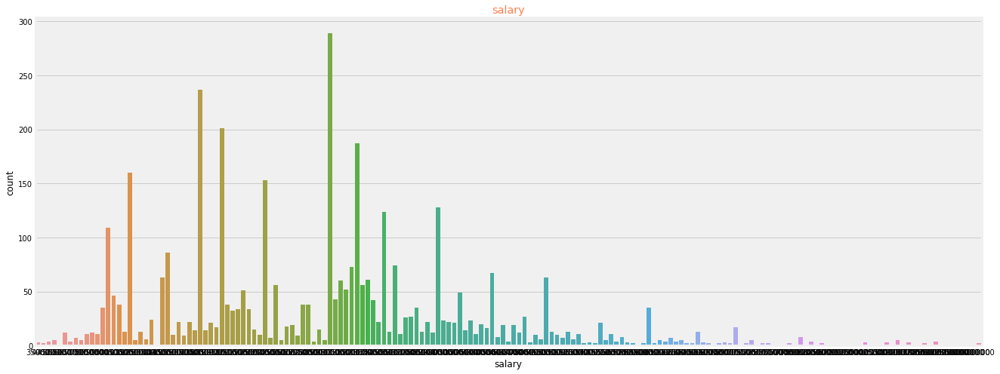

In [42]:
plt.figure(figsize=(20,8))
sns.countplot(df['salary'])
plt.title('salary',color='coral')
print(df['salary'].unique())
print()
print('****************************')
print()
print(df['salary'].value_counts())
print()

### Pie-Chart

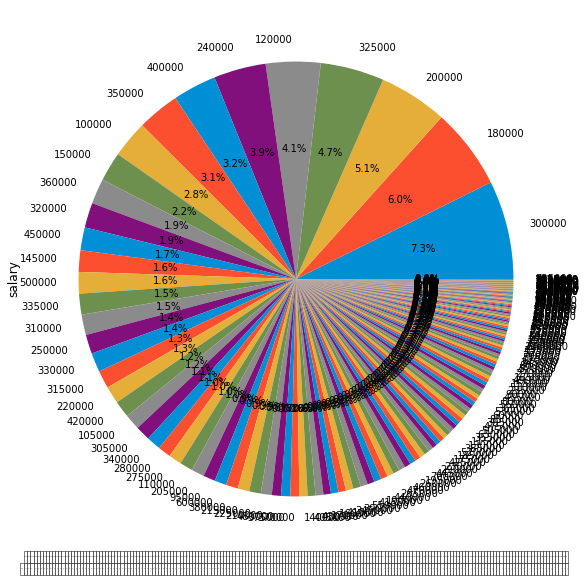

In [43]:
plt.figure(figsize=(10,10))
df.salary.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

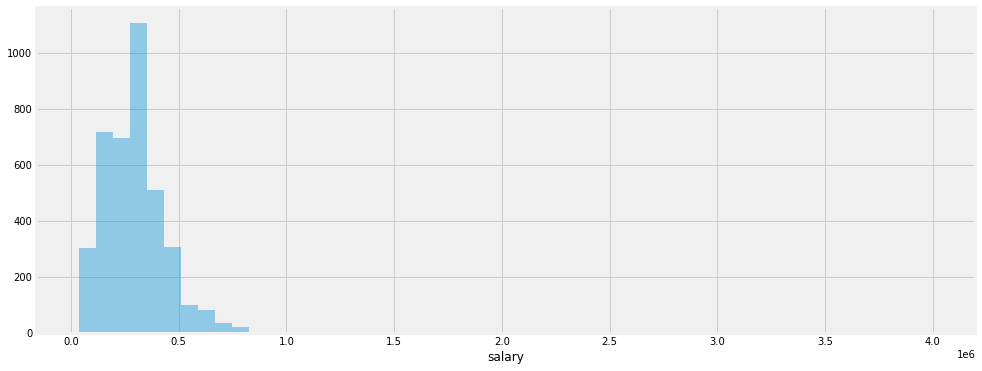

In [44]:
plt.figure(figsize=(15,6))
sns.distplot(df['salary'],kde=False)
plt.show()


### Normal Distribution

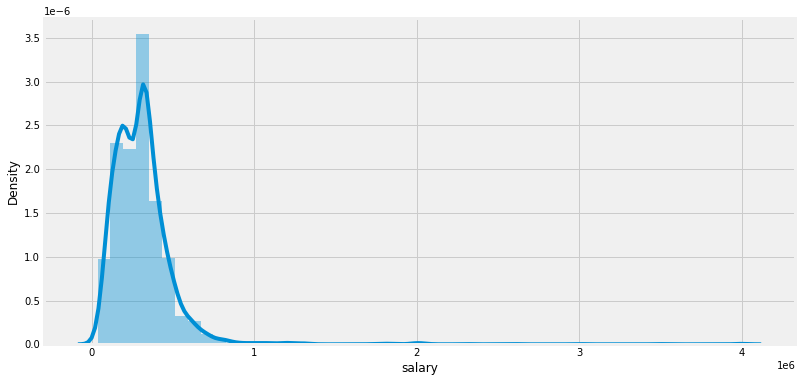


mean:  308256.1501394877
median: 300000.0
mode: 0    300000
dtype: int64



In [45]:
plt.figure(figsize=(12,6))
sns.distplot(df['salary'])
plt.show()
print()
print('mean: ',df['salary'].mean())
print('median:',df['salary'].median())
print('mode:',df['salary'].mode())
print()


### Box-Cox Transformation

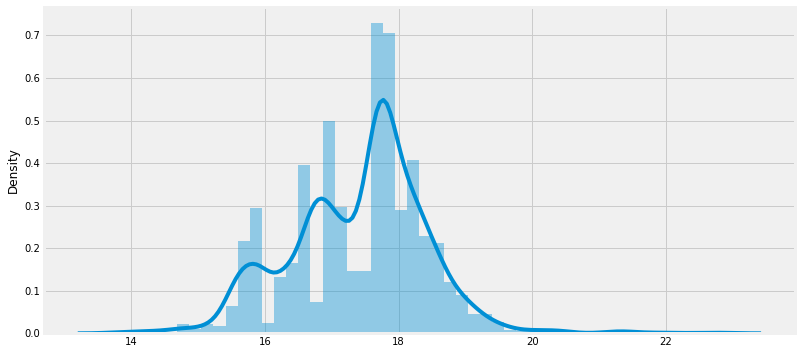



mean:  17.406845851883105
median: 17.622156069279285
mode: 17.622156069279285

Skewness: 0.010195614731479893
Kurtosis: 1.1868035060124855



In [46]:
plt.figure(figsize=(12,6))
transformed, _ = stats.boxcox(df['salary']) 
#plot the distribution of the transformed data values
sns.distplot(transformed)
plt.show()
print()
print()
print('mean: ',transformed.mean())
print('median:',np.median(transformed))
print('mode:',st.mode(transformed))
print()
print('Skewness:',skew(transformed))
print('Kurtosis:',kurtosis(transformed))
print()

### Box Plot

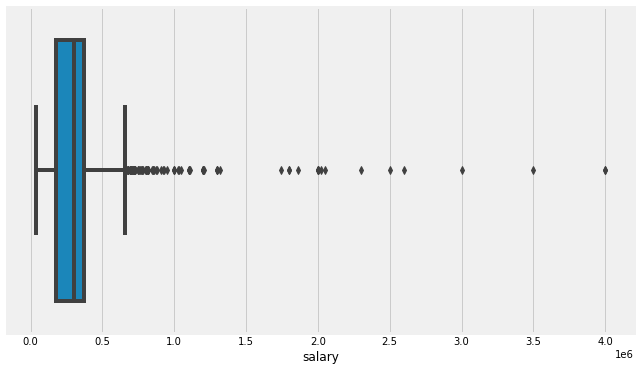

In [47]:
plt.figure(figsize=(10,6))
sns.boxplot(df['salary'])

## 10percentage 

### Count Plot

[84.3  85.4  85.   85.6  78.   89.92 86.08 92.   90.   77.   88.6  81.
 83.6  60.8  81.2  69.54 85.8  65.   79.   91.2  75.67 92.5  70.   88.
 86.8  90.88 76.8  84.   77.2  87.   73.   71.   91.5  52.33 66.6  75.
 91.4  59.   84.5  95.8  69.6  86.6  81.92 66.5  80.   85.2  89.25 58.4
 90.8  89.88 63.3  72.   83.   85.3  60.66 89.37 84.4  89.   86.   70.6
 93.44 76.   86.4  84.83 72.3  69.   73.33 86.16 56.   79.25 88.66 80.8
 81.16 83.5  55.6  84.6  62.   68.4  51.   79.6  63.4  86.53 76.18 91.43
 76.17 82.4  58.   90.04 60.4  74.23 59.8  82.3  84.2  60.   82.8  82.6
 74.   89.8  88.67 64.66 77.8  89.5  64.56 91.12 78.33 81.33 89.7  87.4
 92.66 76.87 91.3  77.9  76.2  77.78 65.6  65.8  67.75 91.6  78.66 78.4
 61.   90.4  58.6  82.2  82.   90.1  86.17 83.89 76.7  88.2  80.6  91.
 74.4  79.28 84.96 92.8  79.4  66.8  79.8  65.3  94.6  83.33 80.83 67.23
 86.2  55.   86.62 69.13 89.12 87.5  66.4  80.33 75.2  50.6  81.1  60.14
 78.83 75.8  77.66 64.48 67.   75.6  71.5  93.6  93.33 78.8  64. 

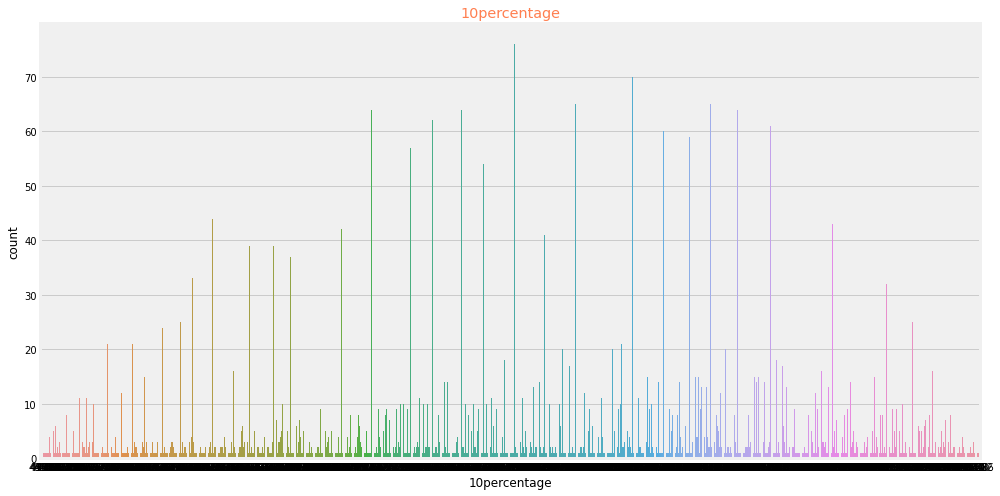

In [48]:
plt.figure(figsize=(15,8))
sns.countplot(df['10percentage'])
plt.title('10percentage',color='coral')
print(df['10percentage'].unique())
print()
print('****************************')
print()
print(df['10percentage'].value_counts())
print()

### Histogram

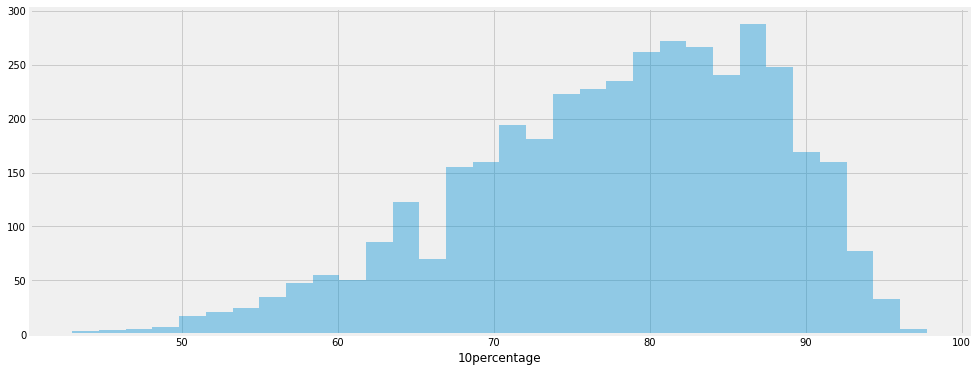

In [49]:
plt.figure(figsize=(15,6))
sns.distplot(df['10percentage'],kde=False)
plt.show()

### Pie-Chart

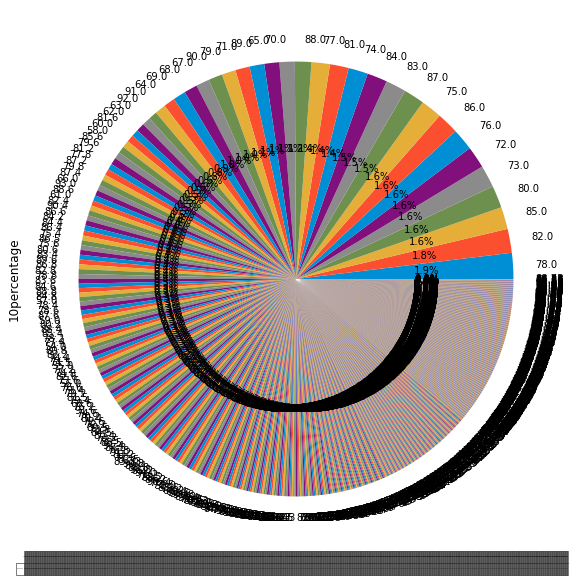

In [50]:
plt.figure(figsize=(10,10))
df['10percentage'].value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Normal Distribution

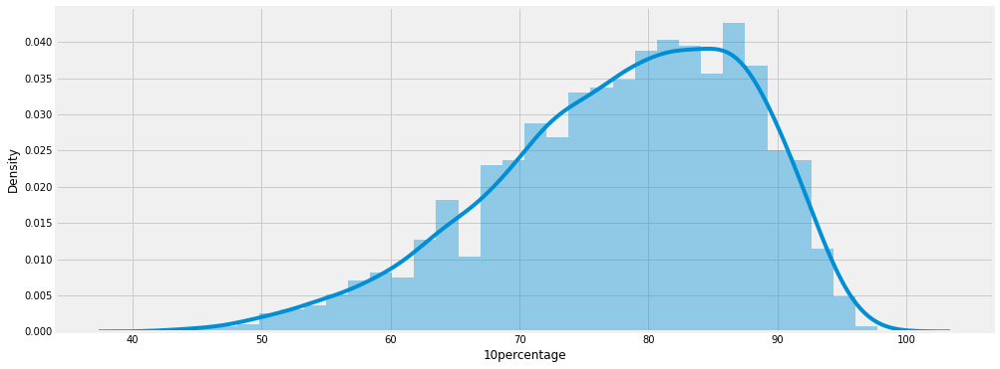


mean:  77.94655084960682
median: 79.2
mode: 0    78.0
dtype: float64

Skewness: -0.5968475375865996
Kurtosis: -0.09412652705897218



In [51]:
plt.figure(figsize=(15,6))
sns.distplot(df['10percentage'])
plt.show()
print()
print('mean: ',df['10percentage'].mean())
print('median:',df['10percentage'].median())
print('mode:',df['10percentage'].mode())
print()
print('Skewness:',skew(df['10percentage']))
print('Kurtosis:',kurtosis(df['10percentage']))
print()

### Box-Cox Transformation

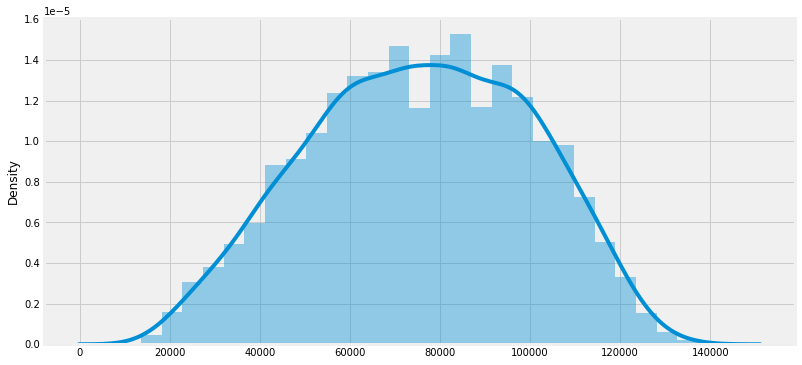



mean:  75558.7530245499
median: 76012.68641041602
mode: 72824.28083794515

Skewness: -0.09728573628642685
Kurtosis: -0.7258091979213579



In [52]:
plt.figure(figsize=(12,6))
transformed, _ = stats.boxcox(df['10percentage']) 
#plot the distribution of the transformed data values
sns.distplot(transformed)
plt.show()
print()
print()
print('mean: ',transformed.mean())
print('median:',np.median(transformed))
print('mode:',st.mode(transformed))
print()
print('Skewness:',skew(transformed))
print('Kurtosis:',kurtosis(transformed))
print()

### Box Plot

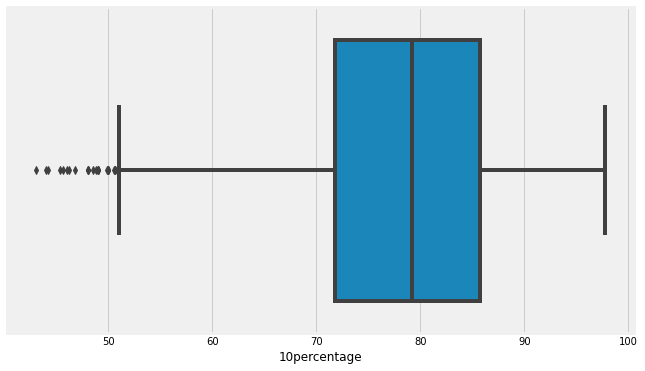

In [53]:
plt.figure(figsize=(10,6))
sns.boxplot(df['10percentage'])

## 12graduation

### Count Plot

[2007 2010 2008 2009 2006 2011 2005 1995 2004 2012 2003 2002 2001 1998
 2013 1999]

****************************

2009    1030
2008     924
2010     726
2007     526
2006     406
2005     160
2004      73
2011      43
2003      25
2002      14
2012      10
2001       2
2013       1
1999       1
1995       1
1998       1
Name: 12graduation, dtype: int64



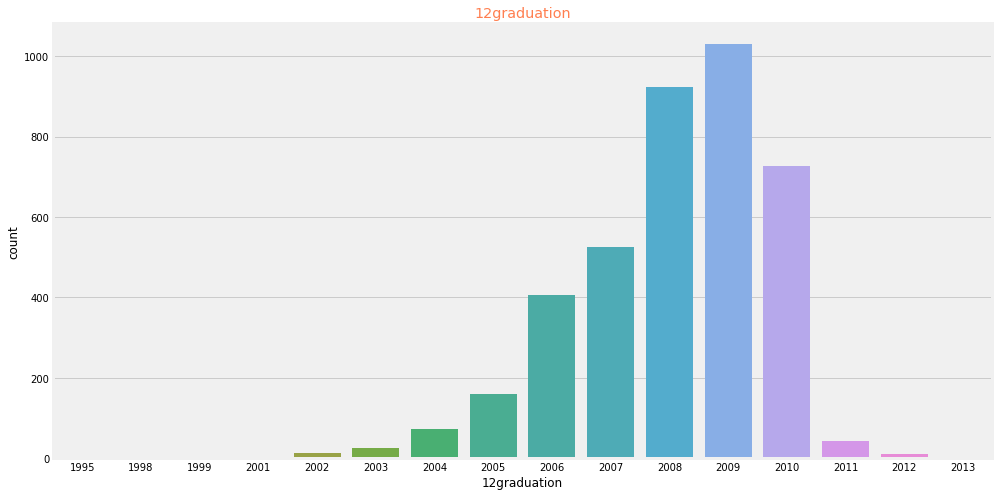

In [54]:
plt.figure(figsize=(15,8))
sns.countplot(df['12graduation'])
plt.title('12graduation',color='coral')
print(df['12graduation'].unique())
print()
print('****************************')
print()
print(df['12graduation'].value_counts())
print()

### Histogram

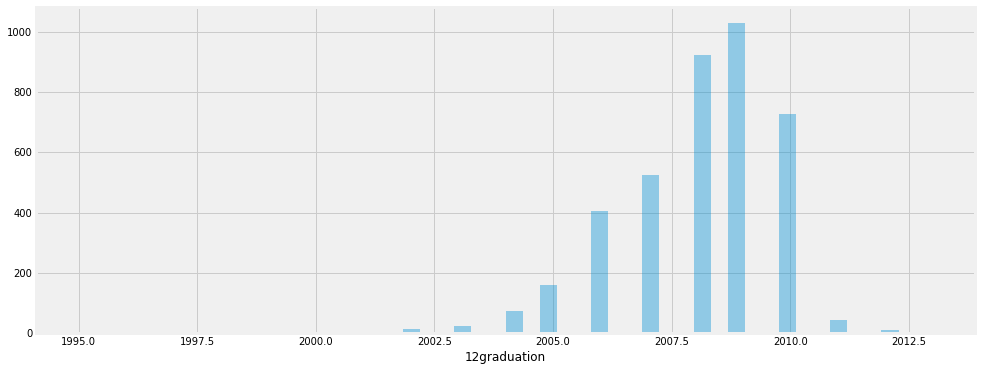

In [55]:
plt.figure(figsize=(15,6))
sns.distplot(df['12graduation'],kde=False)
plt.show()

### Pie-Chart

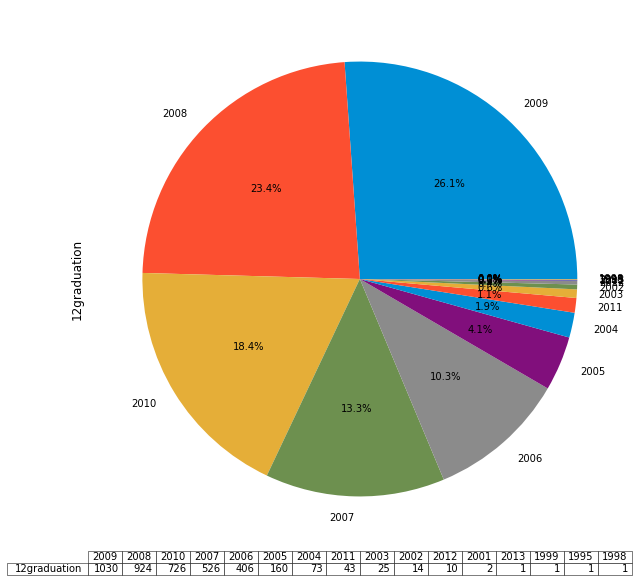

In [56]:
plt.figure(figsize=(10,10))
df['12graduation'].value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Normal Distribution

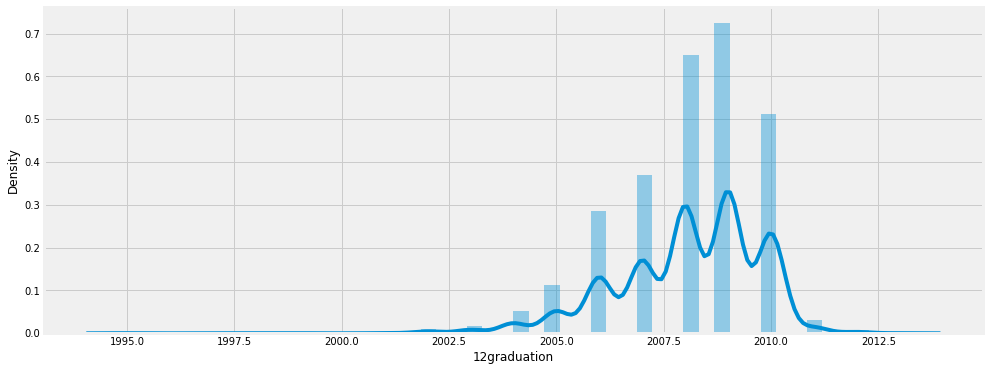


mean:  2008.0738016738524
median: 2008.0
mode: 0    2009
dtype: int64

Skewness: -0.9574597573629958
Kurtosis: 1.9308199540929412



In [57]:
plt.figure(figsize=(15,6))
sns.distplot(df['12graduation'])
plt.show()
print()
print('mean: ',df['12graduation'].mean())
print('median:',df['12graduation'].median())
print('mode:',df['12graduation'].mode())
print()
print('Skewness:',skew(df['12graduation']))
print('Kurtosis:',kurtosis(df['12graduation']))
print()

### Box Plot

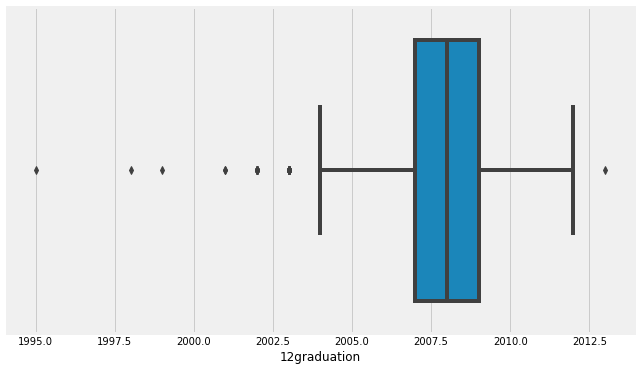

In [58]:
plt.figure(figsize=(10,6))
sns.boxplot(df['12graduation'])

## 12percentage  

### Count Plot

[95.8  85.   68.2  83.6  76.8  87.   67.5  91.   91.2  72.2  83.7  86.
 69.83 62.4  79.9  64.43 74.8  66.66 64.8  62.2  84.63 74.4  95.2  43.42
 90.   82.8  82.5  83.   68.   92.   86.1  84.4  68.4  61.   93.8  85.4
 67.   89.66 68.6  60.   73.   87.7  87.16 82.   71.4  75.   61.46 49.5
 72.5  81.5  78.   90.1  70.1  95.4  61.1  49.   79.   88.3  77.8  94.4
 86.67 73.2  64.   77.   78.67 72.   78.2  95.   82.4  60.2  62.6  70.
 71.33 70.08 56.   80.   84.33 65.   68.5  94.2  66.   88.   76.6  50.8
 66.5  76.4  65.8  48.   63.   71.55 86.33 74.   71.3  57.6  83.4  75.16
 77.77 60.25 89.6  86.4  80.4  59.   73.6  63.6  66.6  86.8  79.6  87.58
 81.4  89.   62.   47.   77.2  54.   67.6  91.9  63.1  69.   68.46 85.2
 78.4  82.2  95.6  81.33 88.9  82.75 72.6  66.67 70.2  61.5  70.6  79.4
 61.8  95.5  80.7  60.4  77.14 75.2  81.2  80.8  88.88 83.9  65.2  83.1
 80.6  70.16 90.91 84.7  68.55 59.16 78.83 59.9  75.6  87.8  79.2  80.3
 82.1  65.5  84.3  64.4  91.6  95.3  69.8  86.9  73.4  56.9  86

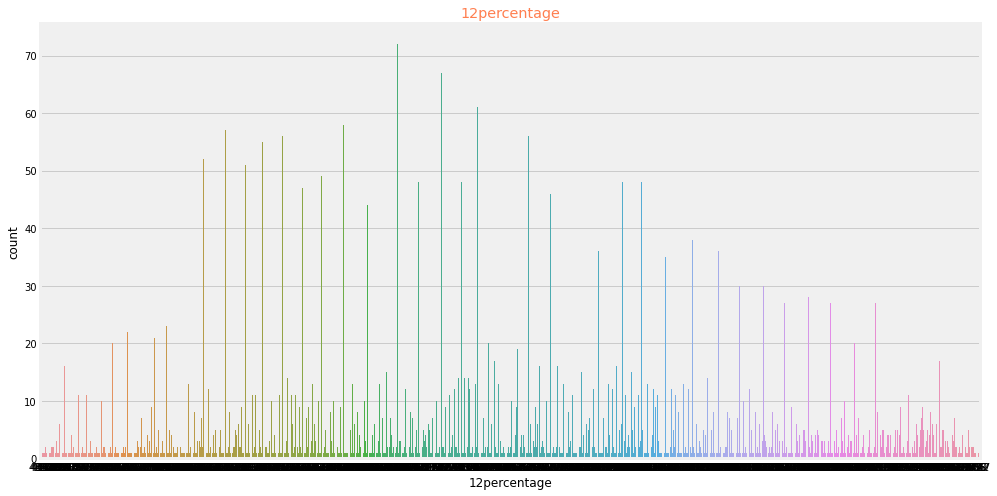

In [59]:
plt.figure(figsize=(15,8))
sns.countplot(df['12percentage'])
plt.title('12percentage',color='coral')
print(df['12percentage'].unique())
print()
print('****************************')
print()
print(df['12percentage'].value_counts())
print()

### Pie-Chart

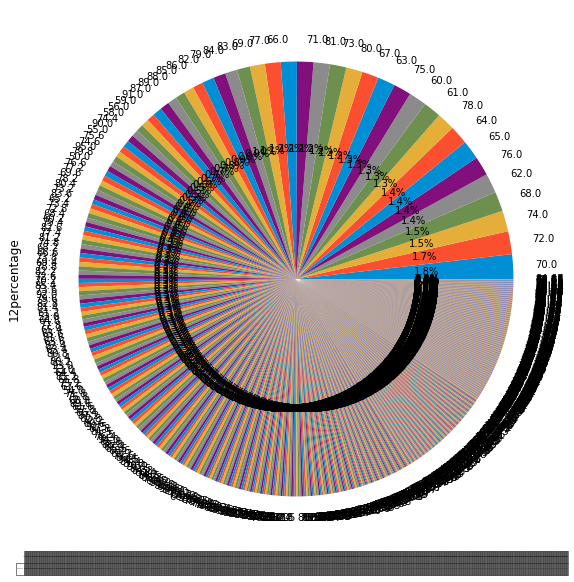

In [60]:
plt.figure(figsize=(10,10))
df['12percentage'].value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

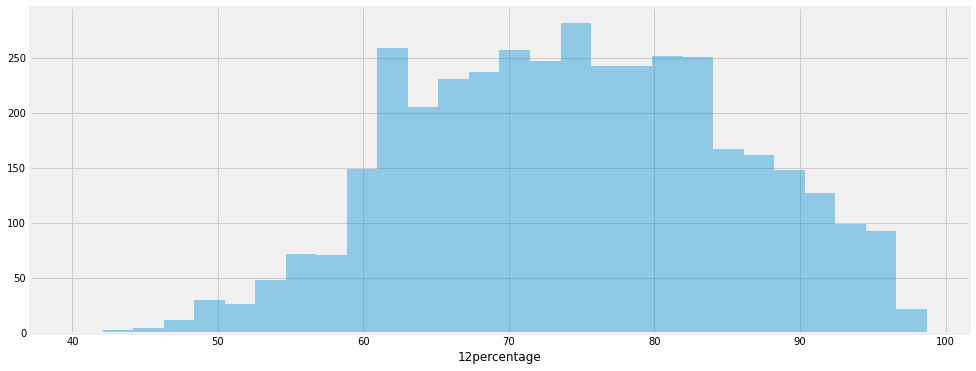

In [61]:
plt.figure(figsize=(15,6))
sns.distplot(df['12percentage'],kde=False)
plt.show()

### Normal Distribution

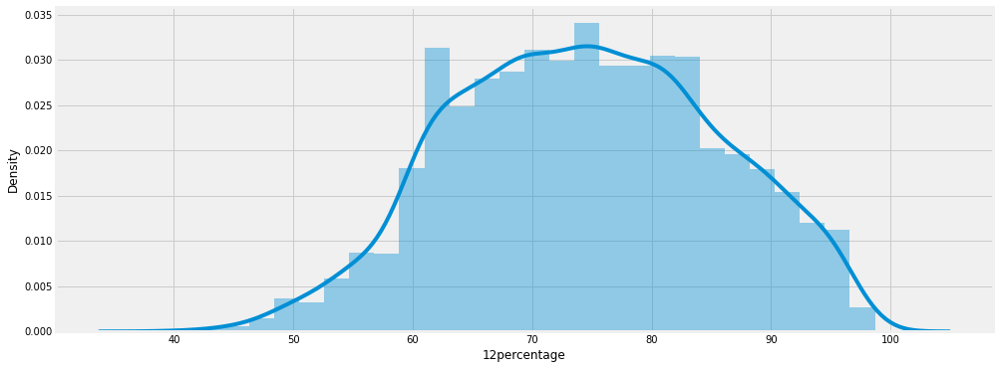


mean:  74.45995434947996
median: 74.4
mode: 0    70.0
dtype: float64

Skewness: -0.036136226092275806
Kurtosis: -0.6251611411212243



In [62]:
plt.figure(figsize=(15,6))
sns.distplot(df['12percentage'])
plt.show()
print()
print('mean: ',df['12percentage'].mean())
print('median:',df['12percentage'].median())
print('mode:',df['12percentage'].mode())
print()
print('Skewness:',skew(df['12percentage']))
print('Kurtosis:',kurtosis(df['12percentage']))
print()

### Box-Cox Transformation

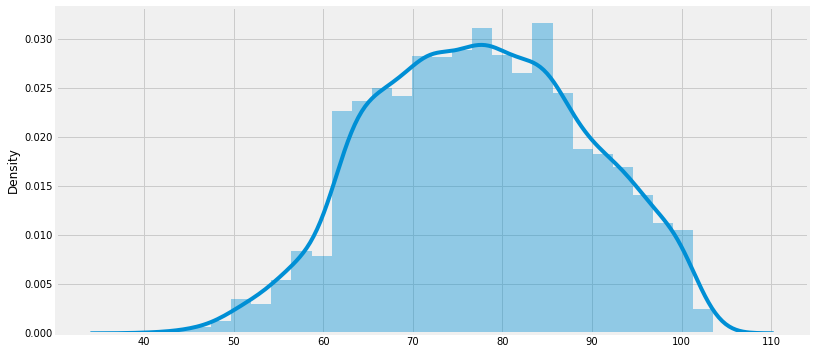



mean:  77.52561582099301
median: 77.44741484987517
mode: 72.73744911513701

Skewness: -0.031137733030039402
Kurtosis: -0.6279471797559197



In [63]:
plt.figure(figsize=(12,6))
transformed, _ = stats.boxcox(df['12percentage']) 
#plot the distribution of the transformed data values
sns.distplot(transformed)
plt.show()
print()
print()
print('mean: ',transformed.mean())
print('median:',np.median(transformed))
print('mode:',st.mode(transformed))
print()
print('Skewness:',skew(transformed))
print('Kurtosis:',kurtosis(transformed))
print()

### Box Plot

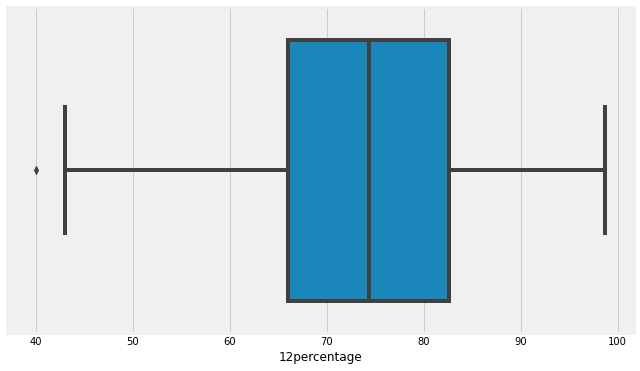

In [64]:
plt.figure(figsize=(10,6))
sns.boxplot(df['12percentage'])

## graduationyear 

### Count Plot

[2011. 2012. 2014. 2016. 2013. 2010. 2015. 2009. 2017. 2007.]

****************************

2013.0    1160
2014.0    1016
2012.0     840
2011.0     507
2010.0     291
2015.0      89
2009.0      24
2017.0       8
2016.0       7
2007.0       1
Name: graduationyear, dtype: int64



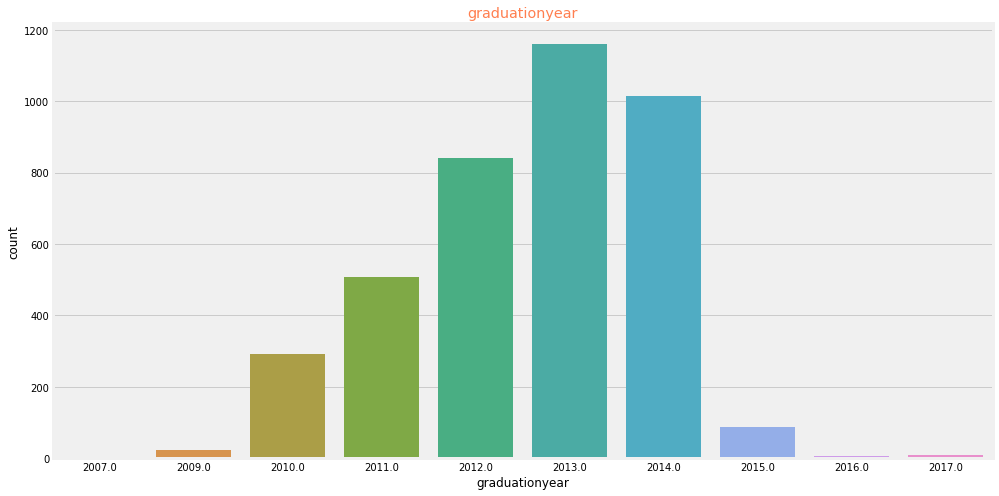

In [65]:
plt.figure(figsize=(15,8))
sns.countplot(df['graduationyear'])
plt.title('graduationyear',color='coral')
print(df['graduationyear'].unique())
print()
print('****************************')
print()
print(df['graduationyear'].value_counts())
print()

### Pie-Chart

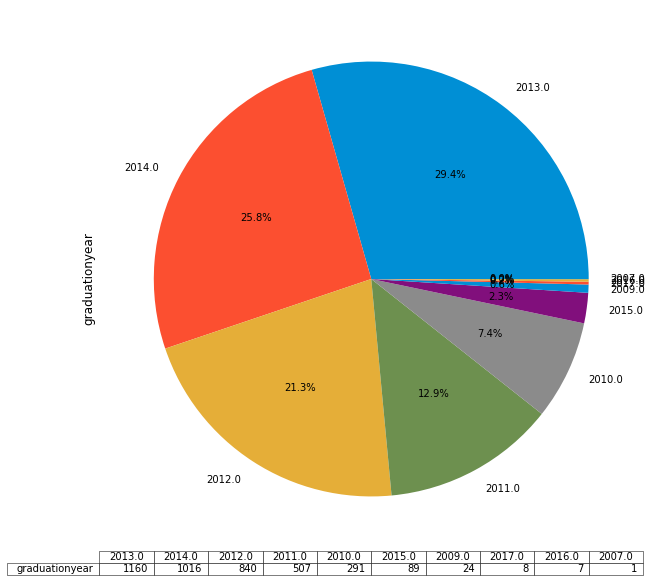

In [66]:
plt.figure(figsize=(10,10))
df.graduationyear.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

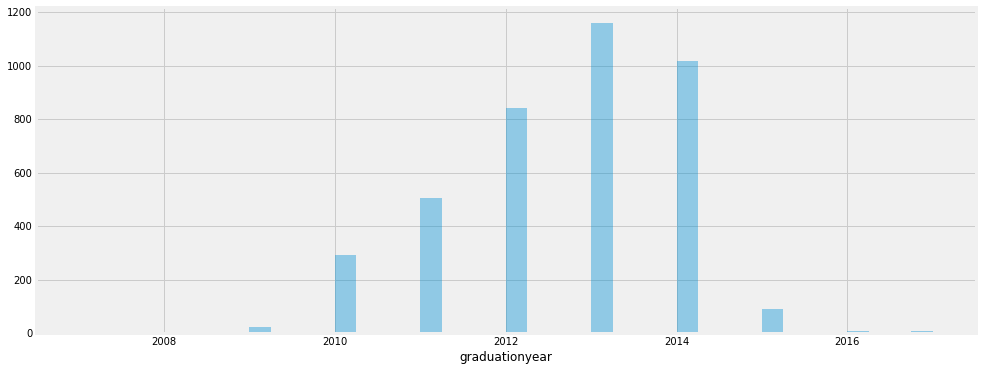

In [67]:
plt.figure(figsize=(15,6))
sns.distplot(df['graduationyear'],kde=False)
plt.show()

### Normal Distribution

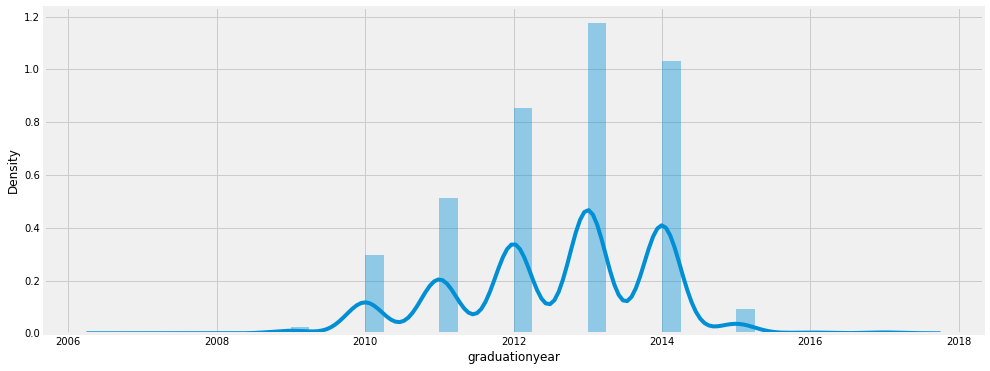


mean:  2012.5987826528024
median: 2013.0
mode: 0    2013.0
dtype: float64

Skewness: -0.399358586135313
Kurtosis: -0.2532929020440733



In [68]:
plt.figure(figsize=(15,6))
sns.distplot(df['graduationyear'])
plt.show()
print()
print('mean: ',df['graduationyear'].mean())
print('median:',df['graduationyear'].median())
print('mode:',df['graduationyear'].mode())
print()
print('Skewness:',skew(df['graduationyear']))
print('Kurtosis:',kurtosis(df['graduationyear']))
print()

### Box Plot

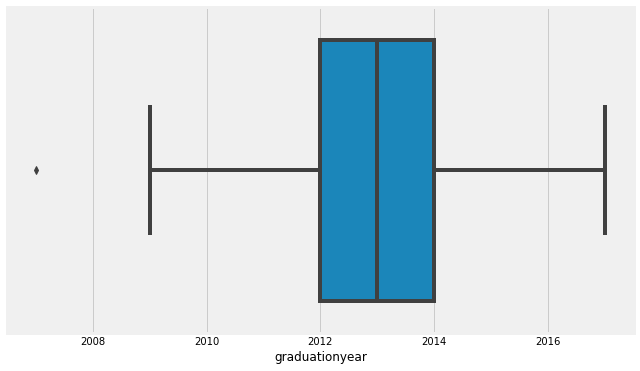

In [69]:
plt.figure(figsize=(10,6))
sns.boxplot(df['graduationyear'])

## collegegpa

### Count Plot

[78.   70.06 70.   ... 65.05 74.73 70.42]

****************************

70.00    111
72.00     95
75.00     83
65.00     79
68.00     74
        ... 
69.64      1
67.98      1
68.76      1
75.47      1
61.43      1
Name: collegegpa, Length: 1262, dtype: int64



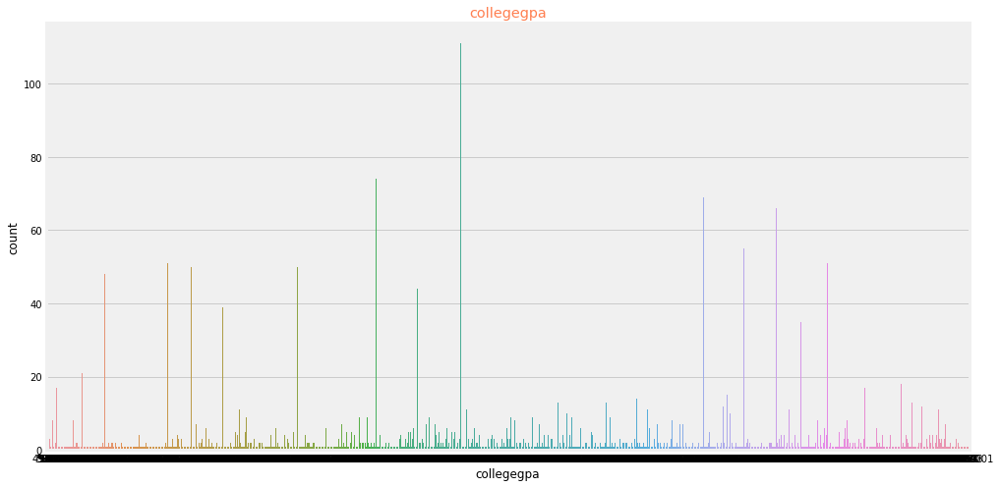

In [70]:
plt.figure(figsize=(15,8))
sns.countplot(df['collegegpa'])
plt.title('collegegpa',color='coral')
print(df['collegegpa'].unique())
print()
print('****************************')
print()
print(df['collegegpa'].value_counts())
print()

### Pie-Chart

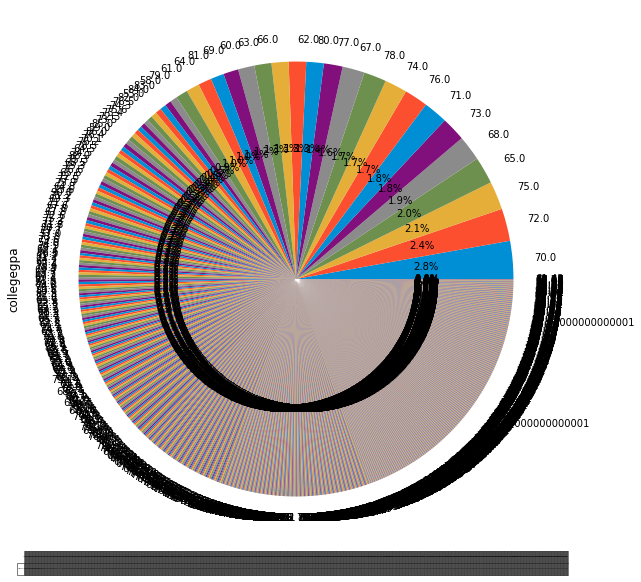

In [71]:
plt.figure(figsize=(10,10))
df.collegegpa.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

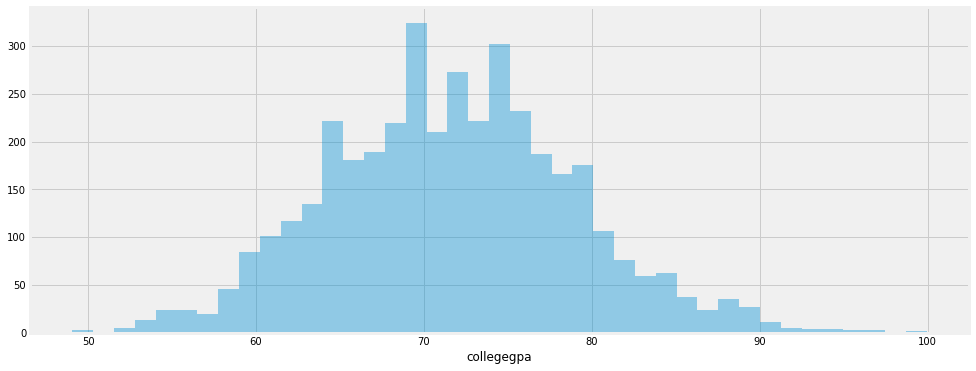

In [72]:
plt.figure(figsize=(15,6))
sns.distplot(df['collegegpa'],kde=False)
plt.show()

### Normal Distribution

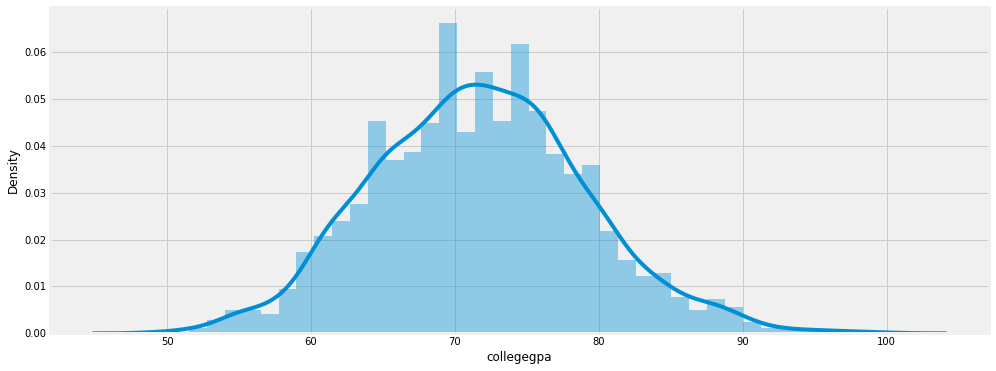


mean:  71.69941922394116
median: 71.77
mode: 0    70.0
dtype: float64

Skewness: 0.17134917634322236
Kurtosis: 0.07595437619224255



In [73]:
plt.figure(figsize=(15,6))
sns.distplot(df['collegegpa'])
plt.show()
print()
print('mean: ',df['collegegpa'].mean())
print('median:',df['collegegpa'].median())
print('mode:',df['collegegpa'].mode())
print()
print('Skewness:',skew(df['collegegpa']))
print('Kurtosis:',kurtosis(df['collegegpa']))
print()

### Box-Cox Transformation

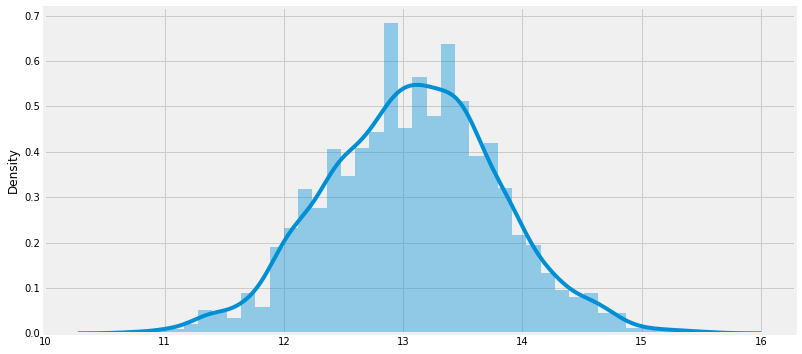



mean:  13.082023961735175
median: 13.109181069720908
mode: 12.936732273359349

Skewness: 9.708212427246027e-05
Kurtosis: 0.011653556620291994



In [74]:
plt.figure(figsize=(12,6))
transformed, _ = stats.boxcox(df['collegegpa']) 
#plot the distribution of the transformed data values
sns.distplot(transformed)
plt.show()
print()
print()
print('mean: ',transformed.mean())
print('median:',np.median(transformed))
print('mode:',st.mode(transformed))
print()
print('Skewness:',skew(transformed))
print('Kurtosis:',kurtosis(transformed))
print()

### Box Plot

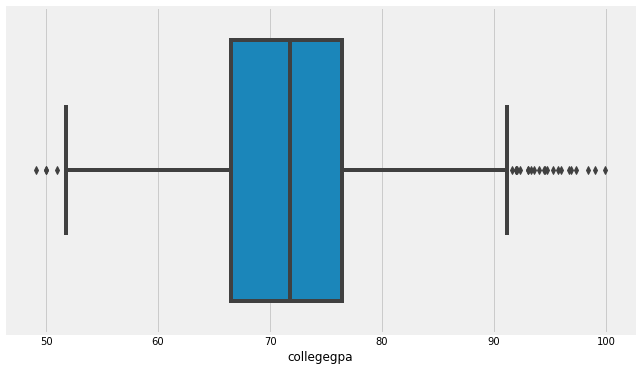

In [75]:
plt.figure(figsize=(10,6))
sns.boxplot(df['collegegpa'])

## english

### Count Plot

[515 695 615 635 545 560 590 605 565 495 380 395 485 685 465 455 385 370
 625 575 415 535 580 475 570 430 450 510 425 555 300 505 440 525 420 640
 444 630 665 675 325 405 375 710 345 250 350 275 360 265 595 585 520 500
 735 765 335 490 660 355 530 365 655 730 445 720 645 650 875 534 454 544
 295 285 435 464 705 554 745 280 315 825 290 715 310 215 700 870 305 524
 755 790 800 205 725 780 404 770 805 180 830 795 255 324 775 394 240 225
 850 684 334]

****************************

475    157
465    149
545    147
535    138
405    110
      ... 
255      1
825      1
775      1
795      1
180      1
Name: english, Length: 111, dtype: int64



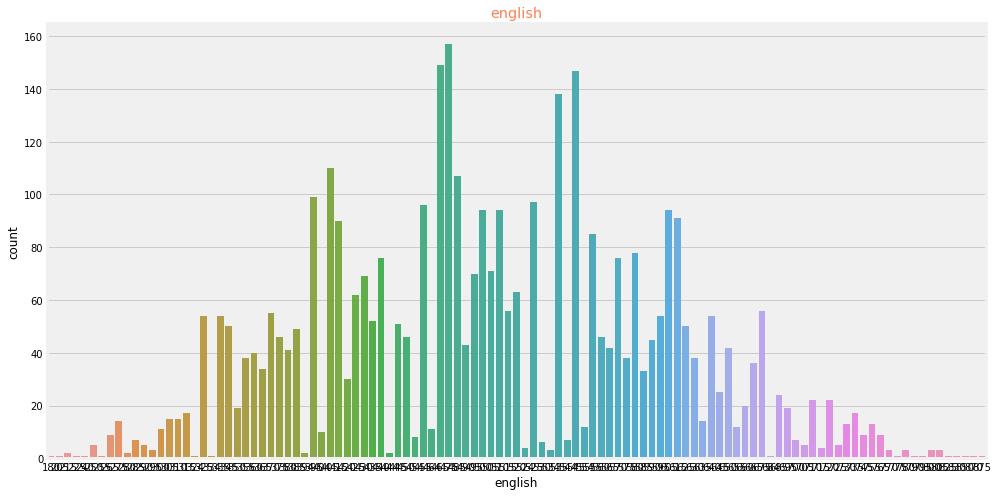

In [76]:
plt.figure(figsize=(15,8))
sns.countplot(df['english'])
plt.title('english',color='coral')
print(df['english'].unique())
print()
print('****************************')
print()
print(df['english'].value_counts())
print()

### Pie-Chart

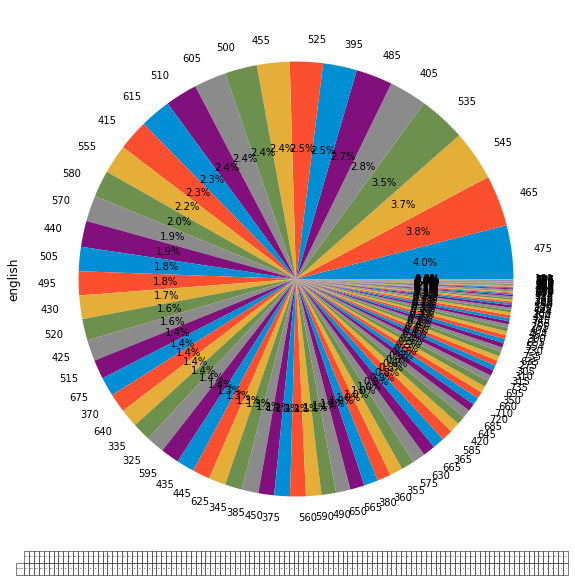

In [77]:
plt.figure(figsize=(10,10))
df.english.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

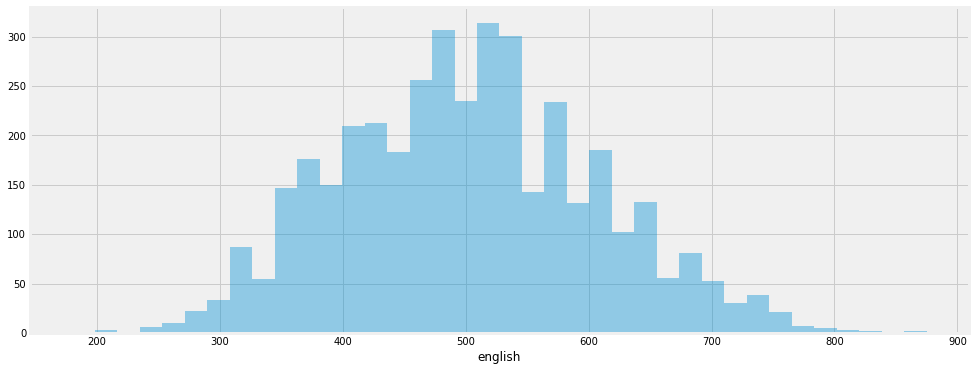

In [78]:
plt.figure(figsize=(15,6))
sns.distplot(df['english'],kde=False)
plt.show()

### Normal Distribution

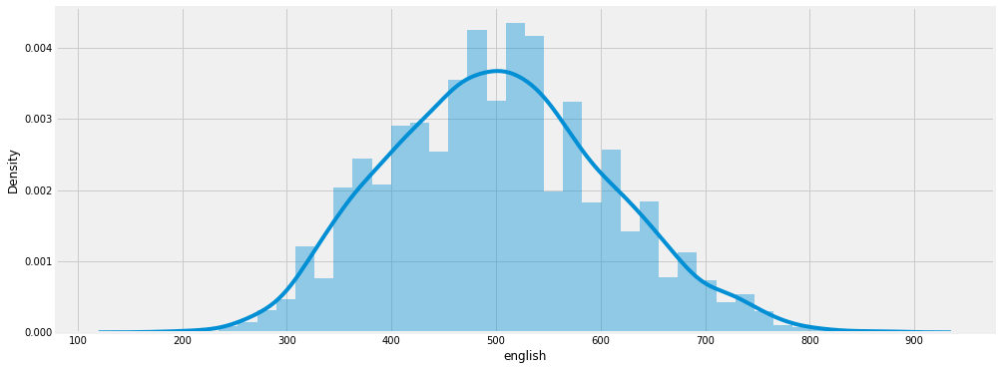


mean:  501.7862033984276
median: 500.0
mode: 0    475
dtype: int64

Skewness: 0.19493201632327092
Kurtosis: -0.25025618568966923



In [79]:
plt.figure(figsize=(15,6))
sns.distplot(df['english'])
plt.show()
print()
print('mean: ',df['english'].mean())
print('median:',df['english'].median())
print('mode:',df['english'].mode())
print()
print('Skewness:',skew(df['english']))
print('Kurtosis:',kurtosis(df['english']))
print()

### Box-Cox Transformation

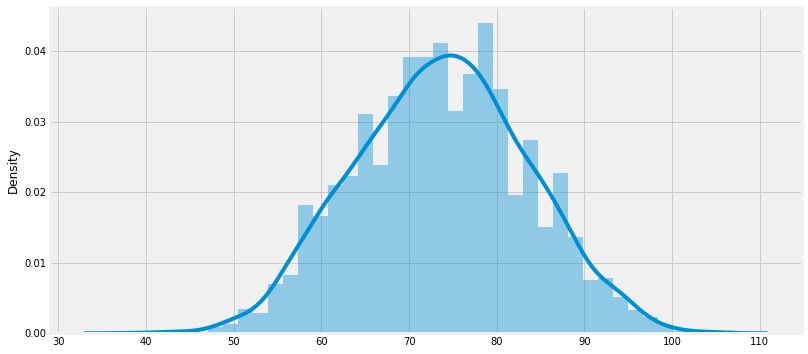



mean:  73.72860333428193
median: 73.95691188472045
mode: 71.59624907930808

Skewness: -0.012449126586605222
Kurtosis: -0.2802337526779741



In [80]:
plt.figure(figsize=(12,6))
transformed, _ = stats.boxcox(df['english']) 
#plot the distribution of the transformed data values
sns.distplot(transformed)
plt.show()
print()
print()
print('mean: ',transformed.mean())
print('median:',np.median(transformed))
print('mode:',st.mode(transformed))
print()
print('Skewness:',skew(transformed))
print('Kurtosis:',kurtosis(transformed))
print()

### Box Plot

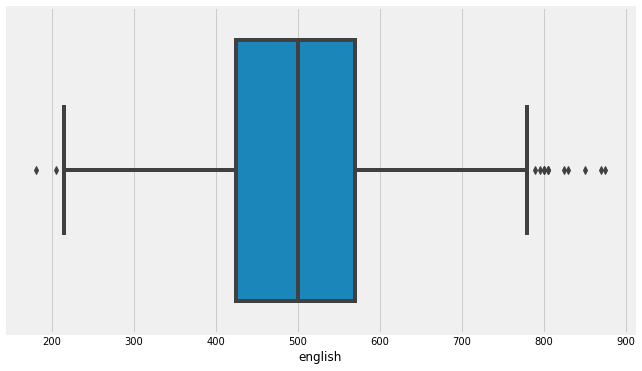

In [81]:
plt.figure(figsize=(10,6))
sns.boxplot(df['english'])

## logical

### Count Plot

[585 610 545 625 555 435 670 565 455 605 580 425 520 530 495 445 535 360
 335 510 570 405 485 475 525 640 595 560 340 395 415 465 505 385 460 410
 375 500 645 480 355 450 440 470 255 305 590 630 365 350 325 400 205 655
 295 345 390 665 515 540 680 245 620 420 575 635 554 315 615 215 370 300
 274 685 324 675 650 464 684 275 334 544 454 534 404 795 285 715 700 674
 690 695 394 270 705 310 490 330 280 735 380 290 265 240 195 235 660]

****************************

495    156
485    151
545    149
555    148
505    116
      ... 
534      1
660      1
674      1
235      1
240      1
Name: logical, Length: 107, dtype: int64



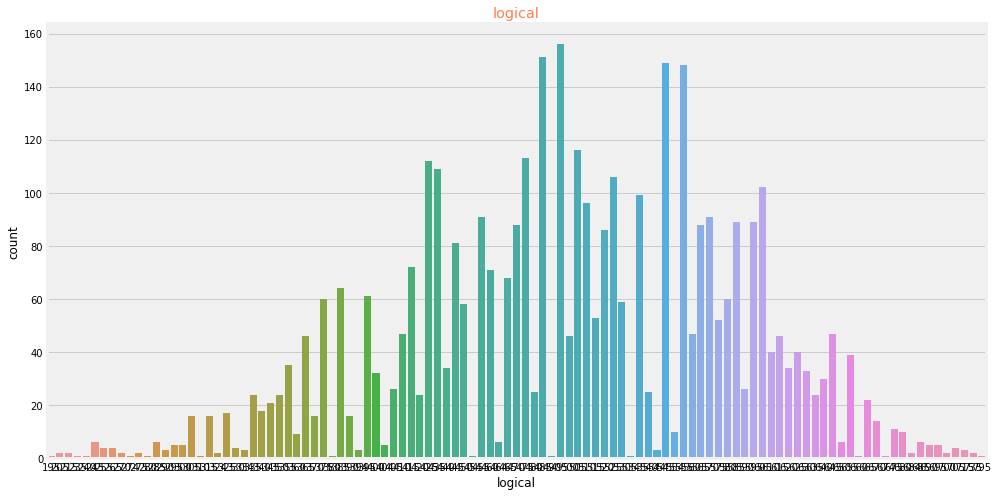

In [82]:
plt.figure(figsize=(15,8))
sns.countplot(df['logical'])
plt.title('logical',color='coral')
print(df['logical'].unique())
print()
print('****************************')
print()
print(df['logical'].value_counts())
print()

### Pie-Chart

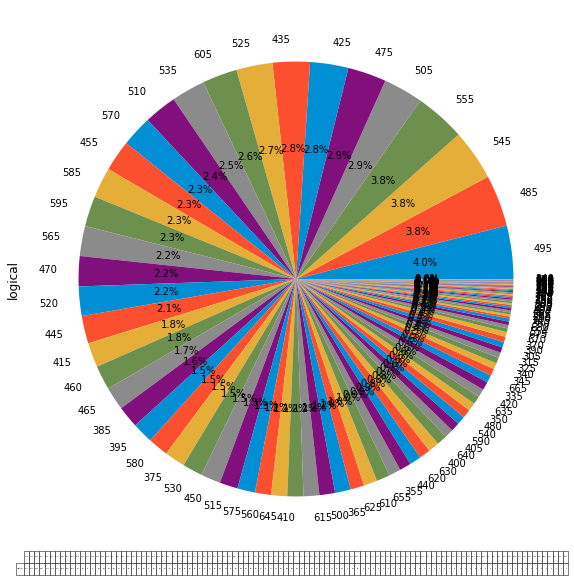

In [83]:
plt.figure(figsize=(10,10))
df.logical.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

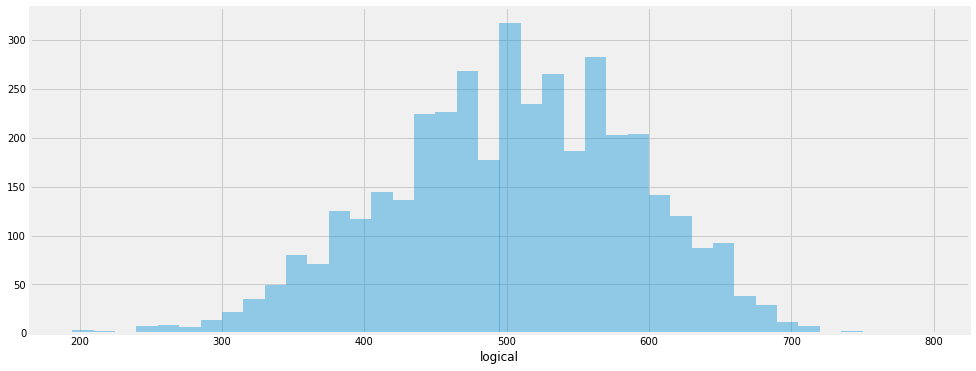

In [84]:
plt.figure(figsize=(15,6))
sns.distplot(df['logical'],kde=False)
plt.show()

### Normal Distribution

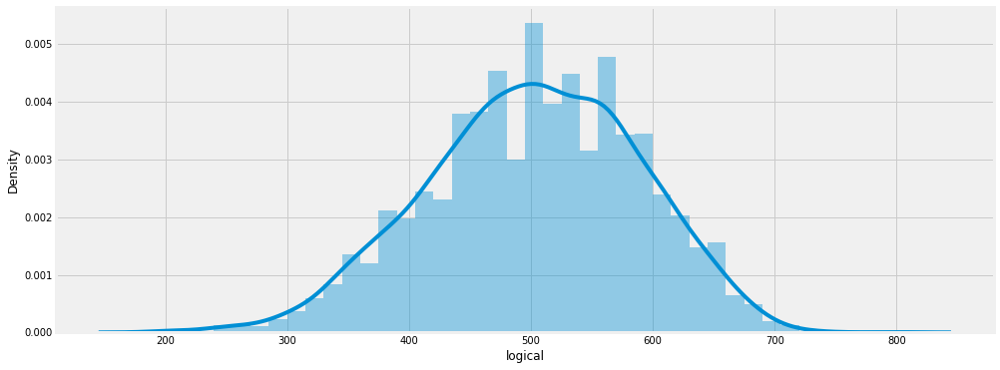


mean:  501.6071519147857
median: 505.0
mode: 0    495
dtype: int64

Skewness: -0.21759884502904214
Kurtosis: -0.22677416482713264



In [85]:
plt.figure(figsize=(15,6))
sns.distplot(df['logical'])
plt.show()
print()
print('mean: ',df['logical'].mean())
print('median:',df['logical'].median())
print('mode:',df['logical'].mode())
print()
print('Skewness:',skew(df['logical']))
print('Kurtosis:',kurtosis(df['logical']))
print()

### Box-Cox Transformation

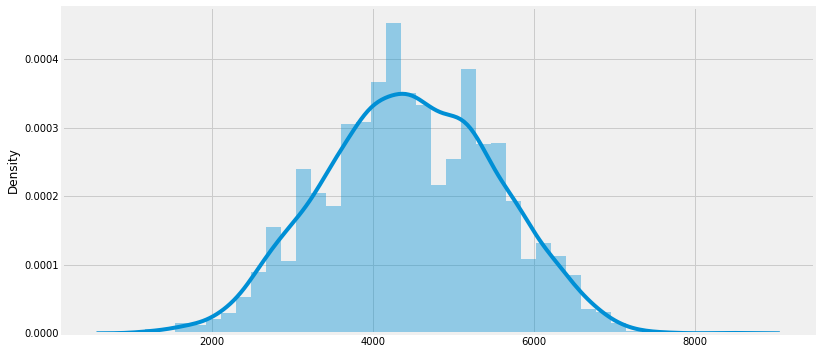



mean:  4460.373631043328
median: 4464.387663127735
mode: 4340.68312063606

Skewness: -0.03154211266813358
Kurtosis: -0.35748141142417555



In [86]:
plt.figure(figsize=(12,6))
transformed, _ = stats.boxcox(df['logical']) 
#plot the distribution of the transformed data values
sns.distplot(transformed)
plt.show()
print()
print()
print('mean: ',transformed.mean())
print('median:',np.median(transformed))
print('mode:',st.mode(transformed))
print()
print('Skewness:',skew(transformed))
print('Kurtosis:',kurtosis(transformed))
print()

### Box Plot

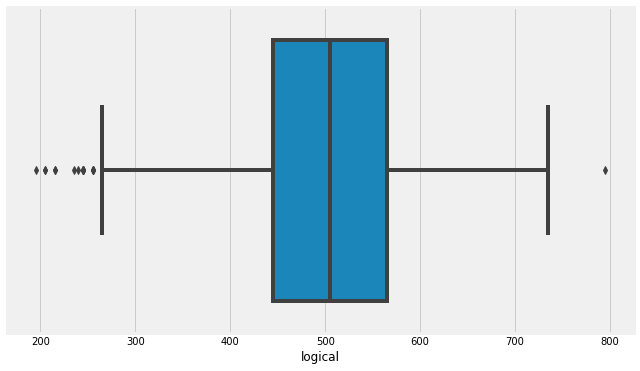

In [87]:
plt.figure(figsize=(10,6))
sns.boxplot(df['logical'])

## quant

### Count Plot

[525 780 370 625 465 620 380 590 530 545 565 715 470 645 355 515 435 445
 485 270 630 575 405 605 385 695 450 295 430 415 635 475 460 825 500 455
 554 595 495 665 250 310 325 390 510 535 340 440 705 534 400 395 570 750
 330 320 454 365 615 505 425 235 210 585 810 555 735 560 524 690 870 765
 675 520 655 305 725 840 650 375 720 265 280 464 404 800 680 260 674 760
 345 335 165 685 544 215 180 795 200 860 334 285 514 195 494 214 275 315
 324 175 684 225 740 805 444 410 135 255 220 755 855 145 245 885 120 900
 794 775 745 504 820 150 710 190 185 155 580 394]

****************************

605    142
485    129
545    124
575    115
515     99
      ... 
710      1
394      1
580      1
514      1
120      1
Name: quant, Length: 138, dtype: int64



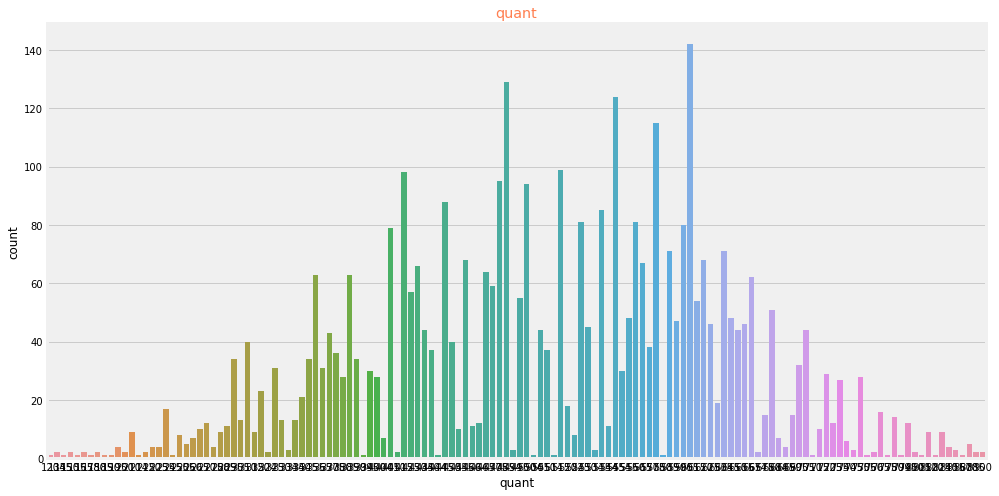

In [88]:
plt.figure(figsize=(15,8))
sns.countplot(df['quant'])
plt.title('quant',color='coral')
print(df['quant'].unique())
print()
print('****************************')
print()
print(df['quant'].value_counts())
print()

### Pie-Chart

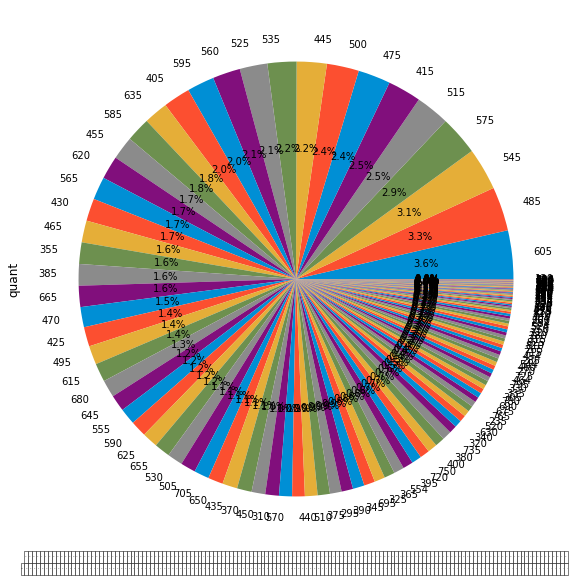

In [89]:
plt.figure(figsize=(10,10))
df.quant.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

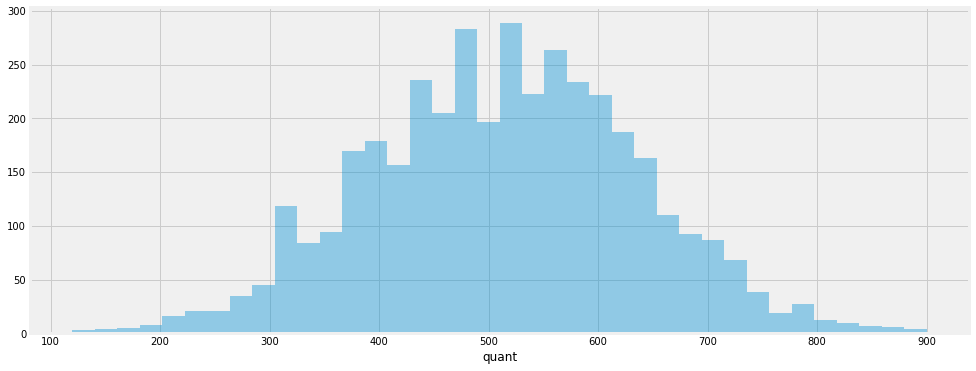

In [90]:
plt.figure(figsize=(15,6))
sns.distplot(df['quant'],kde=False)
plt.show()

### Normal Distribution

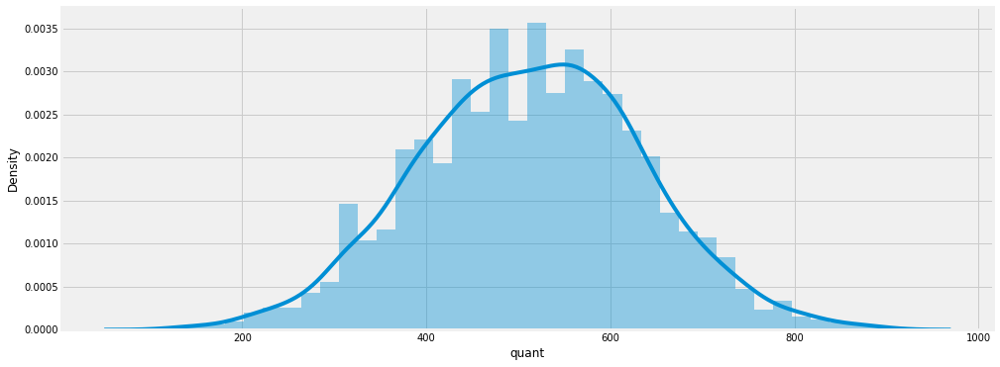


mean:  513.3073801673852
median: 515.0
mode: 0    605
dtype: int64

Skewness: -0.018380318566255785
Kurtosis: -0.09482383247226167



In [91]:
plt.figure(figsize=(15,6))
sns.distplot(df['quant'])
plt.show()
print()
print('mean: ',df['quant'].mean())
print('median:',df['quant'].median())
print('mode:',df['quant'].mode())
print()
print('Skewness:',skew(df['quant']))
print('Kurtosis:',kurtosis(df['quant']))
print()

### Box-Cox Transformation

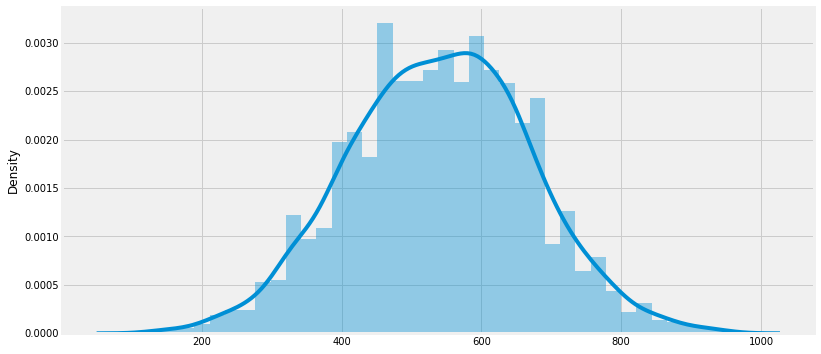



mean:  540.073736606812
median: 541.7157136875566
mode: 637.5834029145424

Skewness: -0.011194629648031744
Kurtosis: -0.09669656614869826



In [92]:
plt.figure(figsize=(12,6))
transformed, _ = stats.boxcox(df['quant']) 
#plot the distribution of the transformed data values
sns.distplot(transformed)
plt.show()
print()
print()
print('mean: ',transformed.mean())
print('median:',np.median(transformed))
print('mode:',st.mode(transformed))
print()
print('Skewness:',skew(transformed))
print('Kurtosis:',kurtosis(transformed))
print()

### Box Plot

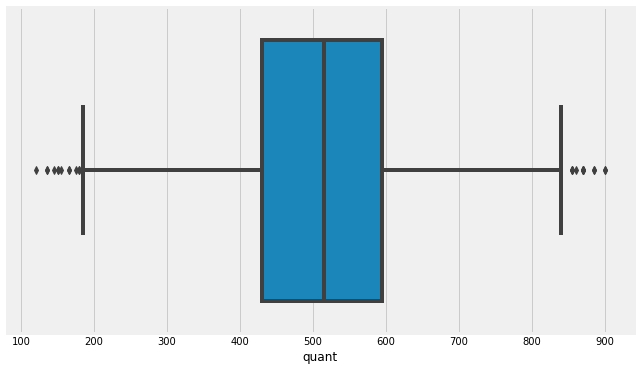

In [93]:
plt.figure(figsize=(10,6))
sns.boxplot(df['quant'])

## domain

### Count Plot

[0.63597876 0.96060325 0.45087658 0.97439611 0.12450207 0.64938971
 0.35653649 0.8295846  0.69447933 0.49359639 0.76567358 0.9682375
 0.22948175 0.53838689 0.30840058 0.91139528 0.56326782 0.86468541
 0.74475835 0.88412251 0.88162007 0.20739217 0.67074315 0.62264292
 0.41383826 0.52592258 0.73579571 0.13044174 0.23780284 0.11213944
 0.37755142 0.06696071 0.08005528 0.92564577 0.84312373 0.91686996
 0.78330354 0.60005718 0.79293628 0.79358061 0.48674701 0.16563309
 0.75537512 0.99990456 0.33878635 0.91077016 0.98205712 0.84224832
 0.01854094 0.05316031 0.94211655 0.12301673 0.48834798 0.37605959
 0.0587928  0.10487136 0.60064396 0.70409041 0.14478989 0.81941653
 0.65576694 0.02106623 0.44461772 0.83762073 0.72598415 0.95389978
 0.04099931 0.02196911 0.3423149  0.53586282 0.90148957 0.96177212
 0.67964464 0.93839914 0.19015341 0.99546472 0.99000876 0.97879929
 0.41433743 0.8246664  0.49063696 0.96600692 0.43696265 0.99225919
 0.97629256 0.98546139 0.90915194 0.86372418 0.07454627 0.66183

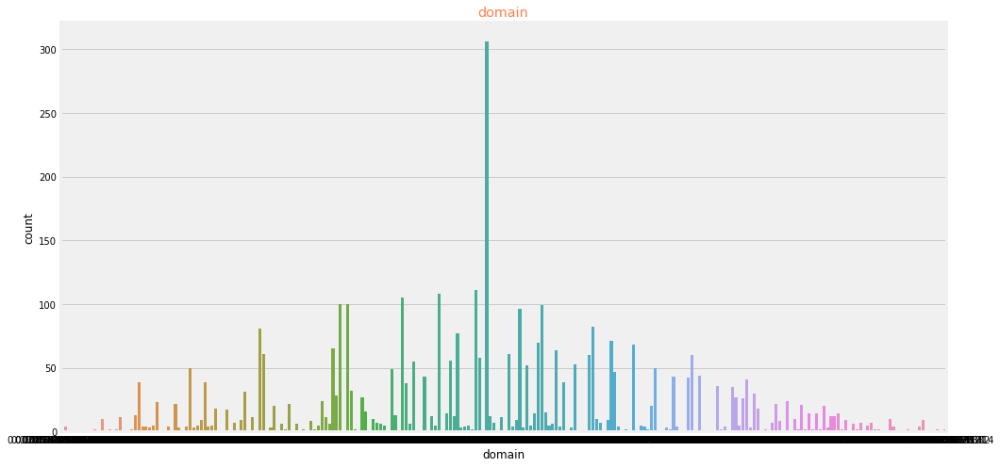

In [94]:
plt.figure(figsize=(15,8))
sns.countplot(df['domain'])
plt.title('domain',color='coral')
print(df['domain'].unique())
print()
print('****************************')
print()
print(df['domain'].value_counts())
print()

### Pie-Chart

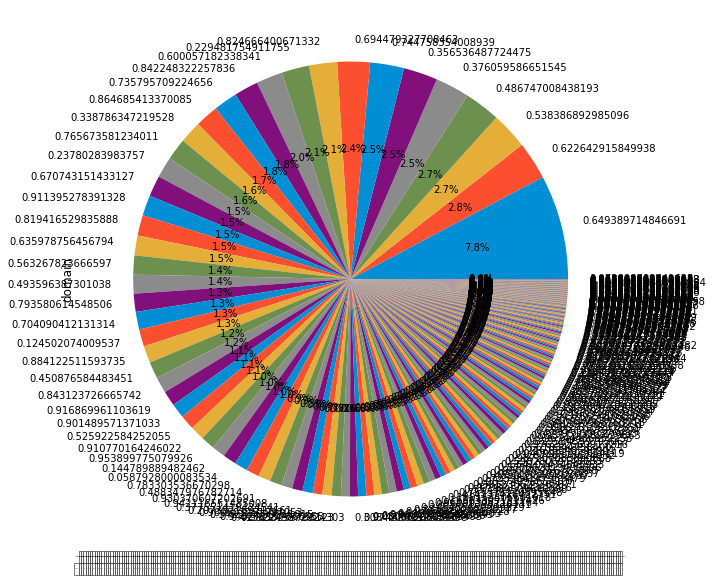

In [95]:
plt.figure(figsize=(10,10))
df.domain.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

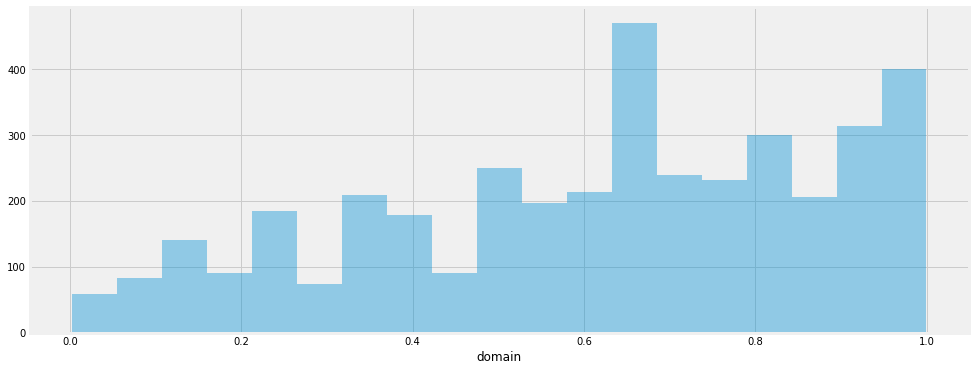

In [96]:
plt.figure(figsize=(15,6))
sns.distplot(df['domain'],kde=False)
plt.show()

### Normal Distribution

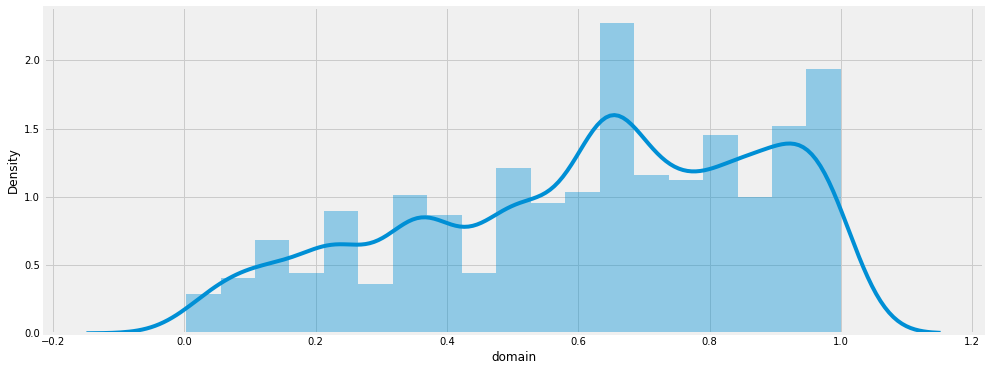


mean:  0.6126137837461042
median: 0.649389714846691
mode: 0    0.64939
dtype: float64

Skewness: -0.4273923743306388
Kurtosis: -0.8155214491788532



In [97]:
plt.figure(figsize=(15,6))
sns.distplot(df['domain'])
plt.show()
print()
print('mean: ',df['domain'].mean())
print('median:',df['domain'].median())
print('mode:',df['domain'].mode())
print()
print('Skewness:',skew(df['domain']))
print('Kurtosis:',kurtosis(df['domain']))
print()

### Box-Cox Transformation

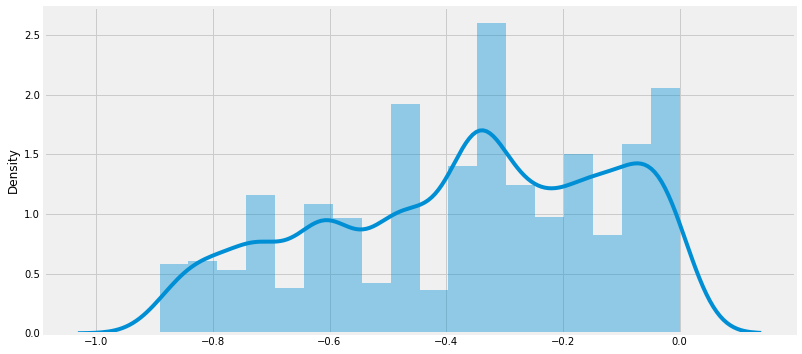



mean:  -0.3695757136094614
median: -0.342290884198647
mode: -0.342290884198647

Skewness: -0.3267332087832888
Kurtosis: -0.9352202496952535



In [98]:
plt.figure(figsize=(12,6))
transformed, _ = stats.boxcox(df['domain']) 
#plot the distribution of the transformed data values
sns.distplot(transformed)
plt.show()
print()
print()
print('mean: ',transformed.mean())
print('median:',np.median(transformed))
print('mode:',st.mode(transformed))
print()
print('Skewness:',skew(transformed))
print('Kurtosis:',kurtosis(transformed))
print()

### Box Plot

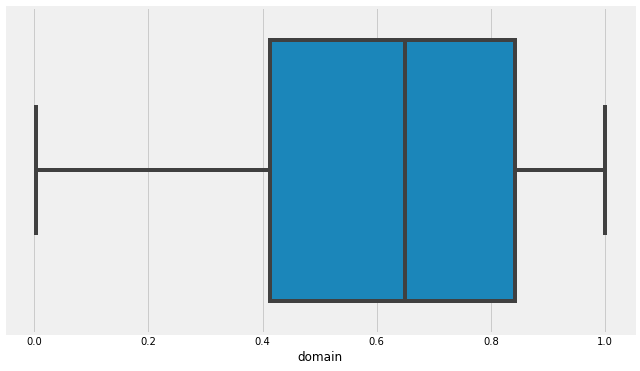

In [99]:
plt.figure(figsize=(10,6))
sns.boxplot(df['domain'])

## computerprogramming

### Count Plot

[445. 455. 395. 615. 645. 405. 735. 385. 485. 605. 495. 355. 515. 545.
 425. 525. 475. 565. 535. 335. 465. 415. 435. 155. 375. 555. 305. 315.
 804. 285. 575. 505. 195. 225. 595. 345. 275. 334. 365. 685. 655. 625.
 585. 665. 325. 235. 255. 205. 494. 695. 635. 215. 464. 295. 394. 245.
 715. 265. 135. 105. 524. 165. 175. 125. 675. 454. 745. 185. 214. 145.
 544. 725. 840. 404. 755. 705. 115. 554.]

****************************

455.0    991
445.0    148
435.0    143
475.0    139
465.0    130
        ... 
394.0      1
494.0      1
214.0      1
105.0      1
840.0      1
Name: computerprogramming, Length: 78, dtype: int64



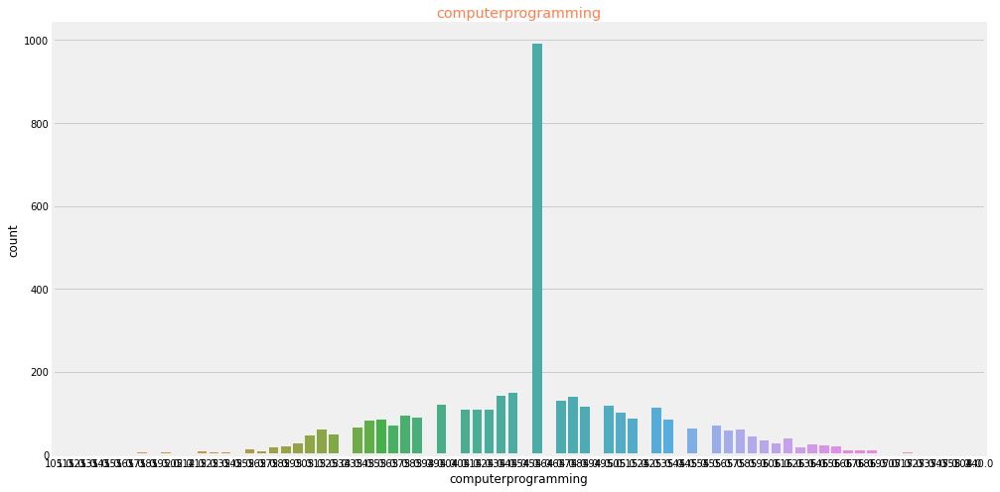

In [100]:
plt.figure(figsize=(15,8))
sns.countplot(df['computerprogramming'])
plt.title('computerprogramming',color='coral')
print(df['computerprogramming'].unique())
print()
print('****************************')
print()
print(df['computerprogramming'].value_counts())
print()

### Pie-Chart

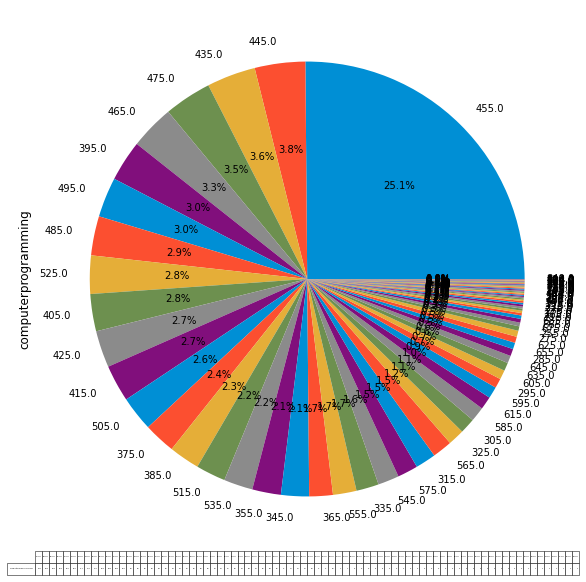

In [101]:
plt.figure(figsize=(10,10))
df.computerprogramming.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

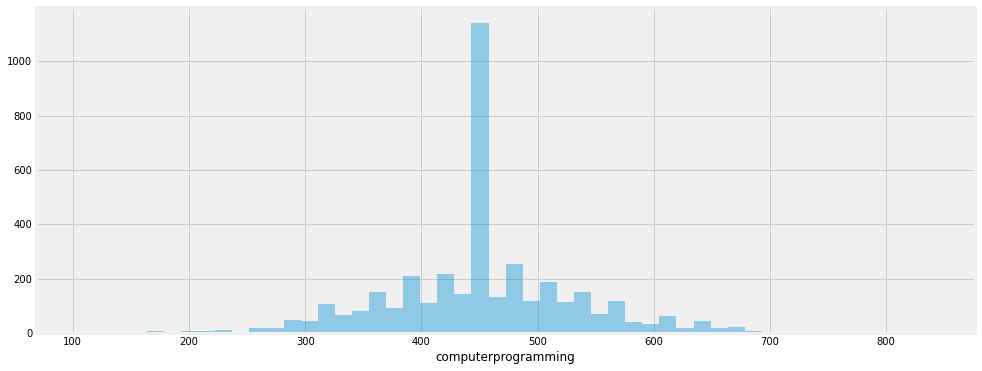

In [102]:
plt.figure(figsize=(15,6))
sns.distplot(df['computerprogramming'],kde=False)
plt.show()

### Normal Distribution

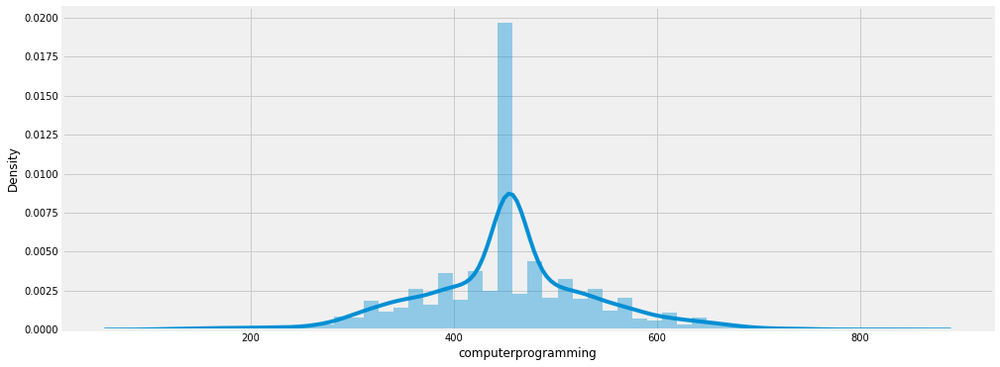


mean:  452.4494040071012
median: 455.0
mode: 0    455.0
dtype: float64

Skewness: -0.05798205848180069
Kurtosis: 1.3516228735002036



In [103]:
plt.figure(figsize=(15,6))
sns.distplot(df['computerprogramming'])
plt.show()
print()
print('mean: ',df['computerprogramming'].mean())
print('median:',df['computerprogramming'].median())
print('mode:',df['computerprogramming'].mode())
print()
print('Skewness:',skew(df['computerprogramming']))
print('Kurtosis:',kurtosis(df['computerprogramming']))
print()

### Box-Cox Transformation

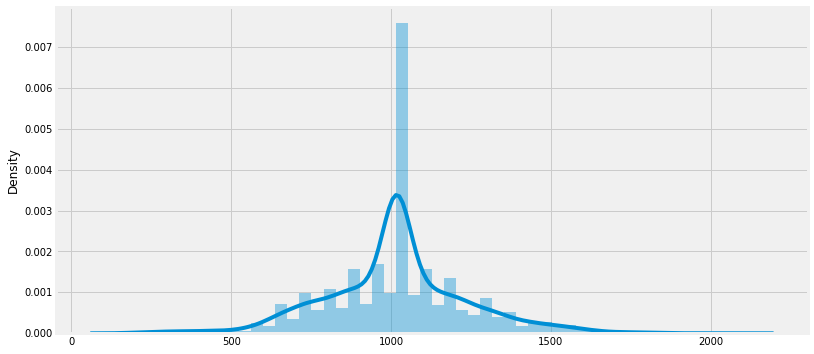



mean:  1015.3127721427364
median: 1018.5327746643538
mode: 1018.5327746643538

Skewness: 0.09926934160994656
Kurtosis: 1.2694973713707958



In [104]:
plt.figure(figsize=(12,6))
transformed, _ = stats.boxcox(df['computerprogramming']) 
#plot the distribution of the transformed data values
sns.distplot(transformed)
plt.show()
print()
print()
print('mean: ',transformed.mean())
print('median:',np.median(transformed))
print('mode:',st.mode(transformed))
print()
print('Skewness:',skew(transformed))
print('Kurtosis:',kurtosis(transformed))
print()

### Box Plot

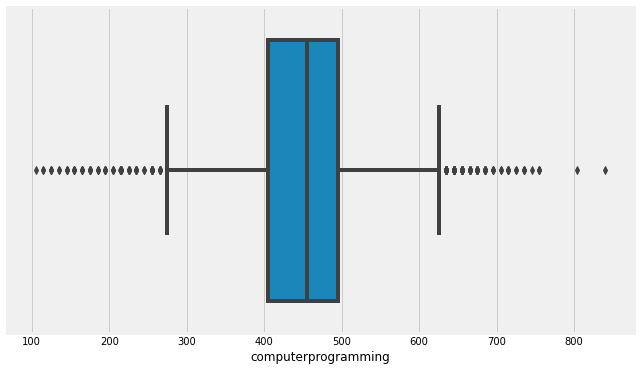

In [105]:
plt.figure(figsize=(10,6))
sns.boxplot(df['computerprogramming'])

## electronicsandsemicon

### Count Plot

[  0 466 233 366 324 266 333 356 420 260 228 388 300 292 433 196 200 164
 400 484 500 452 516 166 533 566 612 133 548]

****************************

0      2815
333     122
300     111
366     103
266      88
400      84
292      73
356      66
324      63
233      53
388      46
433      45
200      43
260      33
466      31
452      29
228      23
500      23
420      21
196      16
166      12
484      10
516       9
533       6
548       5
133       4
566       4
164       3
612       2
Name: electronicsandsemicon, dtype: int64



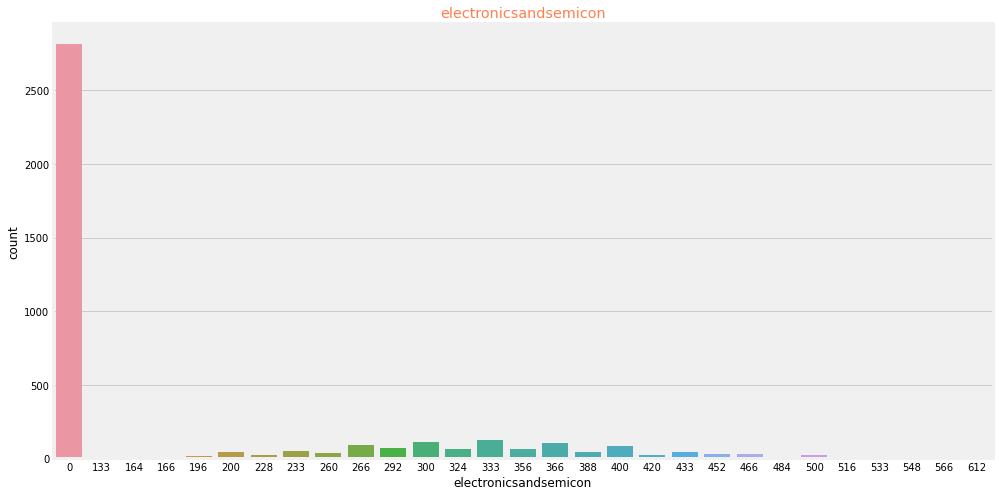

In [106]:
plt.figure(figsize=(15,8))
sns.countplot(df['electronicsandsemicon'])
plt.title('electronicsandsemicon',color='coral')
print(df['electronicsandsemicon'].unique())
print()
print('****************************')
print()
print(df['electronicsandsemicon'].value_counts())
print()

### Pie-Chart

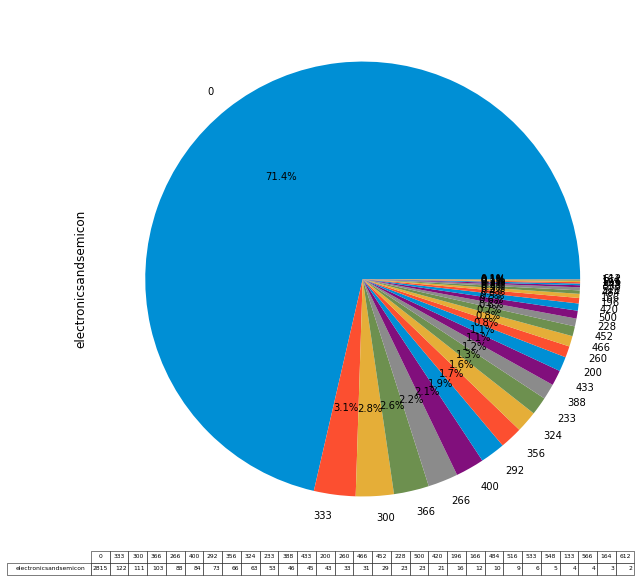

In [107]:
plt.figure(figsize=(10,10))
df.electronicsandsemicon.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

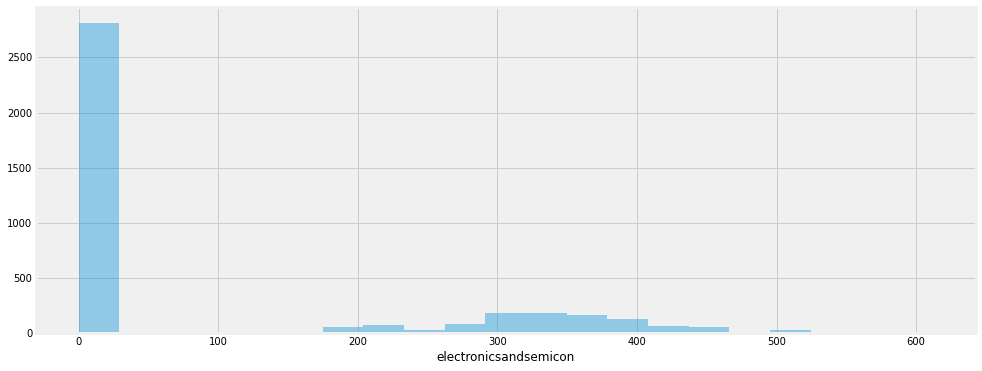

In [108]:
plt.figure(figsize=(15,6))
sns.distplot(df['electronicsandsemicon'],kde=False)
plt.show()

### Normal Distribution

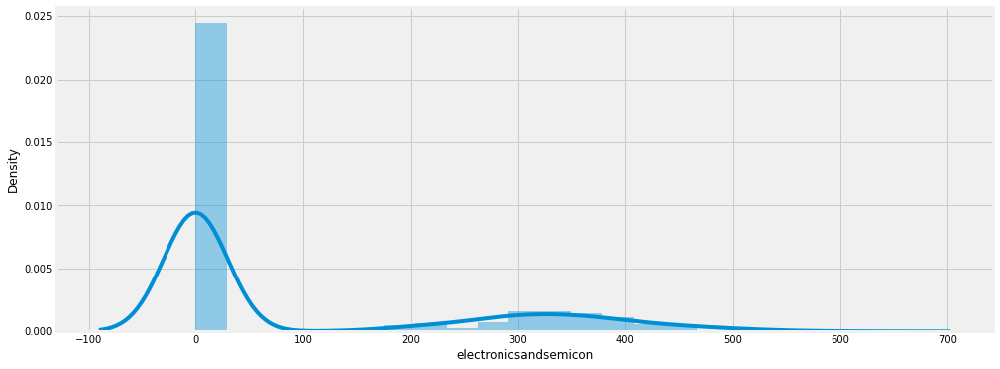


mean:  96.09383717981233
median: 0.0
mode: 0    0
dtype: int64

Skewness: 1.198162347113865
Kurtosis: -0.20301452201160952



In [109]:
plt.figure(figsize=(15,6))
sns.distplot(df['electronicsandsemicon'])
plt.show()
print()
print('mean: ',df['electronicsandsemicon'].mean())
print('median:',df['electronicsandsemicon'].median())
print('mode:',df['electronicsandsemicon'].mode())
print()
print('Skewness:',skew(df['electronicsandsemicon']))
print('Kurtosis:',kurtosis(df['electronicsandsemicon']))
print()

### Box Plot

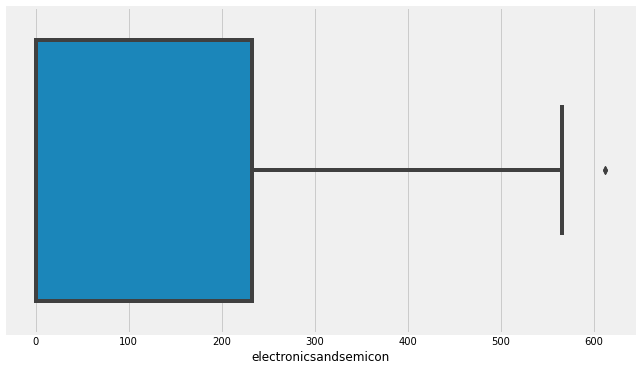

In [110]:
plt.figure(figsize=(10,6))
sns.boxplot(df['electronicsandsemicon'])

## computerscience

### Count Plot

[  0 407 346 376 500 438 315 253 469 192 530 284 223 561 684 592 623 653
 130 715]

****************************

0      3060
407     126
376     122
346     116
438     107
469      76
315      76
500      63
284      48
530      44
253      30
561      22
592      14
223      14
623      10
653       9
192       2
715       2
684       1
130       1
Name: computerscience, dtype: int64



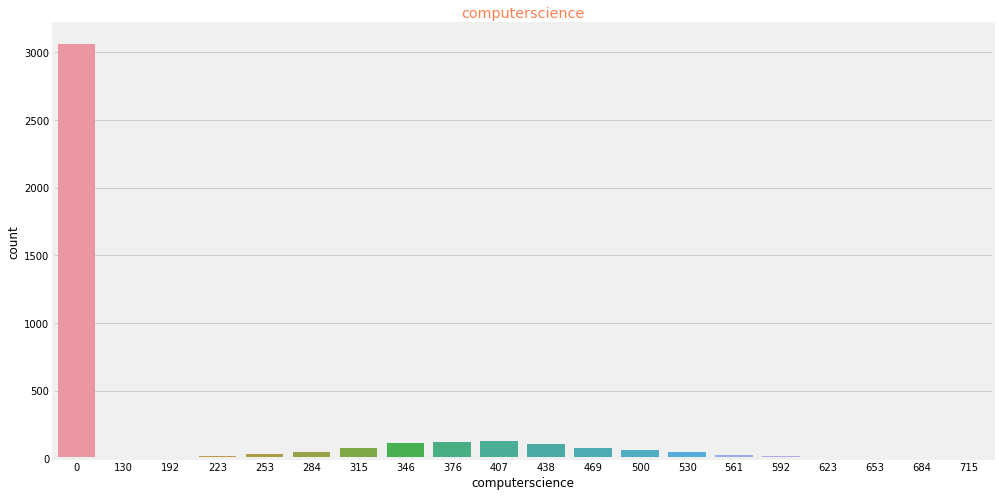

In [111]:
plt.figure(figsize=(15,8))
sns.countplot(df['computerscience'])
plt.title('computerscience',color='coral')
print(df['computerscience'].unique())
print()
print('****************************')
print()
print(df['computerscience'].value_counts())
print()

### Pie-Chart

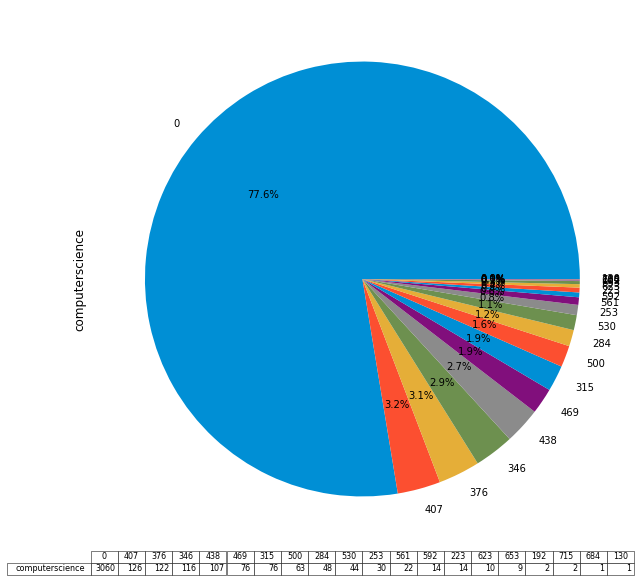

In [112]:
plt.figure(figsize=(10,10))
df.computerscience.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

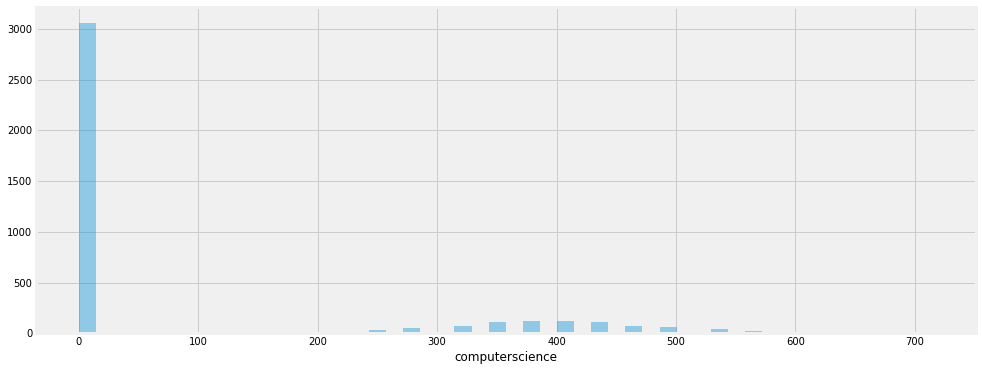

In [113]:
plt.figure(figsize=(15,6))
sns.distplot(df['computerscience'],kde=False)
plt.show()

### Normal Distribution

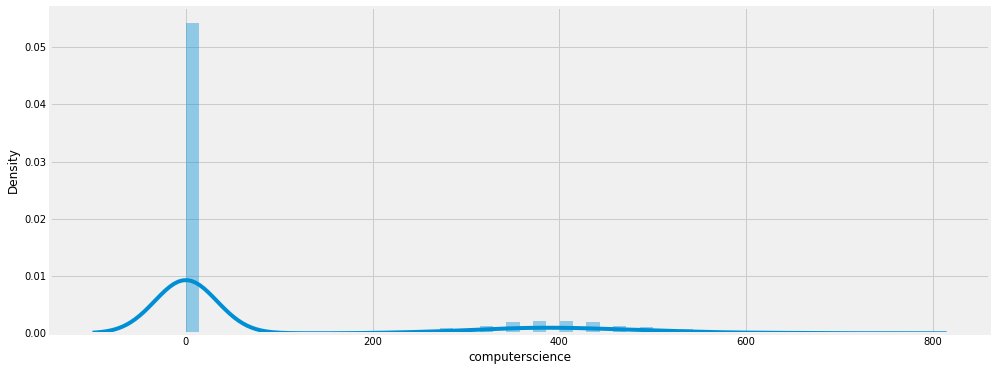


mean:  90.86203398427593
median: 0.0
mode: 0    0
dtype: int64

Skewness: 1.5425592840622206
Kurtosis: 0.7379970946858374



In [114]:
plt.figure(figsize=(15,6))
sns.distplot(df['computerscience'])
plt.show()
print()
print('mean: ',df['computerscience'].mean())
print('median:',df['computerscience'].median())
print('mode:',df['computerscience'].mode())
print()
print('Skewness:',skew(df['computerscience']))
print('Kurtosis:',kurtosis(df['computerscience']))
print()

### Box Plot

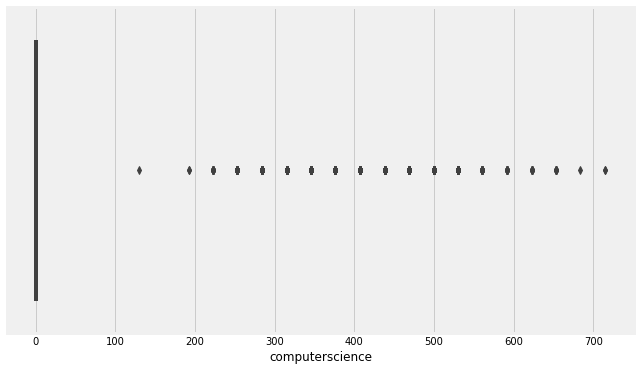

In [115]:
plt.figure(figsize=(10,6))
sns.boxplot(df['computerscience'])

## conscientiousness

### Count Plot

[ 0.9737 -0.7335  0.2718  0.0464 -0.881  -0.3027  1.7081 -0.0154 -0.159
 -1.308  -2.272   0.1282  0.3555  0.7027  1.7465  1.1336  0.8463  0.8192
 -0.1082 -1.0355 -0.4463  0.4155  0.99   -0.4173  1.5644 -0.4854 -1.0208
  0.3941 -0.8772  0.51   -0.5899 -2.5039  1.2828  0.335  -0.3014  1.8517
 -1.1644 -2.2351  0.6646 -0.2628 -1.8825 -1.4517  0.5591  1.4208 -0.7264
 -0.5116 -1.7389  0.2009 -0.0696 -2.5811 -2.3134  1.2772 -2.8879  1.4374
 -1.3447  0.1623  1.7156 -1.9629 -2.457   1.9953 -2.0262 -2.1175 -3.1994
 -2.7443 -1.4606  0.8578 -1.1901 -0.7651 -2.1698 -1.8083  1.592  -0.5719
 -0.9969 -1.3742 -1.4992 -1.5953 -3.6631  1.1283 -3.606   0.1788  0.2782
 -1.6538 -3.3539 -1.1128 -3.3188  0.4285  0.7419 -0.6491 -0.51   -0.5236
 -0.9653 -3.1752  0.7208  1.3215 -1.6924 -0.1855 -0.6749  0.2318  1.5533
  1.0768  1.3686 -0.5332 -0.2632 -1.2287 -1.5765  1.9011  1.0896  0.215
 -3.4624  0.3836 -3.0448  1.2056 -1.295  -2.7357 -0.0415 -2.6007  1.6692
  0.626  -2.4266 -2.1561 -2.8903 -4.1267  0.4034 -1.9

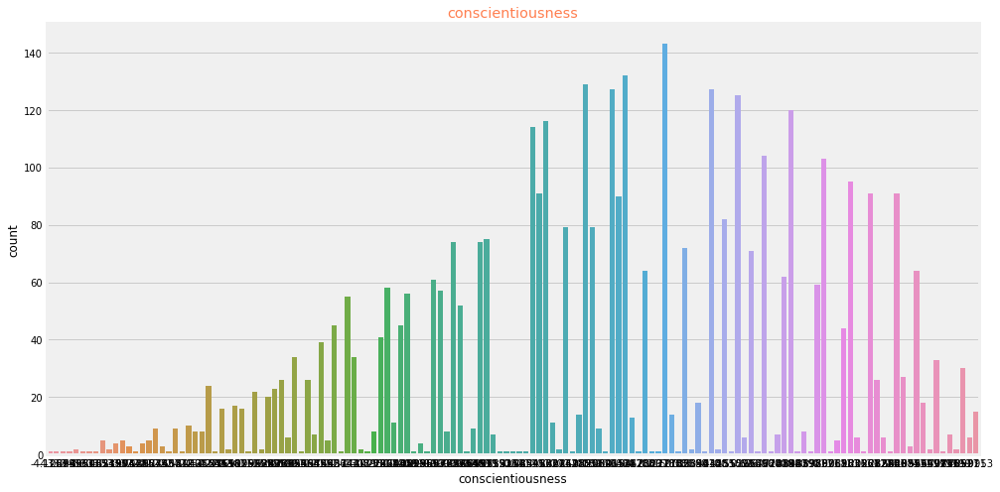

In [116]:
plt.figure(figsize=(15,8))
sns.countplot(df['conscientiousness'])
plt.title('conscientiousness',color='coral')
print(df['conscientiousness'].unique())
print()
print('****************************')
print()
print(df['conscientiousness'].value_counts())
print()

### Pie-Chart

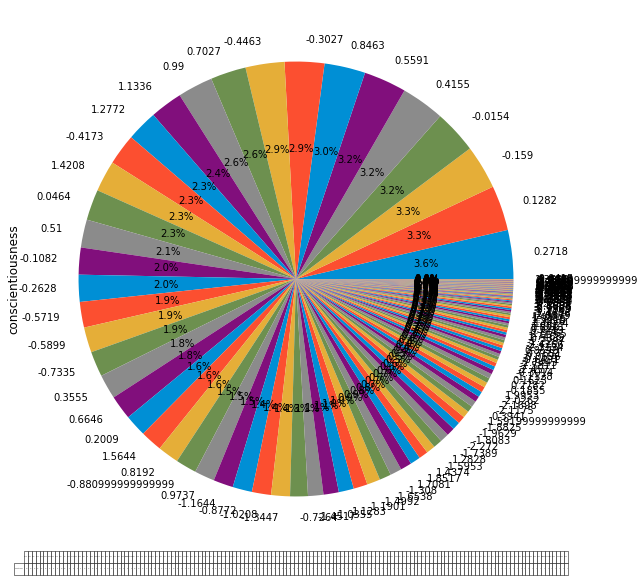

In [117]:
plt.figure(figsize=(10,10))
df.conscientiousness.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

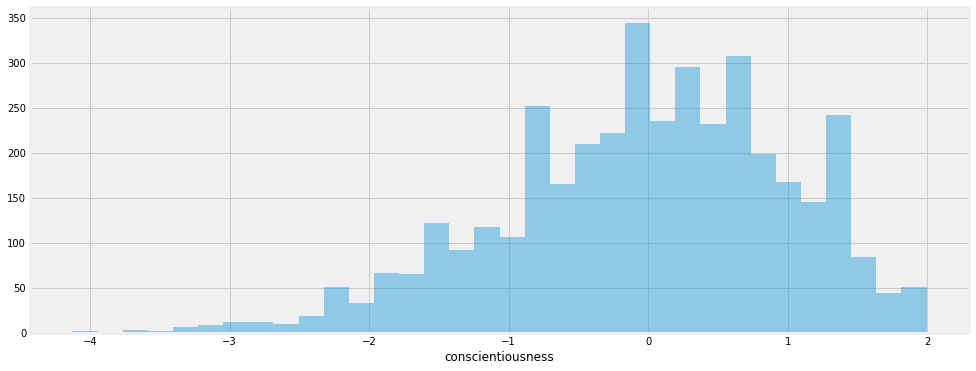

In [118]:
plt.figure(figsize=(15,6))
sns.distplot(df['conscientiousness'],kde=False)
plt.show()

### Normal Distribution

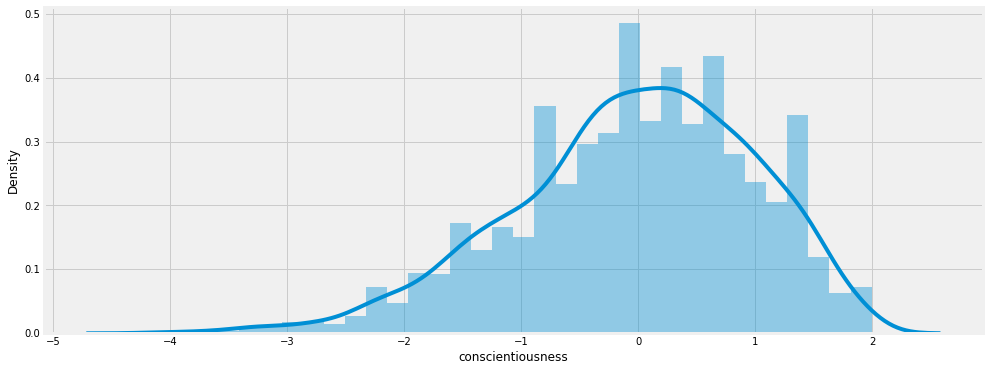


mean:  -0.039480091301039986
median: 0.0464
mode: 0    0.2718
dtype: float64

Skewness: -0.5231678772759043
Kurtosis: 0.11329096132004413



In [119]:
plt.figure(figsize=(15,6))
sns.distplot(df['conscientiousness'])
plt.show()
print()
print('mean: ',df['conscientiousness'].mean())
print('median:',df['conscientiousness'].median())
print('mode:',df['conscientiousness'].mode())
print()
print('Skewness:',skew(df['conscientiousness']))
print('Kurtosis:',kurtosis(df['conscientiousness']))
print()

### Box Plot

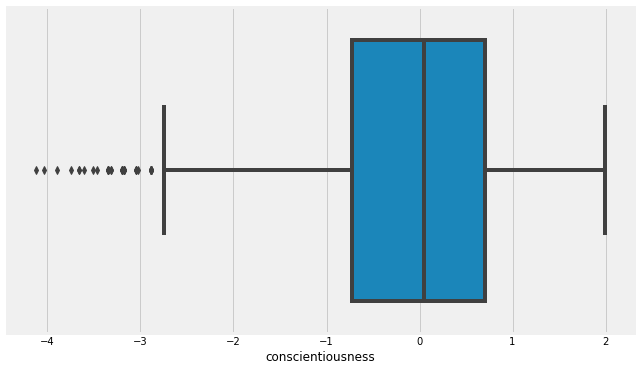

In [120]:
plt.figure(figsize=(10,6))
sns.boxplot(df['conscientiousness'])

## agreeableness

### Count Plot

[ 0.8128  0.3789  1.7109  0.3448 -0.2793 -0.6201 -0.1054  1.2114  0.5454
  1.1248  0.0328  0.7119  1.9048  1.0449  0.2668  0.9688 -0.5913 -2.1186
  0.8027  1.2028  0.1888  1.3779  0.6568 -0.4536 -0.5213  0.2124  1.2808
 -1.1196  0.2578 -2.4516  1.7488 -0.1206  0.0924 -0.0842 -0.4353  1.5444
 -0.9531 -2.6847 -0.1232 -3.7836  1.4368  0.8784 -1.4526  0.0459 -0.2871
  1.0858  1.7878 -0.7866  0.8229 -1.6191 -1.2861  0.6178 -0.2012  0.5008
 -0.9033  1.5538 -4.2831  0.8518  0.1498 -1.9953 -1.3713 -2.9314 -1.2153
 -0.7473 -0.5523 -1.0593  0.4934 -1.7856 -1.9521 -5.6151  1.5928 -0.6693
 -1.8855 -2.4633 -2.6193  0.7348 -0.8865 -1.6833  1.3198 -1.8393 -5.1156
 -0.3183  0.3731 -1.2543 -0.7993 -2.1903  0.7816  0.6009  0.3002 -3.6171
 -2.6181 -1.5273 -2.7754  1.5081 -2.1513 -2.2851  1.6708 -0.7863 -2.3073
 -3.4506 -0.3684  0.7135 -0.6867 -3.0874 -5.7816  0.3838  0.3123  0.1125
 -1.4859 -0.0873 -3.1176  0.4488  0.8993 -3.1264 -3.0094 -2.0733 -3.9501
 -2.9511 -1.7223 -0.1374 -4.7826 -1.0905 -0.6504  0

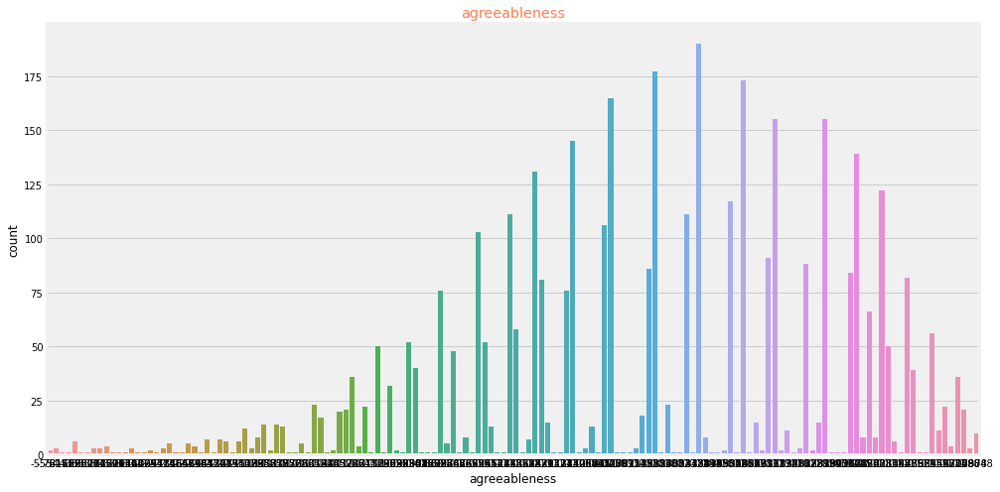

In [121]:
plt.figure(figsize=(15,8))
sns.countplot(df['agreeableness'])
plt.title('agreeableness',color='coral')
print(df['agreeableness'].unique())
print()
print('****************************')
print()
print(df['agreeableness'].value_counts())
print()

### Pie-Chart

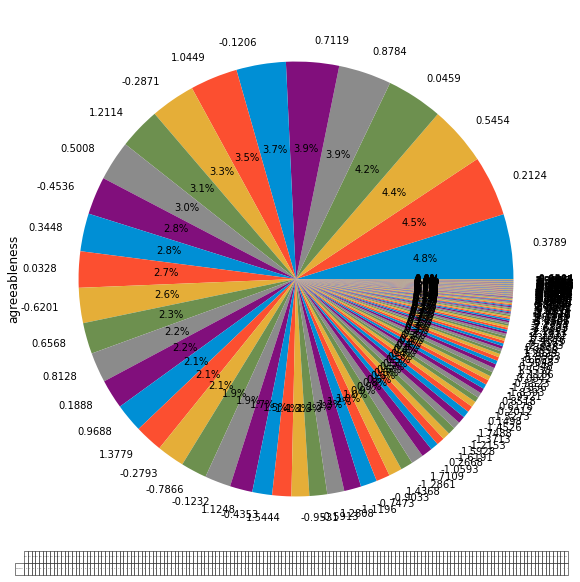

In [122]:
plt.figure(figsize=(10,10))
df.agreeableness.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

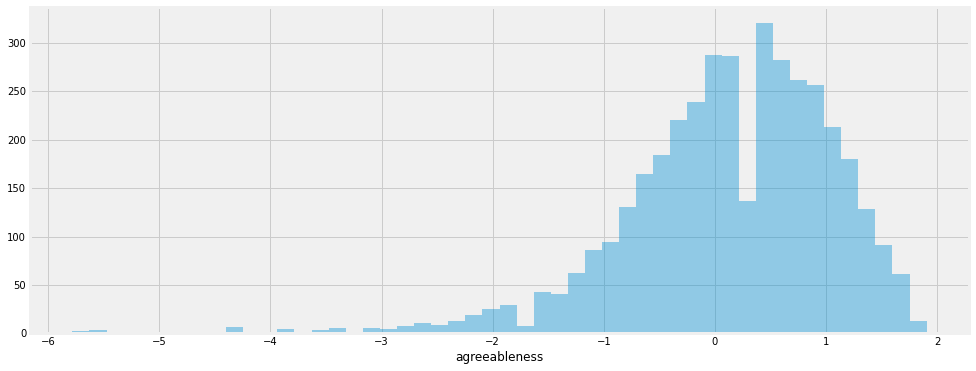

In [123]:
plt.figure(figsize=(15,6))
sns.distplot(df['agreeableness'],kde=False)
plt.show()

### Normal Distribution

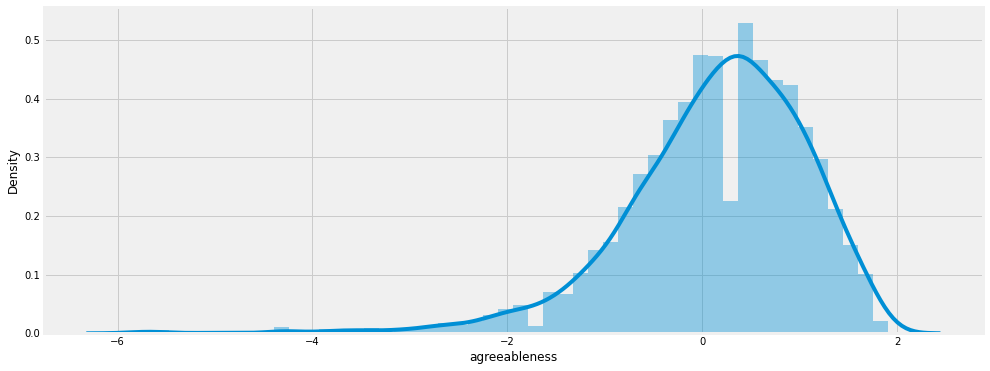


mean:  0.146107253360386
median: 0.2124
mode: 0    0.3789
dtype: float64

Skewness: -1.2103416389754558
Kurtosis: 3.4372827434375335



In [124]:
plt.figure(figsize=(15,6))
sns.distplot(df['agreeableness'])
plt.show()
print()
print('mean: ',df['agreeableness'].mean())
print('median:',df['agreeableness'].median())
print('mode:',df['agreeableness'].mode())
print()
print('Skewness:',skew(df['agreeableness']))
print('Kurtosis:',kurtosis(df['agreeableness']))
print()

### Box Plot

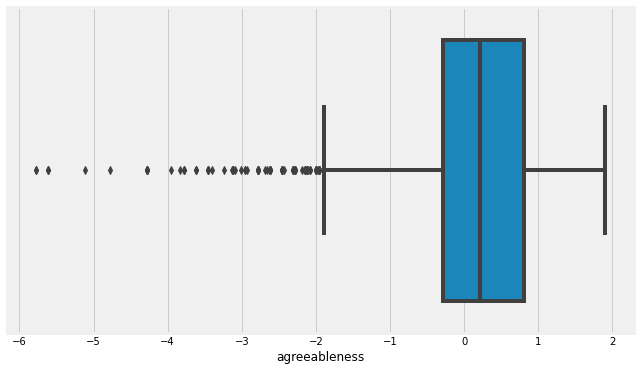

In [125]:
plt.figure(figsize=(10,6))
sns.boxplot(df['agreeableness'])

## extraversion

### Count Plot

[ 0.5269  1.2396  0.1637 -0.344  -1.0697 -2.2954 -1.0379  0.01   -0.6048
 -0.9122  0.0914  0.8171 -0.7585 -0.598   0.672   0.7785 -1.0659  1.3933
 -0.2714 -1.3599 -1.9881  0.1357 -0.9245 -1.7954 -0.0537  1.0859  0.3174
  2.1129  0.4711  0.6248  0.2366 -0.5349 -0.4511 -0.6343 -0.7794  0.3817
  1.8331 -2.2308 -0.6582 -0.2974 -2.6028 -2.4491 -1.2196  2.1617 -0.1988
 -0.4891  0.9322 -1.2148  1.7007  1.1437 -0.1437  1.8543  1.547   0.8809
 -1.6807  0.7083  0.5994  1.1074 -1.5776  0.9623 -1.8344 -1.5051 -0.1626
  0.926  -3.2176 -1.3733  1.2525 -1.4688 -2.1418  1.688   1.1558 -1.6502
  0.4906  1.5428 -1.527   1.9782 -1.9405  0.2113 -2.3759  0.2075 -2.0856
 -0.3803  0.2729 -4.6009 -1.2511 -0.0319  2.3154 -3.525  -0.8157 -0.6355
  0.6984  1.3977 -3.0639  2.1234  2.008  -2.3396 -1.9042  1.1804 -2.775
  0.73    0.164   0.0552 -0.824  -2.1219 -0.7068  1.4702  1.4267 -1.1422
 -1.6865 -0.2882 -2.6662  1.0348 -1.0334 -2.9565 -4.2935 -2.7565  0.065
 -0.1996 -3.537  -2.0131 -0.4226 -3.8636  1.5791 -0.1

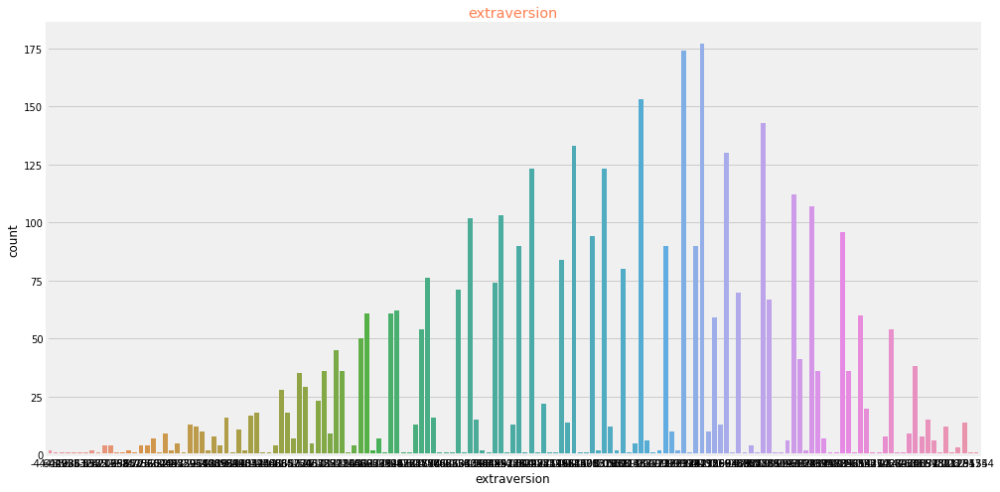

In [126]:
plt.figure(figsize=(15,8))
sns.countplot(df['extraversion'])
plt.title('extraversion',color='coral')
print(df['extraversion'].unique())
print()
print('****************************')
print()
print(df['extraversion'].value_counts())
print()

### Pie-Chart

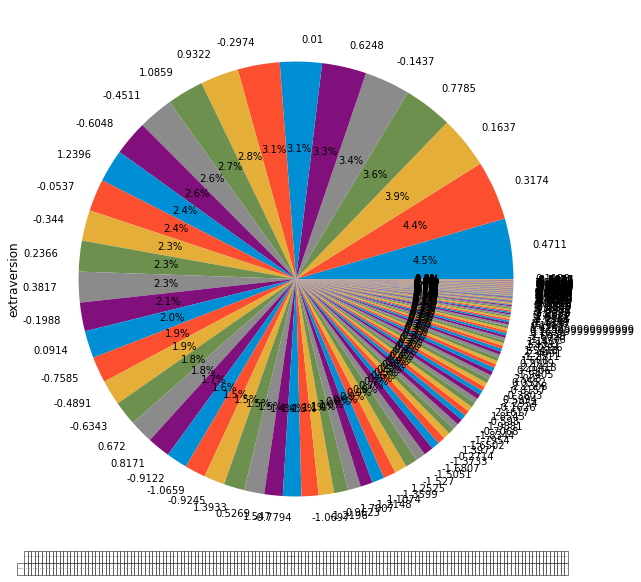

In [127]:
plt.figure(figsize=(10,10))
df.extraversion.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

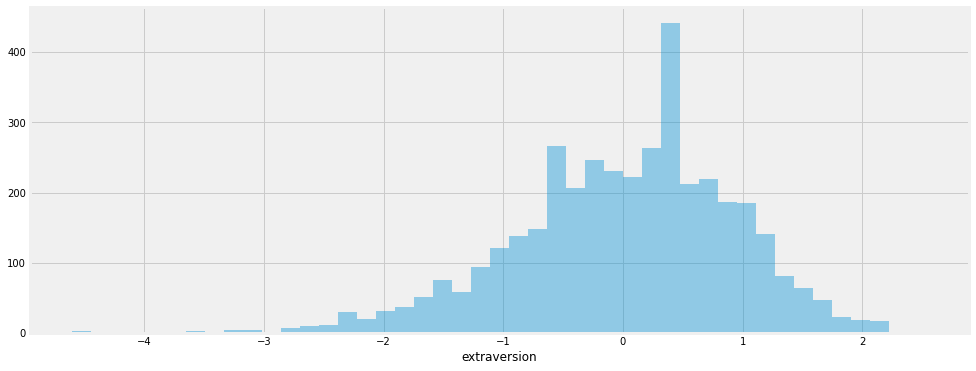

In [128]:
plt.figure(figsize=(15,6))
sns.distplot(df['extraversion'],kde=False)
plt.show()

### Normal Distribution

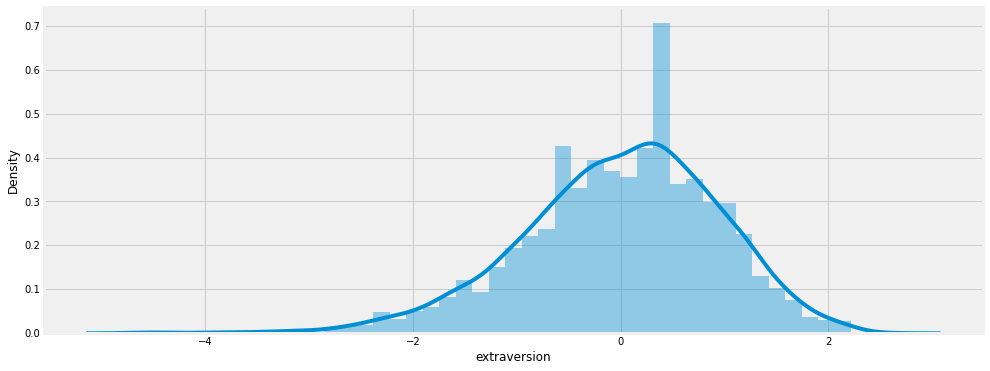


mean:  -0.0013557697184884122
median: 0.0914
mode: 0    0.4711
dtype: float64

Skewness: -0.521935005215946
Kurtosis: 0.6425895792228378



In [129]:
plt.figure(figsize=(15,6))
sns.distplot(df['extraversion'])
plt.show()
print()
print('mean: ',df['extraversion'].mean())
print('median:',df['extraversion'].median())
print('mode:',df['extraversion'].mode())
print()
print('Skewness:',skew(df['extraversion']))
print('Kurtosis:',kurtosis(df['extraversion']))
print()

### Box Plot

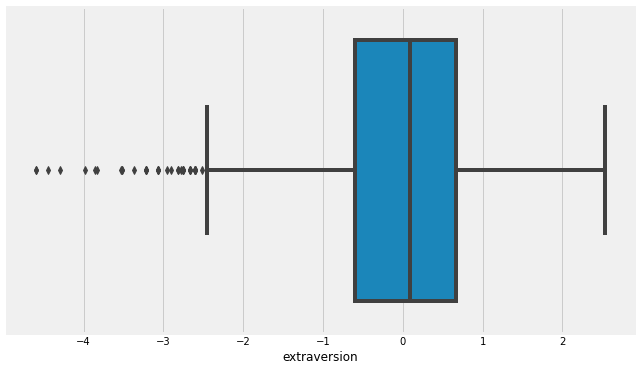

In [130]:
plt.figure(figsize=(10,6))
sns.boxplot(df['extraversion'])

## nueroticism

### Count Plot

[ 1.3549  -0.1076  -0.8682  -0.4078   0.09163 -0.7415  -2.0092   0.1459
  0.9066   0.1798  -0.995   -0.2902  -0.6147  -1.6289  -0.2344   0.06223
  0.7798  -0.4879   0.5323   1.8249  -0.3612  -1.2303  -1.5021   1.1601
 -1.8824  -0.735    0.2727  -2.1998  -1.2486  -1.1218   0.2973   1.7074
  0.26793 -2.2879   1.0024   0.653   -0.4821  -0.6428  -0.349    1.5404
  0.3995   0.6498   1.794    0.0192   1.0333   0.4148   0.8848  -0.7603
  0.88483 -0.5253   1.2869   1.4724  -0.8778  -0.1727   0.0035  -1.1128
  1.6672   0.64983  1.1199  -2.3895  -1.7556  -2.136    0.53233 -0.0552
 -0.26087  0.17983 -0.6134   0.219    0.5262   0.76733  0.00353 -1.3753
  0.0623  -0.29027  1.0611  -0.7015   2.6475   0.7673   1.4136   0.29733
  0.0917  -1.4653   0.7967   2.2949  -1.3478  -0.2609   1.5899  -0.05527
  2.1774   1.4297  -0.3414  -0.78967 -1.1422   2.301   -0.9953   0.9169
 -0.52527 -0.87777 -2.643   -0.40777 -0.01    -0.4371   1.58993  2.4278
  1.3255   2.9349   0.6204  -2.0529  -1.8179  -1.05407  2.059

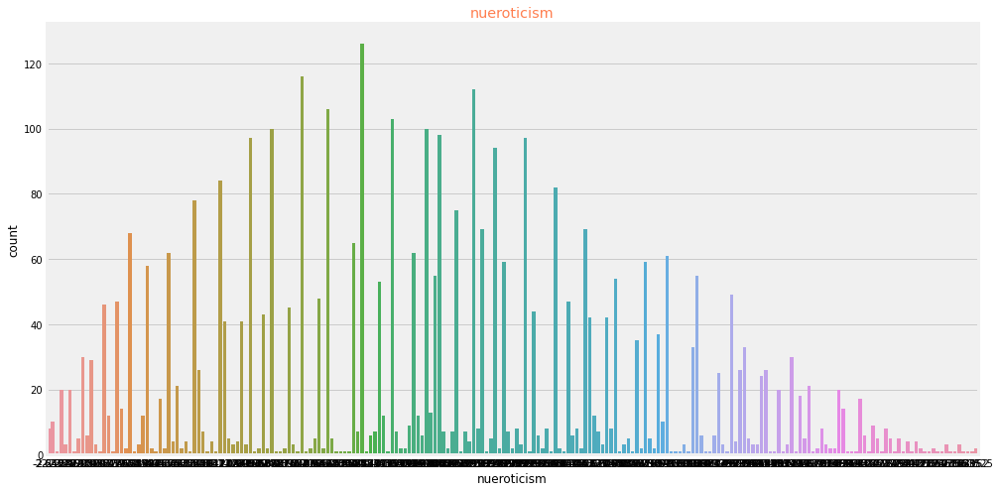

In [131]:
plt.figure(figsize=(15,8))
sns.countplot(df['nueroticism'])
plt.title('nueroticism',color='coral')
print(df['nueroticism'].unique())
print()
print('****************************')
print()
print(df['nueroticism'].value_counts())
print()

### Pie-Chart

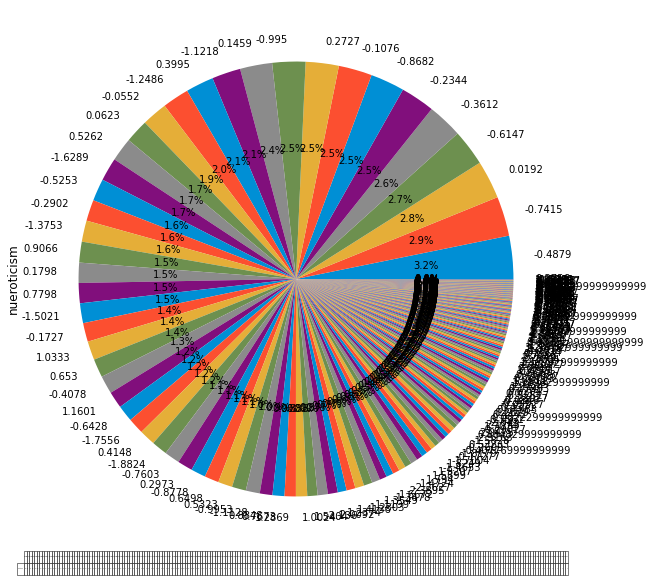

In [132]:
plt.figure(figsize=(10,10))
df.nueroticism.value_counts().plot(kind='pie',table = True,autopct='%1.1f%%')
plt.show()

### Histogram

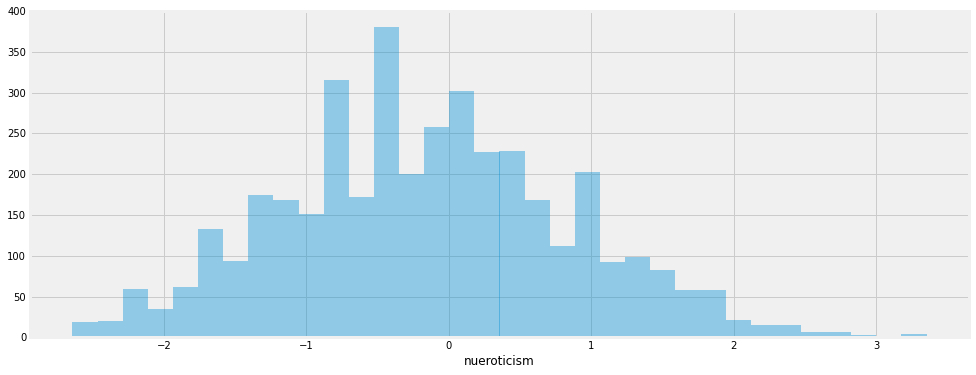

In [133]:
plt.figure(figsize=(15,6))
sns.distplot(df['nueroticism'],kde=False)
plt.show()

### Normal Distribution

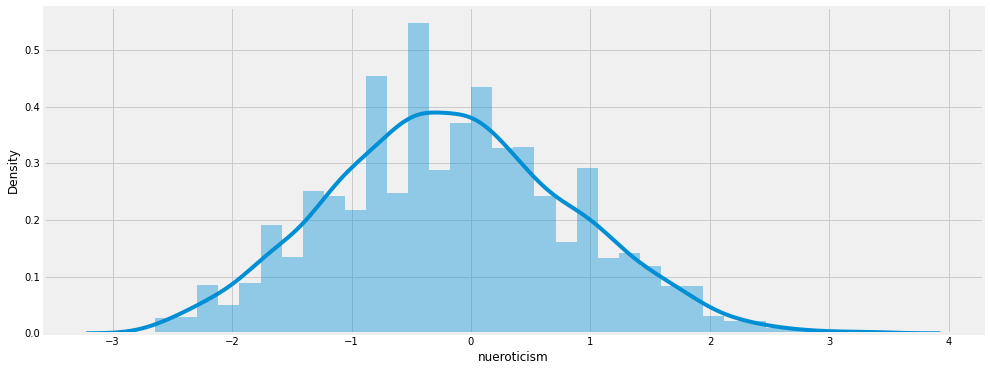


mean:  -0.17027791275678555
median: -0.2344
mode: 0   -0.4879
dtype: float64

Skewness: 0.1690209695876605
Kurtosis: -0.1983466746841338



In [134]:
plt.figure(figsize=(15,6))
sns.distplot(df['nueroticism'])
plt.show()
print()
print('mean: ',df['nueroticism'].mean())
print('median:',df['nueroticism'].median())
print('mode:',df['nueroticism'].mode())
print()
print('Skewness:',skew(df['nueroticism']))
print('Kurtosis:',kurtosis(df['nueroticism']))
print()

### Box Plot

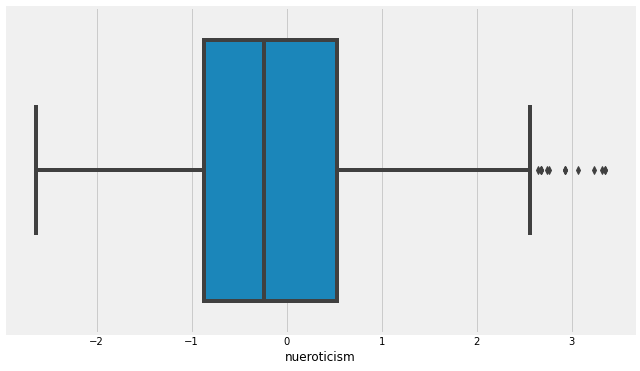

In [135]:
plt.figure(figsize=(10,6))
sns.boxplot(df['nueroticism'])

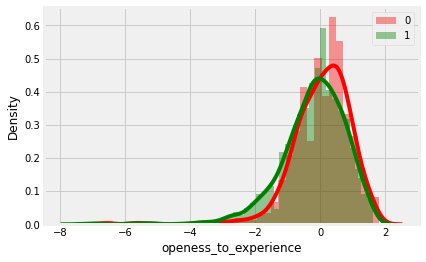

In [136]:
sns.distplot(df[df['gender']=='Female']['openess_to_experience'],color='r',label=0)
sns.distplot(df[df['gender']=='Male']['openess_to_experience'],color='g',label=1)
plt.legend()
plt.show()

# Bivariate Analysis

## Box Plot

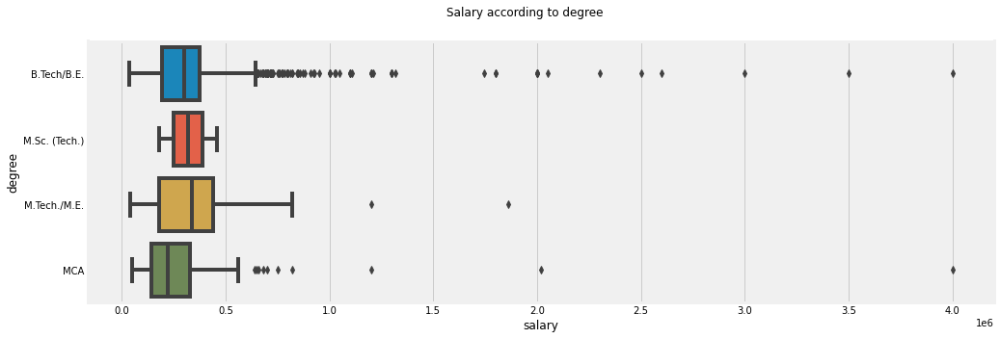

In [137]:
plt.figure(figsize=(15,5))
sns.boxplot(x='salary',y='degree',data=df)
plt.suptitle('Salary according to degree')
plt.show()

**Observation:  *B Tech Students*** are getting ***High Salary*** but ***M.Tech/M.E*** Students are getting ***high average Package*** than  other degree students

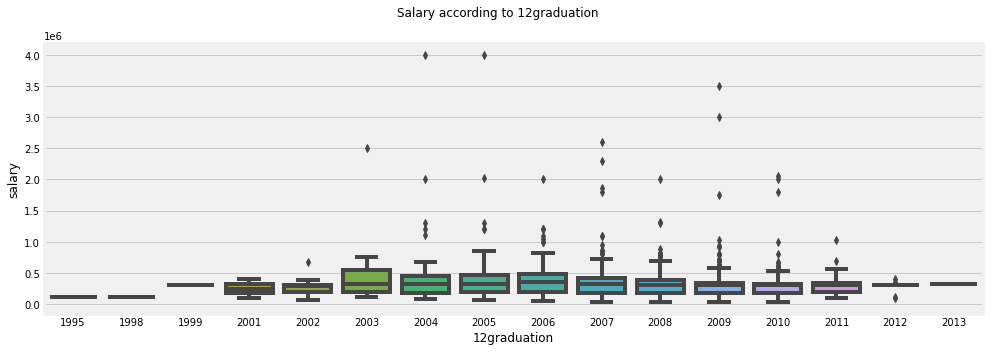

In [138]:
plt.figure(figsize=(15,5))
sns.boxplot(y='salary',x='12graduation',data=df)
plt.suptitle('Salary according to 12graduation')
plt.show()

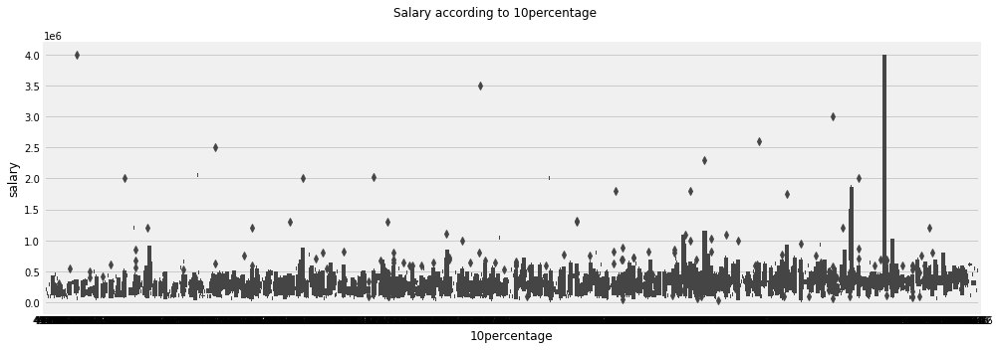

In [139]:
plt.figure(figsize=(15,5))
sns.boxplot(y='salary',x='10percentage',data=df)
plt.suptitle('Salary according to 10percentage')
plt.show()

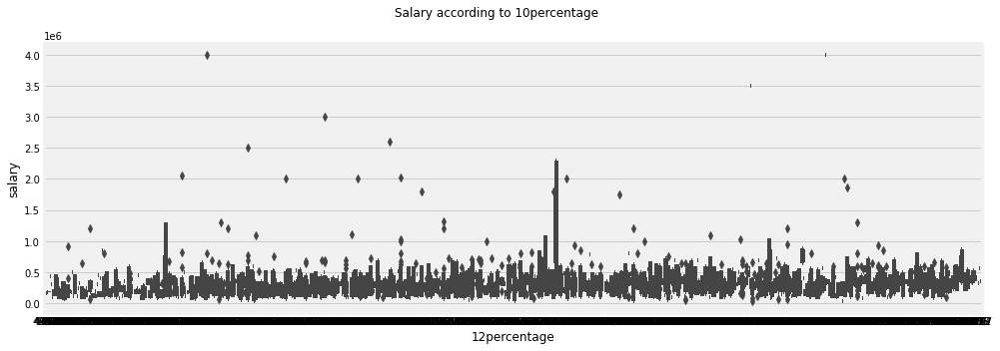

In [140]:
plt.figure(figsize=(15,5))
sns.boxplot(y='salary',x='12percentage',data=df)
plt.suptitle('Salary according to 10percentage')
plt.show()

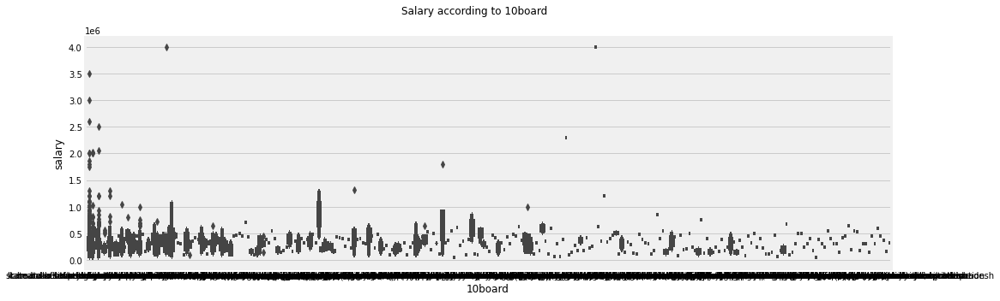

In [141]:
plt.figure(figsize=(15,5))
sns.boxplot(y='salary',x='10board',data=df)
plt.suptitle('Salary according to 10board')
plt.show()

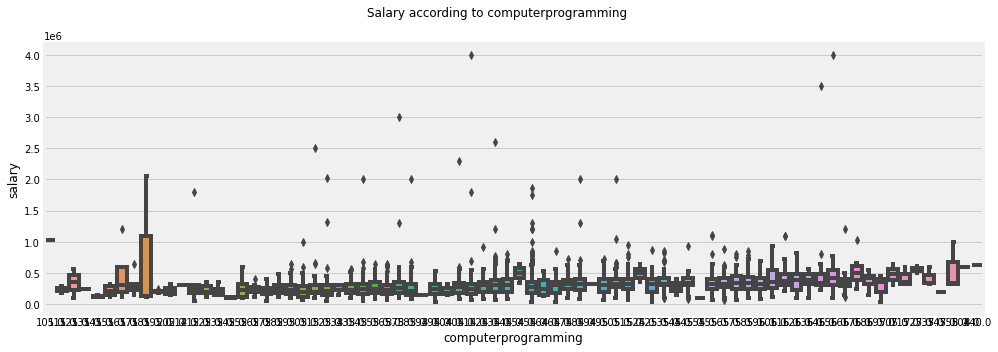

In [142]:
plt.figure(figsize=(15,5))
sns.boxplot(y='salary',x='computerprogramming',data=df)
plt.suptitle('Salary according to computerprogramming')
plt.show()

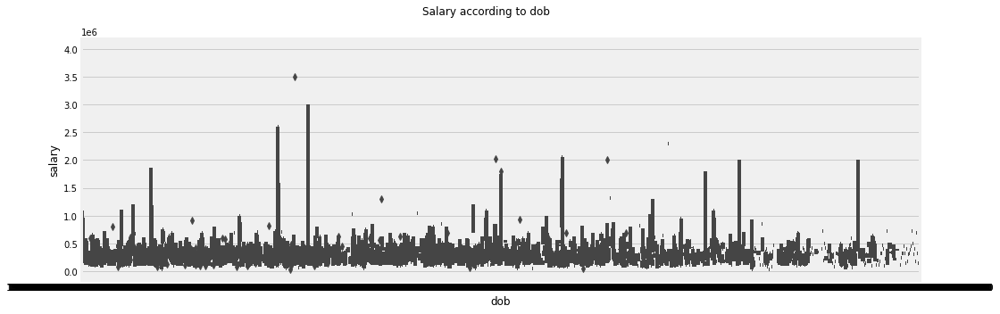

In [143]:
plt.figure(figsize=(15,5))
sns.boxplot(y='salary',x='dob',data=df)
plt.suptitle('Salary according to dob')
plt.show()

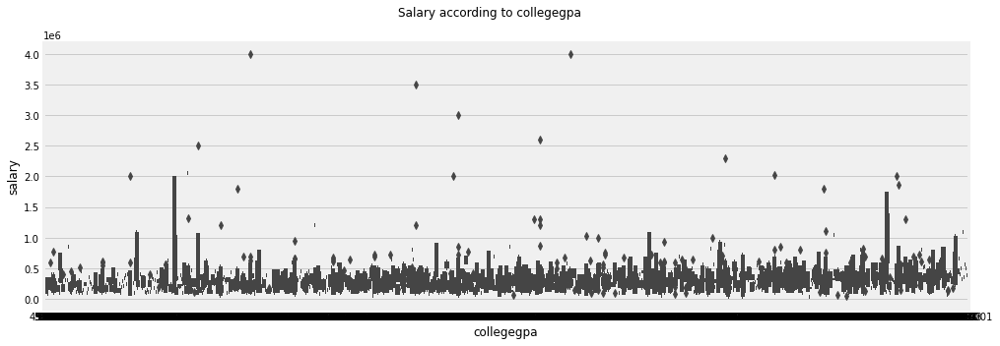

In [144]:
plt.figure(figsize=(15,5))
sns.boxplot(y='salary',x='collegegpa',data=df)
plt.suptitle('Salary according to collegegpa')
plt.show()

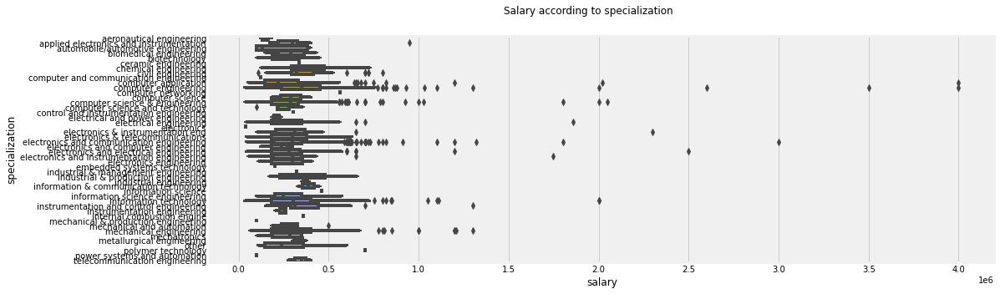

In [145]:
plt.figure(figsize=(15,5))
sns.boxplot(x='salary',y='specialization',data=df)
plt.suptitle('Salary according to specialization')
plt.show()

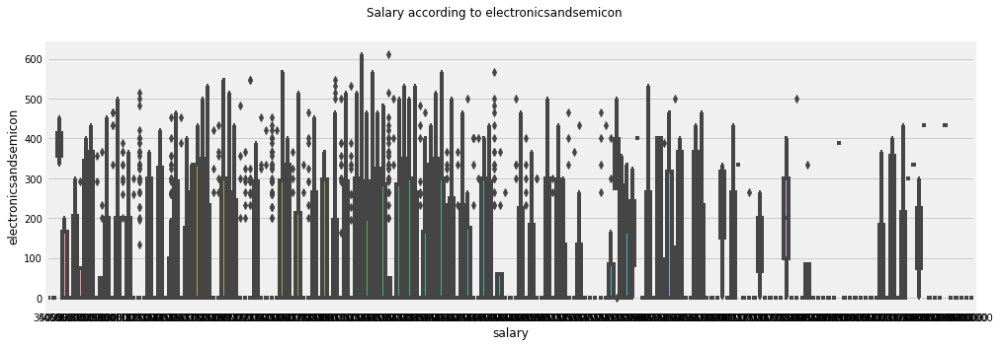

In [146]:
plt.figure(figsize=(15,5))
sns.boxplot(x='salary',y='electronicsandsemicon',data=df)
plt.suptitle('Salary according to electronicsandsemicon')
plt.show()

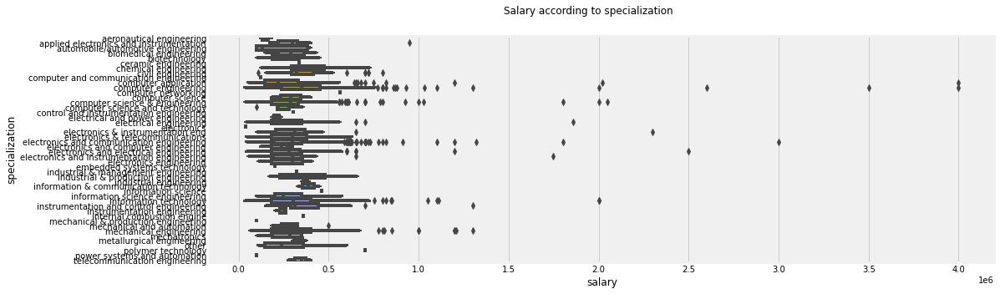

In [147]:
plt.figure(figsize=(15,5))
sns.boxplot(x='salary',y='specialization',data=df)
plt.suptitle('Salary according to specialization')
plt.show()

## Pair Plot

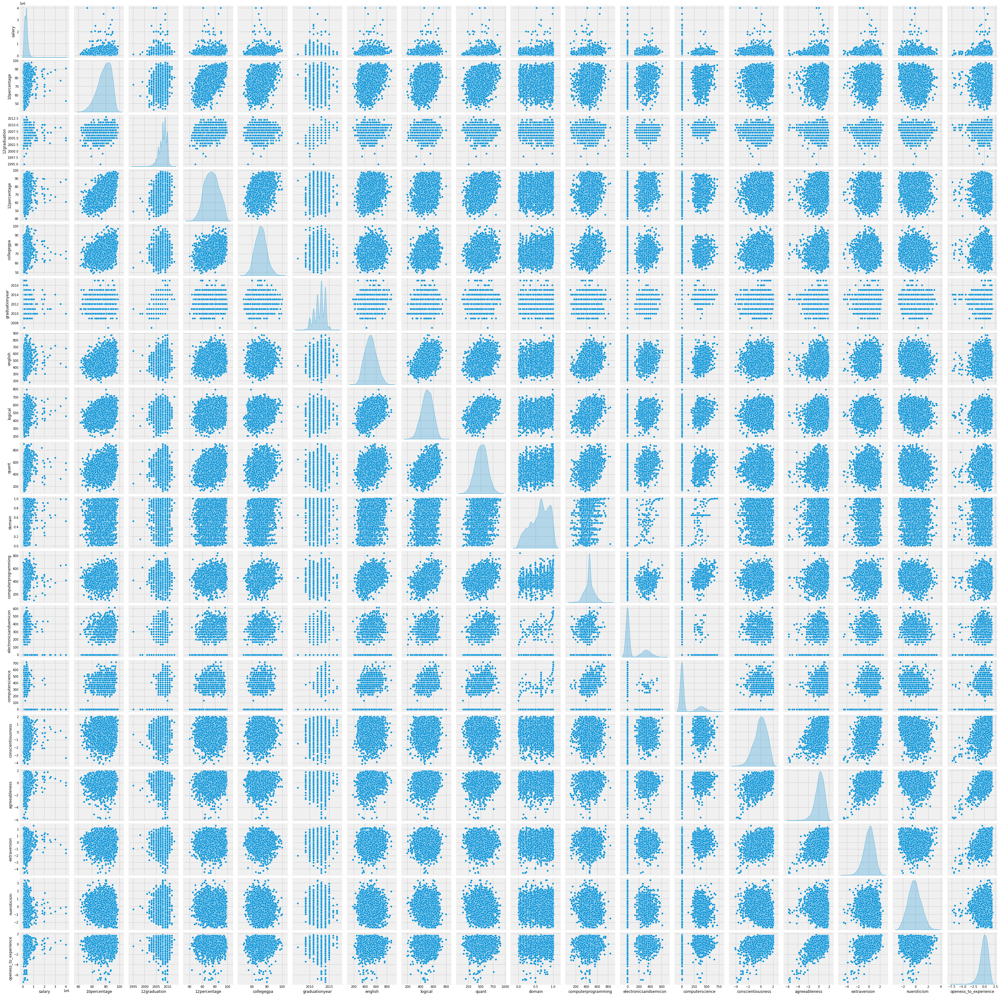

In [148]:
sns.pairplot(df,diag_kind='kde')

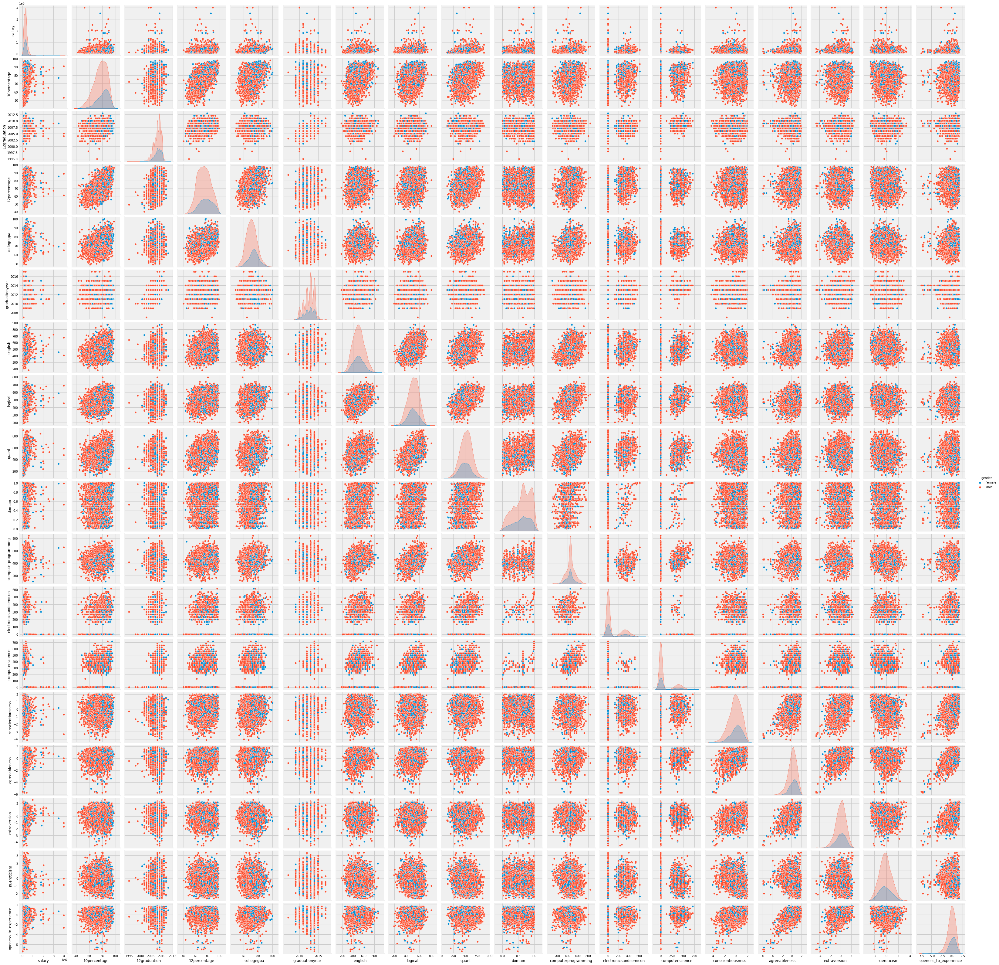

In [149]:
sns.pairplot(data = df,hue='gender')

## hexbin plot


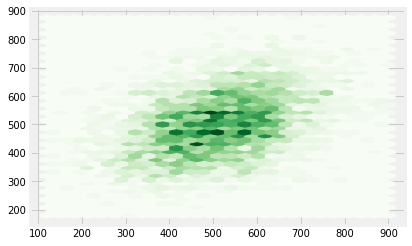

In [150]:
plt.hexbin(x=df.quant, y=df.english, gridsize=(25,25), cmap=plt.cm.Greens)

## Line Plot

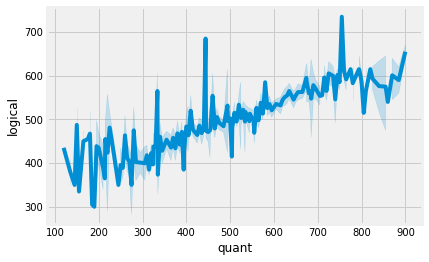

In [151]:
sns.lineplot(x = df['quant'], y = df['logical'])

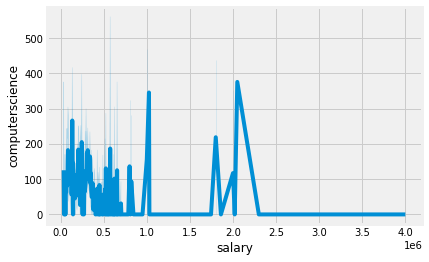

In [152]:
sns.lineplot(x = df['salary'], y = df['computerscience'])

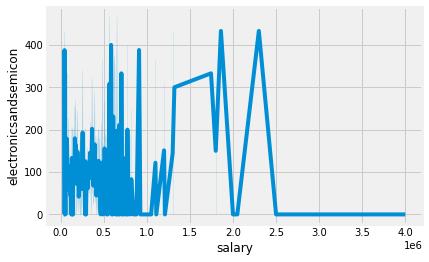

In [153]:
sns.lineplot(x = df['salary'], y = df['electronicsandsemicon'])

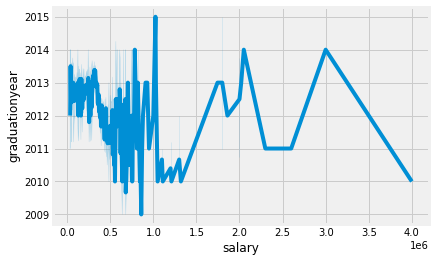

In [154]:
sns.lineplot(x = df['salary'], y = df['graduationyear'])

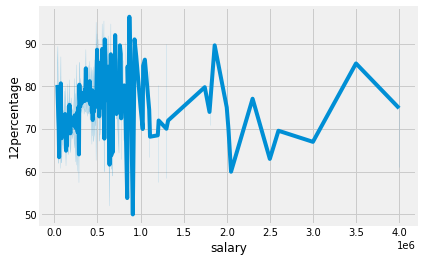

In [155]:
sns.lineplot(x = df['salary'], y = df['12percentage'])

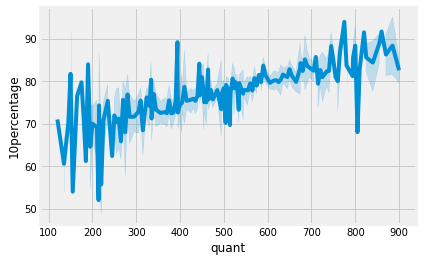

In [156]:
sns.lineplot(x = df['quant'], y = df['10percentage'])

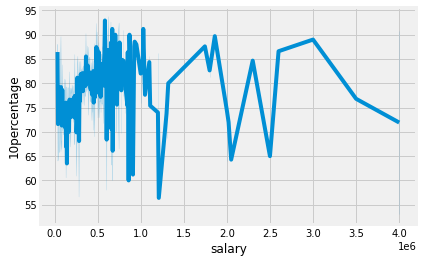

In [157]:
sns.lineplot(x = df['salary'], y = df['10percentage'])

## Joint Plot

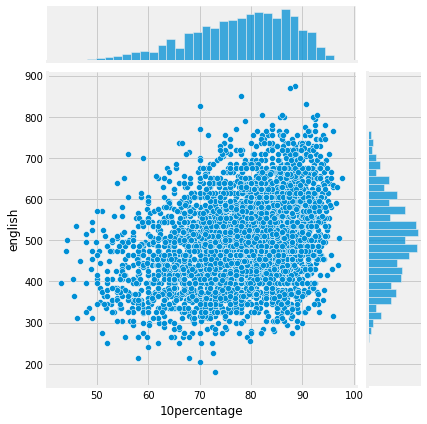

In [158]:
sns.jointplot(x='10percentage',y='english',data=df)

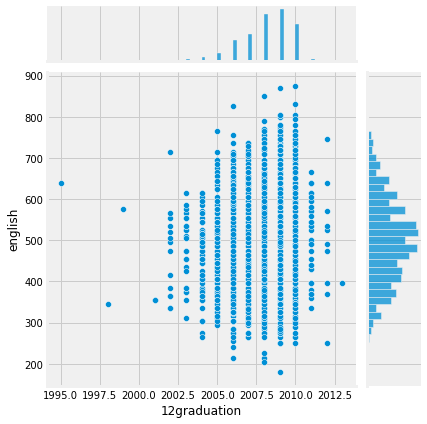

In [159]:
sns.jointplot(x='12graduation',y='english',data=df)

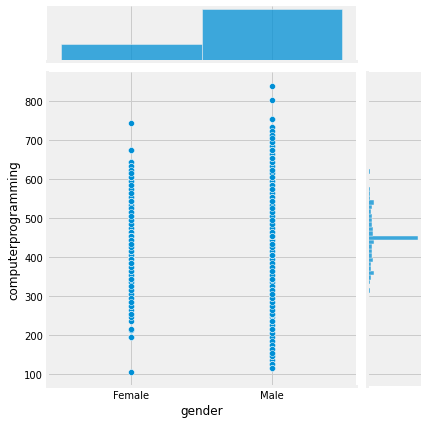

In [160]:
sns.jointplot(x='gender',y='computerprogramming',data=df)

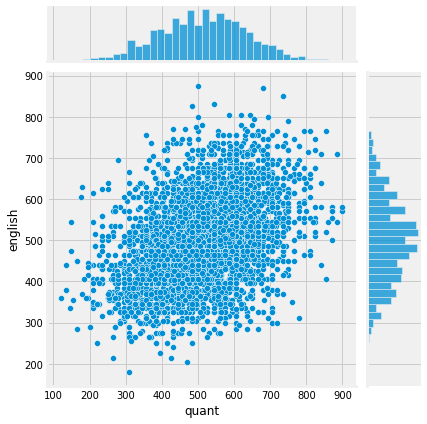

In [161]:
sns.jointplot(x=df.quant, y=df.english,data=df)

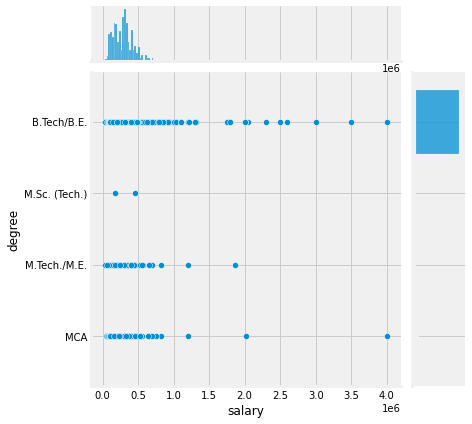

In [162]:
sns.jointplot(x='salary',y='degree',data=df)

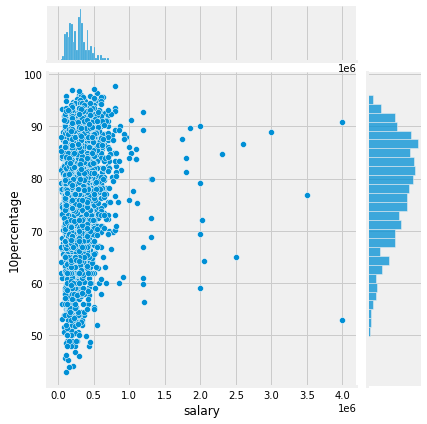

In [163]:
sns.jointplot(x='salary',y='10percentage',data=df)

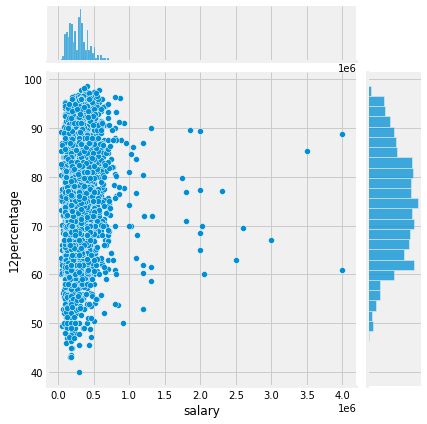

In [164]:
sns.jointplot(x='salary',y='12percentage',data=df)

## Swarm Plot

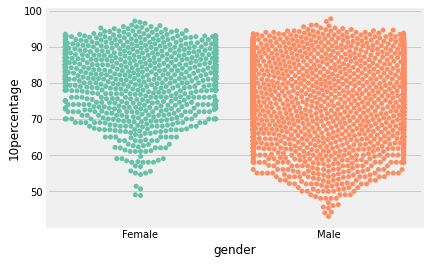

In [165]:
sns.swarmplot(x='gender',y='10percentage',data=df,palette='Set2')

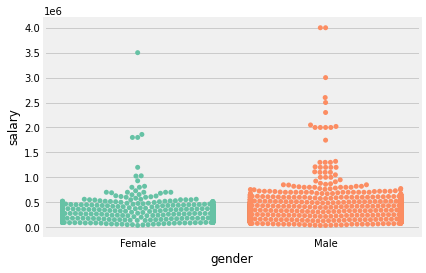

In [166]:
sns.swarmplot(x='gender',y='salary',data=df,palette='Set2')

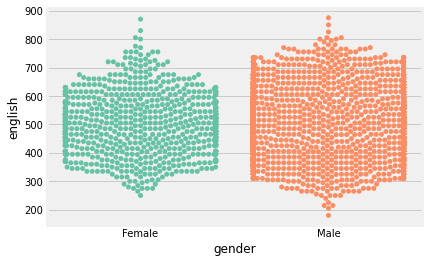

In [167]:
sns.swarmplot(x='gender',y='english',data=df,palette='Set2')

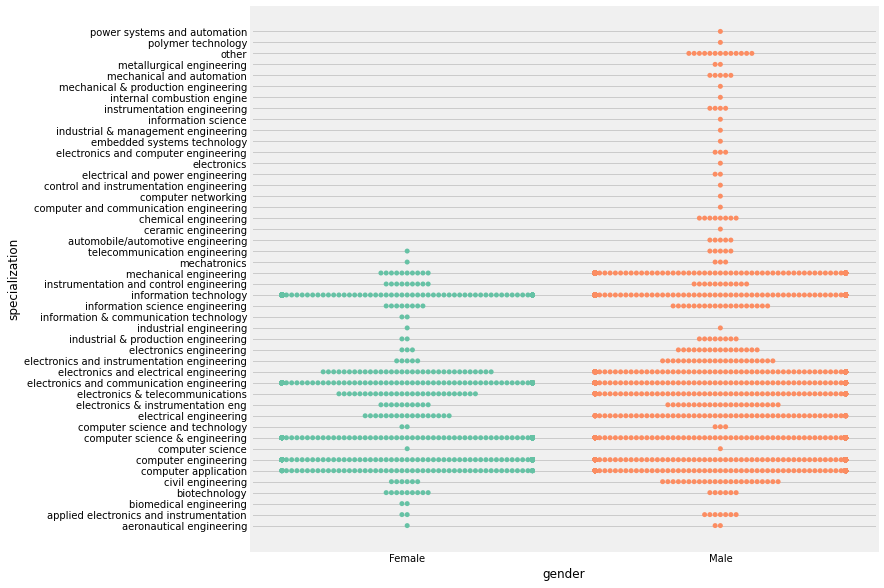

In [168]:
plt.figure(figsize=(10,10))
sns.swarmplot(x='gender',y='specialization',data=df,palette='Set2')

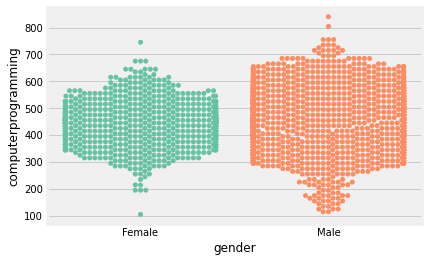

In [169]:
sns.swarmplot(x='gender',y='computerprogramming',data=df,palette='Set2')

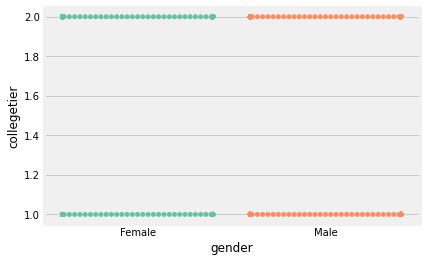

In [170]:
sns.swarmplot(x='gender',y='collegetier',data=df,palette='Set2')

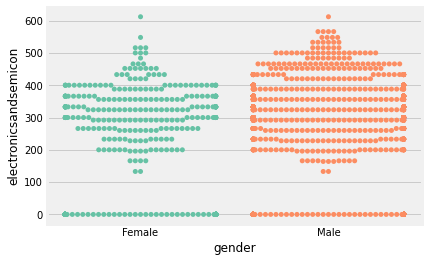

In [171]:
sns.swarmplot(x='gender',y='electronicsandsemicon',data=df,palette='Set2')

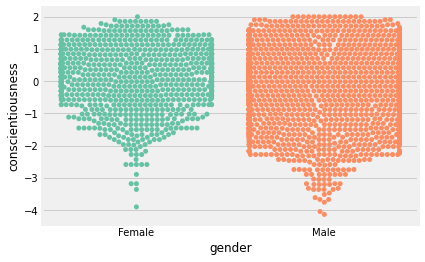

In [172]:
sns.swarmplot(x='gender',y='conscientiousness',data=df,palette='Set2')

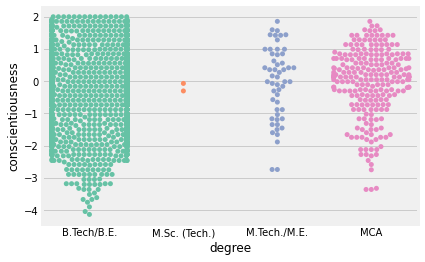

In [173]:
sns.swarmplot(x='degree',y='conscientiousness',data=df,palette='Set2')

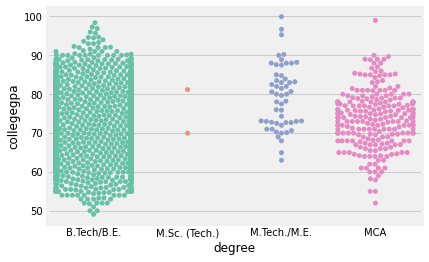

In [174]:
sns.swarmplot(x='degree',y='collegegpa',data=df,palette='Set2')

## Cat Plot

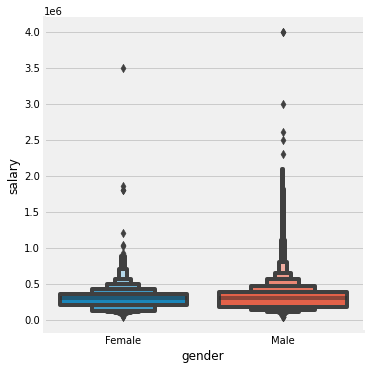

In [178]:
sns.catplot(x="gender", y="salary", kind="boxen",data=df)

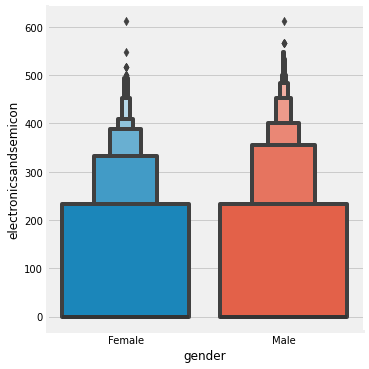

In [179]:
sns.catplot(x="gender", y="electronicsandsemicon", kind="boxen",data=df)

## Heat Map

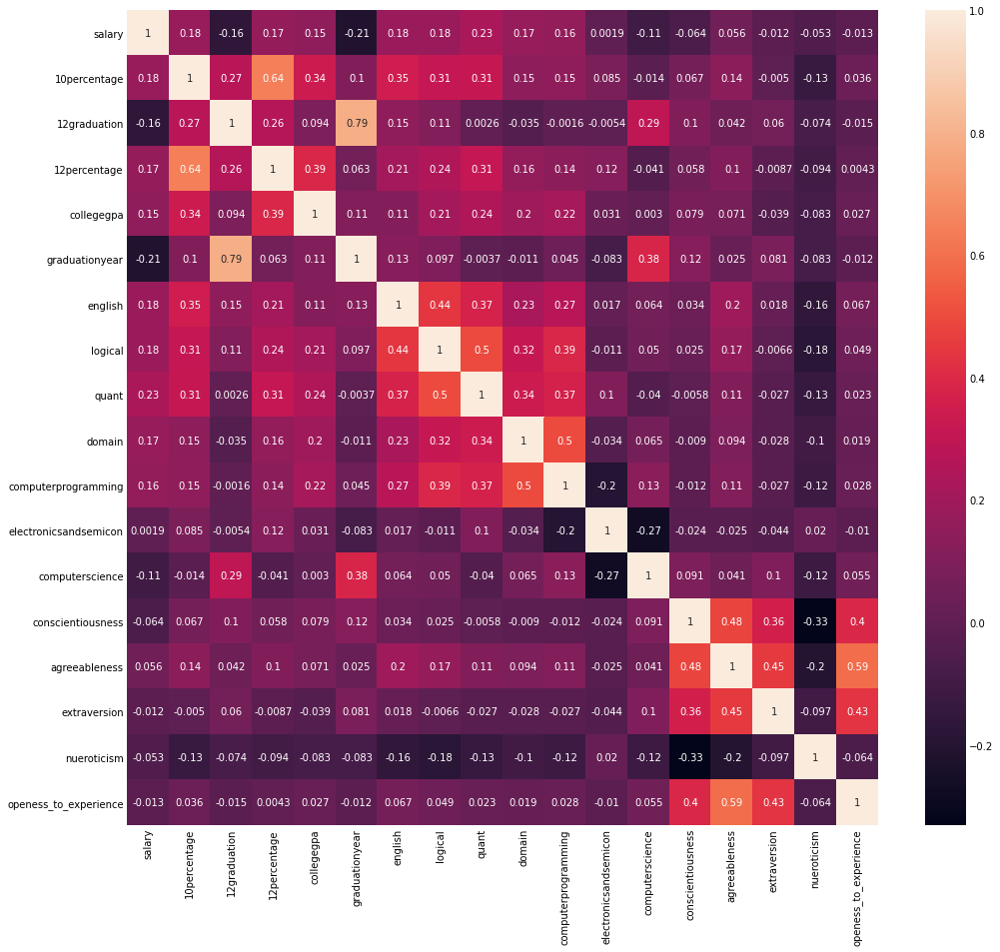

In [192]:
plt.figure(figsize=(15,15))
corrMatrix1 = df.corr()
sns.heatmap(corrMatrix1, annot=True)

# Feature Transformation

In [182]:
cat_feat=['specialization','gender','degree','12board','10board']
mod_df= pd.get_dummies(df,columns=cat_feat)
print(mod_df)

       salary        doj        dol                  designation  \
0      420000 2012-06-01 2015-12-31      senior quality engineer   
1      500000 2013-09-01 2015-12-31            assistant manager   
2      325000 2014-06-01 2015-12-31             systems engineer   
3     1100000 2011-07-01 2015-12-31     senior software engineer   
4      200000 2014-03-01 2015-03-01                          get   
...       ...        ...        ...                          ...   
3992   800000 2014-04-01 2015-04-01                      manager   
3993   280000 2011-10-01 2012-10-01            software engineer   
3995   320000 2013-07-01 2015-12-31  associate software engineer   
3996   200000 2014-07-01 2015-01-01           software developer   
3997   400000 2013-02-01 2015-12-31      senior systems engineer   

               jobcity        dob  10percentage  12graduation  12percentage  \
0            Bangalore 1990-02-19         84.30          2007         95.80   
1               Indore 19

In [190]:
s=StandardScaler()

In [188]:
percent_10=s.fit_transform(mod_df[['10percentage']])
print(percent_10[:5])

[[0.64578933]
 [0.75759762]
 [0.71694006]
 [0.77792639]
 [0.00543278]]


In [189]:
percent_12=s.fit_transform(mod_df[['12percentage']])
print(percent_12[:5])

[[ 1.93991611]
 [ 0.95814249]
 [-0.56906093]
 [ 0.83087553]
 [ 0.21272177]]
